In [1]:
%matplotlib inline
import pycistarget
import pickle
import pyranges as pr
from pycisTopic.clust_vis import *
from pycistarget.utils import *
from pycistarget.motif_enrichment_cistarget import *
pycistarget.__version__
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
from tqdm import tqdm
from matplotlib.figure import Figure

# Finding TF from binarized topics


## Loading region set

In [2]:
infile =  open("/staging/leuven/stg_00002/lcb/sfloc/projects/FCA_atac_v4/cistopic_objects/css_objects/binarised_topics_css_merged_scrb_450tpcs.pkl", "rb")
binarized_topic_region = pickle.load(infile)
infile.close()

In [14]:
region_sets_unmodified = {key: pr.PyRanges(region_names_to_coordinates(binarized_topic_region[key].index.tolist())) for key in binarized_topic_region.keys()}

In [15]:
# Change chromnames from e.g.: "2L" to "chr2L"
region_sets = {}
for key in region_sets_unmodified.keys():
    val = region_sets_unmodified.get(key)
    val_df = val.as_df()
    val_df.iloc[:, 0] = ["chr" + s for s in val_df.iloc[:, 0]]
    val_pr = pr.PyRanges(val_df)
    region_sets[key] = val_pr

region_sets.get('Topic1')

,Chromosome,Start,End
0,chr2R,17394365,17394865
1,chr2R,17099869,17100369
2,chr2R,17846393,17846893
3,chr2R,17097205,17097705
4,chr2R,17108550,17109050
...,...,...,...
2692,chr2R,18523323,18523823
2693,chr2R,18446949,18447018
2694,chr2R,16769325,16769825
2695,chr2R,18203692,18204192


## Loading cisTarget database

In [16]:
# Load cistarget functions
from pycistarget.motif_enrichment_cistarget import *
# Preload db, you can also just provide the path to the db. Preloading the database is useful if you want to test different parameters. 
# This will take some time depending on the size of your database
db = '/staging/leuven/stg_00002/lcb/icistarget/data/rankings/motifs/v9/nr/drosophila_melanogaster/dm6/flybase-r6.02/region-based/dm6-regions-11species.mc9nr.feather'
ctx_db = cisTargetDatabase(db, region_sets)   
# Remove dbcorr motifs
ctx_db.db_rankings = ctx_db.db_rankings[~ctx_db.db_rankings.index.str.contains("dbcorr")]


2022-04-29 11:15:11,618 cisTarget    INFO     Reading cisTarget database


In [17]:
cistarget_dict = run_cistarget(ctx_db = ctx_db,
                               region_sets = region_sets,
                               specie = 'drosophila_melanogaster',
                               path_to_motif_annotations = None,
                               auc_threshold = 0.005,
                               nes_threshold = 3.0,
                               rank_threshold = 0.05,
                               annotation = ['Direct_annot', 'Orthology_annot'],
                               n_cpu = 1,
                               _temp_dir='/scratch/leuven/338/vsc33893/ray_spill',
                               _plasma_directory='/scratch/leuven/338/vsc33893/plasma')


2022-04-29 11:20:44,045 cisTarget    INFO     Running cisTarget for Topic1 which has 2605 regions
2022-04-29 11:20:57,337 cisTarget    INFO     Annotating motifs for Topic1
2022-04-29 11:21:00,360 cisTarget    INFO     Getting cistromes for Topic1
2022-04-29 11:21:00,411 cisTarget    INFO     Running cisTarget for Topic2 which has 4136 regions
2022-04-29 11:21:06,446 cisTarget    INFO     Annotating motifs for Topic2
2022-04-29 11:21:10,475 cisTarget    INFO     Getting cistromes for Topic2
2022-04-29 11:21:11,159 cisTarget    INFO     Running cisTarget for Topic3 which has 2684 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:21:15,924 cisTarget    INFO     Annotating motifs for Topic3
2022-04-29 11:21:18,866 cisTarget    INFO     Getting cistromes for Topic3
2022-04-29 11:21:19,006 cisTarget    INFO     Running cisTarget for Topic4 which has 8770 regions
2022-04-29 11:21:26,038 cisTarget    INFO     Annotating motifs for Topic4
2022-04-29 11:21:28,384 cisTarget    INFO     Getting cistromes for Topic4
2022-04-29 11:21:28,445 cisTarget    INFO     Running cisTarget for Topic5 which has 3393 regions
2022-04-29 11:21:34,659 cisTarget    INFO     Annotating motifs for Topic5
2022-04-29 11:21:37,583 cisTarget    INFO     Getting cistromes for Topic5
2022-04-29 11:21:37,679 cisTarget    INFO     Running cisTarget for Topic6 which has 1613 regions
2022-04-29 11:21:41,199 cisTarget    INFO     Annotating motifs for Topic6
2022-04-29 11:21:43,356 cisTarget    INFO     Getting cistromes for Topic6
2022-04-29 11:21:43,420 cisTarget    INFO     Running cisTarget for Topic7 which has 1698 regions
2022-04-

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:22:07,300 cisTarget    INFO     Annotating motifs for Topic9
2022-04-29 11:22:09,997 cisTarget    INFO     Getting cistromes for Topic9
2022-04-29 11:22:10,082 cisTarget    INFO     Running cisTarget for Topic10 which has 11516 regions
2022-04-29 11:22:19,536 cisTarget    INFO     Annotating motifs for Topic10
2022-04-29 11:22:22,473 cisTarget    INFO     Getting cistromes for Topic10
2022-04-29 11:22:22,563 cisTarget    INFO     Running cisTarget for Topic11 which has 4110 regions
2022-04-29 11:22:28,367 cisTarget    INFO     Annotating motifs for Topic11
2022-04-29 11:22:31,717 cisTarget    INFO     Getting cistromes for Topic11
2022-04-29 11:22:31,873 cisTarget    INFO     Running cisTarget for Topic12 which has 2892 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:22:35,721 cisTarget    INFO     Annotating motifs for Topic12
2022-04-29 11:22:37,863 cisTarget    INFO     Getting cistromes for Topic12
2022-04-29 11:22:37,900 cisTarget    INFO     Running cisTarget for Topic13 which has 935 regions
2022-04-29 11:22:42,152 cisTarget    INFO     Annotating motifs for Topic13
2022-04-29 11:22:44,864 cisTarget    INFO     Getting cistromes for Topic13
2022-04-29 11:22:44,987 cisTarget    INFO     Running cisTarget for Topic14 which has 9978 regions
2022-04-29 11:22:53,656 cisTarget    INFO     Annotating motifs for Topic14
2022-04-29 11:22:57,382 cisTarget    INFO     Getting cistromes for Topic14
2022-04-29 11:22:57,538 cisTarget    INFO     Running cisTarget for Topic15 which has 3374 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:23:02,924 cisTarget    INFO     Annotating motifs for Topic15
2022-04-29 11:23:06,097 cisTarget    INFO     Getting cistromes for Topic15
2022-04-29 11:23:06,261 cisTarget    INFO     Running cisTarget for Topic16 which has 1479 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:23:10,190 cisTarget    INFO     Annotating motifs for Topic16
2022-04-29 11:23:13,152 cisTarget    INFO     Getting cistromes for Topic16


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:23:13,389 cisTarget    INFO     Running cisTarget for Topic17 which has 6849 regions
2022-04-29 11:23:20,477 cisTarget    INFO     Annotating motifs for Topic17
2022-04-29 11:23:25,767 cisTarget    INFO     Getting cistromes for Topic17
2022-04-29 11:23:25,977 cisTarget    INFO     Running cisTarget for Topic18 which has 3916 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:23:31,869 cisTarget    INFO     Annotating motifs for Topic18
2022-04-29 11:23:35,558 cisTarget    INFO     Getting cistromes for Topic18
2022-04-29 11:23:35,731 cisTarget    INFO     Running cisTarget for Topic19 which has 4009 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:23:42,181 cisTarget    INFO     Annotating motifs for Topic19
2022-04-29 11:23:45,748 cisTarget    INFO     Getting cistromes for Topic19
2022-04-29 11:23:45,928 cisTarget    INFO     Running cisTarget for Topic20 which has 2511 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:23:50,620 cisTarget    INFO     Annotating motifs for Topic20
2022-04-29 11:23:53,451 cisTarget    INFO     Getting cistromes for Topic20
2022-04-29 11:23:53,531 cisTarget    INFO     Running cisTarget for Topic21 which has 16892 regions
2022-04-29 11:24:04,797 cisTarget    INFO     Annotating motifs for Topic21
2022-04-29 11:24:08,371 cisTarget    INFO     Getting cistromes for Topic21
2022-04-29 11:24:08,478 cisTarget    INFO     Running cisTarget for Topic22 which has 3801 regions
2022-04-29 11:24:13,945 cisTarget    INFO     Annotating motifs for Topic22
2022-04-29 11:24:17,991 cisTarget    INFO     Getting cistromes for Topic22
2022-04-29 11:24:18,167 cisTarget    INFO     Running cisTarget for Topic23 which has 3949 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:24:23,651 cisTarget    INFO     Annotating motifs for Topic23
2022-04-29 11:24:27,674 cisTarget    INFO     Getting cistromes for Topic23
2022-04-29 11:24:27,824 cisTarget    INFO     Running cisTarget for Topic24 which has 1976 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:24:32,336 cisTarget    INFO     Annotating motifs for Topic24
2022-04-29 11:24:36,416 cisTarget    INFO     Getting cistromes for Topic24
2022-04-29 11:24:36,488 cisTarget    INFO     Running cisTarget for Topic25 which has 1493 regions
2022-04-29 11:24:40,738 cisTarget    INFO     Annotating motifs for Topic25
2022-04-29 11:24:43,508 cisTarget    INFO     Getting cistromes for Topic25
2022-04-29 11:24:43,649 cisTarget    INFO     Running cisTarget for Topic26 which has 4934 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:24:49,791 cisTarget    INFO     Annotating motifs for Topic26
2022-04-29 11:24:54,021 cisTarget    INFO     Getting cistromes for Topic26
2022-04-29 11:24:54,164 cisTarget    INFO     Running cisTarget for Topic27 which has 1821 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:24:58,043 cisTarget    INFO     Annotating motifs for Topic27
2022-04-29 11:25:00,482 cisTarget    INFO     Getting cistromes for Topic27
2022-04-29 11:25:00,533 cisTarget    INFO     Running cisTarget for Topic28 which has 888 regions
2022-04-29 11:25:04,806 cisTarget    INFO     Annotating motifs for Topic28
2022-04-29 11:25:07,182 cisTarget    INFO     Getting cistromes for Topic28
2022-04-29 11:25:07,425 cisTarget    INFO     Running cisTarget for Topic29 which has 1755 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:25:12,439 cisTarget    INFO     Annotating motifs for Topic29
2022-04-29 11:25:15,952 cisTarget    INFO     Getting cistromes for Topic29
2022-04-29 11:25:16,141 cisTarget    INFO     Running cisTarget for Topic30 which has 4141 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:25:22,042 cisTarget    INFO     Annotating motifs for Topic30
2022-04-29 11:25:26,205 cisTarget    INFO     Getting cistromes for Topic30
2022-04-29 11:25:26,416 cisTarget    INFO     Running cisTarget for Topic31 which has 212 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:25:30,750 cisTarget    INFO     Annotating motifs for Topic31
2022-04-29 11:25:33,074 cisTarget    INFO     Getting cistromes for Topic31
2022-04-29 11:25:33,238 cisTarget    INFO     Running cisTarget for Topic32 which has 10846 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:25:42,548 cisTarget    INFO     Annotating motifs for Topic32
2022-04-29 11:25:46,726 cisTarget    INFO     Getting cistromes for Topic32
2022-04-29 11:25:46,918 cisTarget    INFO     Running cisTarget for Topic33 which has 6363 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:25:52,981 cisTarget    INFO     Annotating motifs for Topic33
2022-04-29 11:25:55,649 cisTarget    INFO     Getting cistromes for Topic33
2022-04-29 11:25:55,730 cisTarget    INFO     Running cisTarget for Topic34 which has 24659 regions
2022-04-29 11:26:11,065 cisTarget    INFO     Annotating motifs for Topic34
2022-04-29 11:26:14,304 cisTarget    INFO     Getting cistromes for Topic34
2022-04-29 11:26:14,429 cisTarget    INFO     Running cisTarget for Topic35 which has 3321 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:26:19,451 cisTarget    INFO     Annotating motifs for Topic35
2022-04-29 11:26:22,424 cisTarget    INFO     Getting cistromes for Topic35
2022-04-29 11:26:22,566 cisTarget    INFO     Running cisTarget for Topic36 which has 5220 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:26:29,868 cisTarget    INFO     Annotating motifs for Topic36
2022-04-29 11:26:33,851 cisTarget    INFO     Getting cistromes for Topic36
2022-04-29 11:26:34,068 cisTarget    INFO     Running cisTarget for Topic37 which has 4116 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:26:39,567 cisTarget    INFO     Annotating motifs for Topic37
2022-04-29 11:26:43,045 cisTarget    INFO     Getting cistromes for Topic37
2022-04-29 11:26:43,135 cisTarget    INFO     Running cisTarget for Topic38 which has 2722 regions
2022-04-29 11:26:48,186 cisTarget    INFO     Annotating motifs for Topic38
2022-04-29 11:26:51,446 cisTarget    INFO     Getting cistromes for Topic38
2022-04-29 11:26:51,545 cisTarget    INFO     Running cisTarget for Topic39 which has 11929 regions
2022-04-29 11:27:00,543 cisTarget    INFO     Annotating motifs for Topic39
2022-04-29 11:27:03,511 cisTarget    INFO     Getting cistromes for Topic39
2022-04-29 11:27:03,590 cisTarget    INFO     Running cisTarget for Topic40 which has 3127 regions
2022-04-29 11:27:08,464 cisTarget    INFO     Annotating motifs for Topic40
2022-04-29 11:27:10,797 cisTarget    INFO     Getting cistromes for Topic40
2022-04-29 11:27:10,909 cisTarget    INFO     Running cisTarget for Topic41 which has 2123 reg

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:27:22,108 cisTarget    INFO     Annotating motifs for Topic42
2022-04-29 11:27:24,893 cisTarget    INFO     Getting cistromes for Topic42
2022-04-29 11:27:25,022 cisTarget    INFO     Running cisTarget for Topic43 which has 7317 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:27:31,849 cisTarget    INFO     Annotating motifs for Topic43
2022-04-29 11:27:34,519 cisTarget    INFO     Getting cistromes for Topic43
2022-04-29 11:27:34,600 cisTarget    INFO     Running cisTarget for Topic44 which has 3967 regions
2022-04-29 11:27:40,155 cisTarget    INFO     Annotating motifs for Topic44
2022-04-29 11:27:43,667 cisTarget    INFO     Getting cistromes for Topic44
2022-04-29 11:27:43,810 cisTarget    INFO     Running cisTarget for Topic45 which has 4032 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:27:49,406 cisTarget    INFO     Annotating motifs for Topic45
2022-04-29 11:27:52,638 cisTarget    INFO     Getting cistromes for Topic45
2022-04-29 11:27:52,794 cisTarget    INFO     Running cisTarget for Topic46 which has 3438 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:27:58,334 cisTarget    INFO     Annotating motifs for Topic46
2022-04-29 11:28:01,538 cisTarget    INFO     Getting cistromes for Topic46
2022-04-29 11:28:01,669 cisTarget    INFO     Running cisTarget for Topic47 which has 12598 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:28:11,580 cisTarget    INFO     Annotating motifs for Topic47
2022-04-29 11:28:15,257 cisTarget    INFO     Getting cistromes for Topic47
2022-04-29 11:28:15,376 cisTarget    INFO     Running cisTarget for Topic48 which has 1456 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:28:18,995 cisTarget    INFO     Annotating motifs for Topic48
2022-04-29 11:28:21,263 cisTarget    INFO     Getting cistromes for Topic48
2022-04-29 11:28:21,369 cisTarget    INFO     Running cisTarget for Topic49 which has 1943 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:28:25,217 cisTarget    INFO     Annotating motifs for Topic49
2022-04-29 11:28:27,226 cisTarget    INFO     Getting cistromes for Topic49
2022-04-29 11:28:27,297 cisTarget    INFO     Running cisTarget for Topic50 which has 4448 regions
2022-04-29 11:28:33,230 cisTarget    INFO     Annotating motifs for Topic50
2022-04-29 11:28:36,660 cisTarget    INFO     Getting cistromes for Topic50
2022-04-29 11:28:36,879 cisTarget    INFO     Running cisTarget for Topic51 which has 781 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:28:40,402 cisTarget    INFO     Annotating motifs for Topic51
2022-04-29 11:28:42,404 cisTarget    INFO     Getting cistromes for Topic51
2022-04-29 11:28:42,479 cisTarget    INFO     Running cisTarget for Topic52 which has 4138 regions
2022-04-29 11:28:48,276 cisTarget    INFO     Annotating motifs for Topic52
2022-04-29 11:28:51,767 cisTarget    INFO     Getting cistromes for Topic52
2022-04-29 11:28:51,919 cisTarget    INFO     Running cisTarget for Topic53 which has 4451 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:28:58,145 cisTarget    INFO     Annotating motifs for Topic53
2022-04-29 11:29:01,773 cisTarget    INFO     Getting cistromes for Topic53
2022-04-29 11:29:01,972 cisTarget    INFO     Running cisTarget for Topic54 which has 1388 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:29:06,249 cisTarget    INFO     Annotating motifs for Topic54
2022-04-29 11:29:08,968 cisTarget    INFO     Getting cistromes for Topic54
2022-04-29 11:29:09,143 cisTarget    INFO     Running cisTarget for Topic55 which has 3093 regions
2022-04-29 11:29:14,377 cisTarget    INFO     Annotating motifs for Topic55
2022-04-29 11:29:17,289 cisTarget    INFO     Getting cistromes for Topic55
2022-04-29 11:29:17,487 cisTarget    INFO     Running cisTarget for Topic56 which has 8613 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:29:25,490 cisTarget    INFO     Annotating motifs for Topic56
2022-04-29 11:29:28,241 cisTarget    INFO     Getting cistromes for Topic56
2022-04-29 11:29:28,303 cisTarget    INFO     Running cisTarget for Topic57 which has 9537 regions
2022-04-29 11:29:36,058 cisTarget    INFO     Annotating motifs for Topic57
2022-04-29 11:29:39,215 cisTarget    INFO     Getting cistromes for Topic57
2022-04-29 11:29:39,290 cisTarget    INFO     Running cisTarget for Topic58 which has 3730 regions
2022-04-29 11:29:45,525 cisTarget    INFO     Annotating motifs for Topic58
2022-04-29 11:29:49,061 cisTarget    INFO     Getting cistromes for Topic58
2022-04-29 11:29:49,305 cisTarget    INFO     Running cisTarget for Topic59 which has 3556 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:29:54,526 cisTarget    INFO     Annotating motifs for Topic59
2022-04-29 11:29:57,433 cisTarget    INFO     Getting cistromes for Topic59
2022-04-29 11:29:57,508 cisTarget    INFO     Running cisTarget for Topic60 which has 1963 regions
2022-04-29 11:30:01,778 cisTarget    INFO     Annotating motifs for Topic60
2022-04-29 11:30:04,764 cisTarget    INFO     Getting cistromes for Topic60
2022-04-29 11:30:04,833 cisTarget    INFO     Running cisTarget for Topic61 which has 4020 regions
2022-04-29 11:30:10,965 cisTarget    INFO     Annotating motifs for Topic61
2022-04-29 11:30:14,455 cisTarget    INFO     Getting cistromes for Topic61
2022-04-29 11:30:14,652 cisTarget    INFO     Running cisTarget for Topic62 which has 10643 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:30:23,220 cisTarget    INFO     Annotating motifs for Topic62
2022-04-29 11:30:26,380 cisTarget    INFO     Getting cistromes for Topic62
2022-04-29 11:30:26,519 cisTarget    INFO     Running cisTarget for Topic63 which has 4630 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:30:32,004 cisTarget    INFO     Annotating motifs for Topic63
2022-04-29 11:30:34,602 cisTarget    INFO     Getting cistromes for Topic63
2022-04-29 11:30:34,740 cisTarget    INFO     Running cisTarget for Topic64 which has 2007 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:30:38,237 cisTarget    INFO     Annotating motifs for Topic64
2022-04-29 11:30:40,279 cisTarget    INFO     Getting cistromes for Topic64
2022-04-29 11:30:40,325 cisTarget    INFO     Running cisTarget for Topic65 which has 7952 regions
2022-04-29 11:30:46,830 cisTarget    INFO     Annotating motifs for Topic65
2022-04-29 11:30:49,167 cisTarget    INFO     Getting cistromes for Topic65
2022-04-29 11:30:49,203 cisTarget    INFO     Running cisTarget for Topic66 which has 3623 regions
2022-04-29 11:30:54,507 cisTarget    INFO     Annotating motifs for Topic66
2022-04-29 11:30:57,712 cisTarget    INFO     Getting cistromes for Topic66
2022-04-29 11:30:57,853 cisTarget    INFO     Running cisTarget for Topic67 which has 8216 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:31:05,904 cisTarget    INFO     Annotating motifs for Topic67
2022-04-29 11:31:09,527 cisTarget    INFO     Getting cistromes for Topic67
2022-04-29 11:31:09,701 cisTarget    INFO     Running cisTarget for Topic68 which has 2308 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:31:14,306 cisTarget    INFO     Annotating motifs for Topic68
2022-04-29 11:31:16,897 cisTarget    INFO     Getting cistromes for Topic68
2022-04-29 11:31:17,067 cisTarget    INFO     Running cisTarget for Topic69 which has 3024 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:31:22,470 cisTarget    INFO     Annotating motifs for Topic69
2022-04-29 11:31:25,532 cisTarget    INFO     Getting cistromes for Topic69
2022-04-29 11:31:25,650 cisTarget    INFO     Running cisTarget for Topic70 which has 10234 regions
2022-04-29 11:31:34,937 cisTarget    INFO     Annotating motifs for Topic70
2022-04-29 11:31:40,258 cisTarget    INFO     Getting cistromes for Topic70
2022-04-29 11:31:40,456 cisTarget    INFO     Running cisTarget for Topic71 which has 11123 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:31:49,626 cisTarget    INFO     Annotating motifs for Topic71
2022-04-29 11:31:53,523 cisTarget    INFO     Getting cistromes for Topic71
2022-04-29 11:31:53,632 cisTarget    INFO     Running cisTarget for Topic72 which has 2979 regions
2022-04-29 11:31:59,175 cisTarget    INFO     Annotating motifs for Topic72
2022-04-29 11:32:03,580 cisTarget    INFO     Getting cistromes for Topic72
2022-04-29 11:32:03,834 cisTarget    INFO     Running cisTarget for Topic73 which has 2987 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:32:08,219 cisTarget    INFO     Annotating motifs for Topic73
2022-04-29 11:32:11,060 cisTarget    INFO     Getting cistromes for Topic73
2022-04-29 11:32:11,107 cisTarget    INFO     Running cisTarget for Topic74 which has 3798 regions
2022-04-29 11:32:16,201 cisTarget    INFO     Annotating motifs for Topic74
2022-04-29 11:32:22,177 cisTarget    INFO     Getting cistromes for Topic74
2022-04-29 11:32:22,277 cisTarget    INFO     Running cisTarget for Topic75 which has 8273 regions
2022-04-29 11:32:30,570 cisTarget    INFO     Annotating motifs for Topic75
2022-04-29 11:32:34,863 cisTarget    INFO     Getting cistromes for Topic75
2022-04-29 11:32:35,042 cisTarget    INFO     Running cisTarget for Topic76 which has 121 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:32:39,487 cisTarget    INFO     Annotating motifs for Topic76
2022-04-29 11:32:41,686 cisTarget    INFO     Getting cistromes for Topic76
2022-04-29 11:32:41,797 cisTarget    INFO     Running cisTarget for Topic77 which has 2029 regions
2022-04-29 11:32:46,916 cisTarget    INFO     Annotating motifs for Topic77
2022-04-29 11:32:50,550 cisTarget    INFO     Getting cistromes for Topic77
2022-04-29 11:32:50,785 cisTarget    INFO     Running cisTarget for Topic78 which has 5001 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:32:57,341 cisTarget    INFO     Annotating motifs for Topic78
2022-04-29 11:33:01,147 cisTarget    INFO     Getting cistromes for Topic78
2022-04-29 11:33:01,337 cisTarget    INFO     Running cisTarget for Topic79 which has 5989 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:33:08,277 cisTarget    INFO     Annotating motifs for Topic79
2022-04-29 11:33:11,461 cisTarget    INFO     Getting cistromes for Topic79
2022-04-29 11:33:11,616 cisTarget    INFO     Running cisTarget for Topic80 which has 7079 regions
2022-04-29 11:33:18,532 cisTarget    INFO     Annotating motifs for Topic80
2022-04-29 11:33:23,668 cisTarget    INFO     Getting cistromes for Topic80
2022-04-29 11:33:23,855 cisTarget    INFO     Running cisTarget for Topic81 which has 3336 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:33:28,562 cisTarget    INFO     Annotating motifs for Topic81
2022-04-29 11:33:31,102 cisTarget    INFO     Getting cistromes for Topic81
2022-04-29 11:33:31,199 cisTarget    INFO     Running cisTarget for Topic82 which has 3167 regions
2022-04-29 11:33:36,458 cisTarget    INFO     Annotating motifs for Topic82
2022-04-29 11:33:39,476 cisTarget    INFO     Getting cistromes for Topic82
2022-04-29 11:33:39,626 cisTarget    INFO     Running cisTarget for Topic83 which has 3803 regions
2022-04-29 11:33:44,936 cisTarget    INFO     Annotating motifs for Topic83
2022-04-29 11:33:47,990 cisTarget    INFO     Getting cistromes for Topic83
2022-04-29 11:33:48,094 cisTarget    INFO     Running cisTarget for Topic84 which has 2113 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:33:51,870 cisTarget    INFO     Annotating motifs for Topic84
2022-04-29 11:33:53,918 cisTarget    INFO     Getting cistromes for Topic84
2022-04-29 11:33:54,012 cisTarget    INFO     Running cisTarget for Topic85 which has 3040 regions
2022-04-29 11:33:58,752 cisTarget    INFO     Annotating motifs for Topic85
2022-04-29 11:34:02,124 cisTarget    INFO     Getting cistromes for Topic85
2022-04-29 11:34:02,205 cisTarget    INFO     Running cisTarget for Topic86 which has 2323 regions
2022-04-29 11:34:06,342 cisTarget    INFO     Annotating motifs for Topic86
2022-04-29 11:34:08,470 cisTarget    INFO     Getting cistromes for Topic86
2022-04-29 11:34:08,565 cisTarget    INFO     Running cisTarget for Topic87 which has 2953 regions
2022-04-29 11:34:13,580 cisTarget    INFO     Annotating motifs for Topic87
2022-04-29 11:34:16,890 cisTarget    INFO     Getting cistromes for Topic87
2022-04-29 11:34:17,041 cisTarget    INFO     Running cisTarget for Topic88 which has 1542 regi

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:34:20,508 cisTarget    INFO     Annotating motifs for Topic88
2022-04-29 11:34:22,686 cisTarget    INFO     Getting cistromes for Topic88
2022-04-29 11:34:22,731 cisTarget    INFO     Running cisTarget for Topic89 which has 2966 regions
2022-04-29 11:34:27,883 cisTarget    INFO     Annotating motifs for Topic89
2022-04-29 11:34:30,792 cisTarget    INFO     Getting cistromes for Topic89
2022-04-29 11:34:30,932 cisTarget    INFO     Running cisTarget for Topic90 which has 2622 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:34:34,799 cisTarget    INFO     Annotating motifs for Topic90
2022-04-29 11:34:36,855 cisTarget    INFO     Getting cistromes for Topic90


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:34:37,072 cisTarget    INFO     Running cisTarget for Topic91 which has 7410 regions
2022-04-29 11:34:44,524 cisTarget    INFO     Annotating motifs for Topic91
2022-04-29 11:34:47,736 cisTarget    INFO     Getting cistromes for Topic91
2022-04-29 11:34:47,930 cisTarget    INFO     Running cisTarget for Topic92 which has 2317 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:34:53,585 cisTarget    INFO     Annotating motifs for Topic92
2022-04-29 11:34:56,834 cisTarget    INFO     Getting cistromes for Topic92
2022-04-29 11:34:57,004 cisTarget    INFO     Running cisTarget for Topic93 which has 8330 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:35:04,642 cisTarget    INFO     Annotating motifs for Topic93
2022-04-29 11:35:08,652 cisTarget    INFO     Getting cistromes for Topic93
2022-04-29 11:35:08,846 cisTarget    INFO     Running cisTarget for Topic94 which has 1777 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:35:13,045 cisTarget    INFO     Annotating motifs for Topic94
2022-04-29 11:35:15,589 cisTarget    INFO     Getting cistromes for Topic94
2022-04-29 11:35:15,618 cisTarget    INFO     Running cisTarget for Topic95 which has 1391 regions
2022-04-29 11:35:19,396 cisTarget    INFO     Annotating motifs for Topic95
2022-04-29 11:35:21,600 cisTarget    INFO     Getting cistromes for Topic95
2022-04-29 11:35:21,666 cisTarget    INFO     Running cisTarget for Topic96 which has 2860 regions
2022-04-29 11:35:27,384 cisTarget    INFO     Annotating motifs for Topic96
2022-04-29 11:35:30,520 cisTarget    INFO     Getting cistromes for Topic96
2022-04-29 11:35:30,765 cisTarget    INFO     Running cisTarget for Topic97 which has 2043 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:35:36,050 cisTarget    INFO     Annotating motifs for Topic97
2022-04-29 11:35:38,831 cisTarget    INFO     Getting cistromes for Topic97
2022-04-29 11:35:38,919 cisTarget    INFO     Running cisTarget for Topic98 which has 6032 regions
2022-04-29 11:35:46,278 cisTarget    INFO     Annotating motifs for Topic98
2022-04-29 11:35:50,136 cisTarget    INFO     Getting cistromes for Topic98
2022-04-29 11:35:50,328 cisTarget    INFO     Running cisTarget for Topic99 which has 4004 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:35:55,958 cisTarget    INFO     Annotating motifs for Topic99
2022-04-29 11:35:59,125 cisTarget    INFO     Getting cistromes for Topic99
2022-04-29 11:35:59,253 cisTarget    INFO     Running cisTarget for Topic100 which has 14450 regions
2022-04-29 11:36:09,573 cisTarget    INFO     Annotating motifs for Topic100
2022-04-29 11:36:12,328 cisTarget    INFO     Getting cistromes for Topic100
2022-04-29 11:36:12,399 cisTarget    INFO     Running cisTarget for Topic101 which has 2924 regions
2022-04-29 11:36:17,113 cisTarget    INFO     Annotating motifs for Topic101
2022-04-29 11:36:20,189 cisTarget    INFO     Getting cistromes for Topic101
2022-04-29 11:36:20,269 cisTarget    INFO     Running cisTarget for Topic102 which has 1025 regions
2022-04-29 11:36:23,607 cisTarget    INFO     Annotating motifs for Topic102
2022-04-29 11:36:25,796 cisTarget    INFO     Getting cistromes for Topic102
2022-04-29 11:36:25,847 cisTarget    INFO     Running cisTarget for Topic103 which ha

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:37:17,777 cisTarget    INFO     Annotating motifs for Topic107
2022-04-29 11:37:20,997 cisTarget    INFO     Getting cistromes for Topic107
2022-04-29 11:37:21,159 cisTarget    INFO     Running cisTarget for Topic108 which has 11474 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:37:31,332 cisTarget    INFO     Annotating motifs for Topic108
2022-04-29 11:37:34,373 cisTarget    INFO     Getting cistromes for Topic108
2022-04-29 11:37:34,482 cisTarget    INFO     Running cisTarget for Topic109 which has 2798 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:37:38,215 cisTarget    INFO     Annotating motifs for Topic109
2022-04-29 11:37:40,443 cisTarget    INFO     Getting cistromes for Topic109
2022-04-29 11:37:40,496 cisTarget    INFO     Running cisTarget for Topic110 which has 11267 regions
2022-04-29 11:37:47,515 cisTarget    INFO     Annotating motifs for Topic110
2022-04-29 11:37:49,922 cisTarget    INFO     Getting cistromes for Topic110
2022-04-29 11:37:49,949 cisTarget    INFO     Running cisTarget for Topic111 which has 9033 regions
2022-04-29 11:37:58,864 cisTarget    INFO     Annotating motifs for Topic111
2022-04-29 11:38:02,724 cisTarget    INFO     Getting cistromes for Topic111


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:38:02,987 cisTarget    INFO     Running cisTarget for Topic112 which has 1641 regions
2022-04-29 11:38:06,623 cisTarget    INFO     Annotating motifs for Topic112
2022-04-29 11:38:08,825 cisTarget    INFO     Getting cistromes for Topic112
2022-04-29 11:38:08,875 cisTarget    INFO     Running cisTarget for Topic113 which has 2956 regions
2022-04-29 11:38:14,081 cisTarget    INFO     Annotating motifs for Topic113
2022-04-29 11:38:16,849 cisTarget    INFO     Getting cistromes for Topic113
2022-04-29 11:38:17,013 cisTarget    INFO     Running cisTarget for Topic114 which has 3566 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:38:22,052 cisTarget    INFO     Annotating motifs for Topic114
2022-04-29 11:38:25,034 cisTarget    INFO     Getting cistromes for Topic114
2022-04-29 11:38:25,119 cisTarget    INFO     Running cisTarget for Topic115 which has 2953 regions
2022-04-29 11:38:29,949 cisTarget    INFO     Annotating motifs for Topic115
2022-04-29 11:38:32,431 cisTarget    INFO     Getting cistromes for Topic115
2022-04-29 11:38:32,535 cisTarget    INFO     Running cisTarget for Topic116 which has 1207 regions
2022-04-29 11:38:35,916 cisTarget    INFO     Annotating motifs for Topic116
2022-04-29 11:38:38,162 cisTarget    INFO     Getting cistromes for Topic116
2022-04-29 11:38:38,201 cisTarget    INFO     Running cisTarget for Topic117 which has 7242 regions
2022-04-29 11:38:44,535 cisTarget    INFO     Annotating motifs for Topic117
2022-04-29 11:38:47,151 cisTarget    INFO     Getting cistromes for Topic117
2022-04-29 11:38:47,255 cisTarget    INFO     Running cisTarget for Topic118 which h

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:38:56,844 cisTarget    INFO     Annotating motifs for Topic118
2022-04-29 11:39:00,650 cisTarget    INFO     Getting cistromes for Topic118
2022-04-29 11:39:00,800 cisTarget    INFO     Running cisTarget for Topic119 which has 3921 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:39:06,827 cisTarget    INFO     Annotating motifs for Topic119
2022-04-29 11:39:09,818 cisTarget    INFO     Getting cistromes for Topic119
2022-04-29 11:39:10,000 cisTarget    INFO     Running cisTarget for Topic120 which has 2545 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:39:15,317 cisTarget    INFO     Annotating motifs for Topic120
2022-04-29 11:39:18,994 cisTarget    INFO     Getting cistromes for Topic120
2022-04-29 11:39:19,106 cisTarget    INFO     Running cisTarget for Topic121 which has 9859 regions
2022-04-29 11:39:27,713 cisTarget    INFO     Annotating motifs for Topic121
2022-04-29 11:39:31,145 cisTarget    INFO     Getting cistromes for Topic121
2022-04-29 11:39:31,303 cisTarget    INFO     Running cisTarget for Topic122 which has 4891 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:39:38,324 cisTarget    INFO     Annotating motifs for Topic122
2022-04-29 11:39:41,587 cisTarget    INFO     Getting cistromes for Topic122
2022-04-29 11:39:41,695 cisTarget    INFO     Running cisTarget for Topic123 which has 2970 regions
2022-04-29 11:39:46,639 cisTarget    INFO     Annotating motifs for Topic123
2022-04-29 11:39:49,509 cisTarget    INFO     Getting cistromes for Topic123
2022-04-29 11:39:49,635 cisTarget    INFO     Running cisTarget for Topic124 which has 2502 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:39:54,289 cisTarget    INFO     Annotating motifs for Topic124
2022-04-29 11:39:58,376 cisTarget    INFO     Getting cistromes for Topic124
2022-04-29 11:39:58,486 cisTarget    INFO     Running cisTarget for Topic125 which has 982 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:40:02,570 cisTarget    INFO     Annotating motifs for Topic125
2022-04-29 11:40:05,376 cisTarget    INFO     Getting cistromes for Topic125
2022-04-29 11:40:05,508 cisTarget    INFO     Running cisTarget for Topic126 which has 7523 regions
2022-04-29 11:40:13,233 cisTarget    INFO     Annotating motifs for Topic126
2022-04-29 11:40:16,755 cisTarget    INFO     Getting cistromes for Topic126
2022-04-29 11:40:16,941 cisTarget    INFO     Running cisTarget for Topic127 which has 12098 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:40:25,508 cisTarget    INFO     Annotating motifs for Topic127
2022-04-29 11:40:28,250 cisTarget    INFO     Getting cistromes for Topic127
2022-04-29 11:40:28,341 cisTarget    INFO     Running cisTarget for Topic128 which has 4269 regions
2022-04-29 11:40:34,345 cisTarget    INFO     Annotating motifs for Topic128
2022-04-29 11:40:37,590 cisTarget    INFO     Getting cistromes for Topic128
2022-04-29 11:40:37,783 cisTarget    INFO     Running cisTarget for Topic129 which has 3938 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:40:43,116 cisTarget    INFO     Annotating motifs for Topic129
2022-04-29 11:40:45,983 cisTarget    INFO     Getting cistromes for Topic129
2022-04-29 11:40:46,051 cisTarget    INFO     Running cisTarget for Topic130 which has 10685 regions
2022-04-29 11:40:53,845 cisTarget    INFO     Annotating motifs for Topic130
2022-04-29 11:40:56,721 cisTarget    INFO     Getting cistromes for Topic130
2022-04-29 11:40:56,780 cisTarget    INFO     Running cisTarget for Topic131 which has 4716 regions
2022-04-29 11:41:03,278 cisTarget    INFO     Annotating motifs for Topic131
2022-04-29 11:41:07,588 cisTarget    INFO     Getting cistromes for Topic131
2022-04-29 11:41:07,717 cisTarget    INFO     Running cisTarget for Topic132 which has 2240 regions
2022-04-29 11:41:12,556 cisTarget    INFO     Annotating motifs for Topic132
2022-04-29 11:41:15,292 cisTarget    INFO     Getting cistromes for Topic132
2022-04-29 11:41:15,377 cisTarget    INFO     Running cisTarget for Topic133 which 

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:41:34,527 cisTarget    INFO     Annotating motifs for Topic134
2022-04-29 11:41:37,627 cisTarget    INFO     Getting cistromes for Topic134
2022-04-29 11:41:37,785 cisTarget    INFO     Running cisTarget for Topic135 which has 5352 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:41:44,237 cisTarget    INFO     Annotating motifs for Topic135
2022-04-29 11:41:47,287 cisTarget    INFO     Getting cistromes for Topic135
2022-04-29 11:41:47,412 cisTarget    INFO     Running cisTarget for Topic136 which has 5352 regions
2022-04-29 11:41:53,795 cisTarget    INFO     Annotating motifs for Topic136
2022-04-29 11:41:57,013 cisTarget    INFO     Getting cistromes for Topic136
2022-04-29 11:41:57,110 cisTarget    INFO     Running cisTarget for Topic137 which has 3212 regions
2022-04-29 11:42:02,604 cisTarget    INFO     Annotating motifs for Topic137
2022-04-29 11:42:05,565 cisTarget    INFO     Getting cistromes for Topic137
2022-04-29 11:42:05,697 cisTarget    INFO     Running cisTarget for Topic138 which has 1313 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:42:10,218 cisTarget    INFO     Annotating motifs for Topic138
2022-04-29 11:42:12,329 cisTarget    INFO     Getting cistromes for Topic138
2022-04-29 11:42:12,484 cisTarget    INFO     Running cisTarget for Topic139 which has 1649 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:42:17,192 cisTarget    INFO     Annotating motifs for Topic139
2022-04-29 11:42:19,980 cisTarget    INFO     Getting cistromes for Topic139
2022-04-29 11:42:20,242 cisTarget    INFO     Running cisTarget for Topic140 which has 1617 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:42:24,676 cisTarget    INFO     Annotating motifs for Topic140
2022-04-29 11:42:27,100 cisTarget    INFO     Getting cistromes for Topic140
2022-04-29 11:42:27,167 cisTarget    INFO     Running cisTarget for Topic141 which has 6222 regions
2022-04-29 11:42:34,648 cisTarget    INFO     Annotating motifs for Topic141
2022-04-29 11:42:38,029 cisTarget    INFO     Getting cistromes for Topic141
2022-04-29 11:42:38,228 cisTarget    INFO     Running cisTarget for Topic142 which has 2320 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:42:43,042 cisTarget    INFO     Annotating motifs for Topic142
2022-04-29 11:42:45,843 cisTarget    INFO     Getting cistromes for Topic142
2022-04-29 11:42:46,089 cisTarget    INFO     Running cisTarget for Topic143 which has 1872 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:42:52,962 cisTarget    INFO     Annotating motifs for Topic143
2022-04-29 11:42:55,545 cisTarget    INFO     Getting cistromes for Topic143
2022-04-29 11:42:55,741 cisTarget    INFO     Running cisTarget for Topic144 which has 8068 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:43:02,807 cisTarget    INFO     Annotating motifs for Topic144
2022-04-29 11:43:05,170 cisTarget    INFO     Getting cistromes for Topic144
2022-04-29 11:43:05,245 cisTarget    INFO     Running cisTarget for Topic145 which has 2133 regions
2022-04-29 11:43:09,990 cisTarget    INFO     Annotating motifs for Topic145
2022-04-29 11:43:12,568 cisTarget    INFO     Getting cistromes for Topic145
2022-04-29 11:43:12,643 cisTarget    INFO     Running cisTarget for Topic146 which has 5766 regions
2022-04-29 11:43:18,933 cisTarget    INFO     Annotating motifs for Topic146
2022-04-29 11:43:22,029 cisTarget    INFO     Getting cistromes for Topic146
2022-04-29 11:43:22,166 cisTarget    INFO     Running cisTarget for Topic147 which has 12044 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:43:31,134 cisTarget    INFO     Annotating motifs for Topic147
2022-04-29 11:43:33,529 cisTarget    INFO     Getting cistromes for Topic147
2022-04-29 11:43:33,614 cisTarget    INFO     Running cisTarget for Topic148 which has 5432 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:43:41,119 cisTarget    INFO     Annotating motifs for Topic148
2022-04-29 11:43:44,985 cisTarget    INFO     Getting cistromes for Topic148
2022-04-29 11:43:45,187 cisTarget    INFO     Running cisTarget for Topic149 which has 2161 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:43:50,165 cisTarget    INFO     Annotating motifs for Topic149
2022-04-29 11:43:52,732 cisTarget    INFO     Getting cistromes for Topic149
2022-04-29 11:43:52,957 cisTarget    INFO     Running cisTarget for Topic150 which has 3081 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:43:58,407 cisTarget    INFO     Annotating motifs for Topic150
2022-04-29 11:44:01,827 cisTarget    INFO     Getting cistromes for Topic150
2022-04-29 11:44:02,217 cisTarget    INFO     Running cisTarget for Topic151 which has 2744 regions
2022-04-29 11:44:07,063 cisTarget    INFO     Annotating motifs for Topic151
2022-04-29 11:44:09,439 cisTarget    INFO     Getting cistromes for Topic151
2022-04-29 11:44:09,488 cisTarget    INFO     Running cisTarget for Topic152 which has 1742 regions
2022-04-29 11:44:14,565 cisTarget    INFO     Annotating motifs for Topic152
2022-04-29 11:44:17,236 cisTarget    INFO     Getting cistromes for Topic152
2022-04-29 11:44:17,490 cisTarget    INFO     Running cisTarget for Topic153 which has 3135 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:44:22,228 cisTarget    INFO     Annotating motifs for Topic153
2022-04-29 11:44:24,577 cisTarget    INFO     Getting cistromes for Topic153
2022-04-29 11:44:24,738 cisTarget    INFO     Running cisTarget for Topic154 which has 1364 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:44:29,602 cisTarget    INFO     Annotating motifs for Topic154
2022-04-29 11:44:32,277 cisTarget    INFO     Getting cistromes for Topic154
2022-04-29 11:44:32,493 cisTarget    INFO     Running cisTarget for Topic155 which has 2535 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:44:36,536 cisTarget    INFO     Annotating motifs for Topic155
2022-04-29 11:44:39,059 cisTarget    INFO     Getting cistromes for Topic155
2022-04-29 11:44:39,170 cisTarget    INFO     Running cisTarget for Topic156 which has 3261 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:44:43,134 cisTarget    INFO     Annotating motifs for Topic156
2022-04-29 11:44:45,240 cisTarget    INFO     Getting cistromes for Topic156
2022-04-29 11:44:45,281 cisTarget    INFO     Running cisTarget for Topic157 which has 2769 regions
2022-04-29 11:44:51,101 cisTarget    INFO     Annotating motifs for Topic157
2022-04-29 11:44:54,082 cisTarget    INFO     Getting cistromes for Topic157
2022-04-29 11:44:54,216 cisTarget    INFO     Running cisTarget for Topic158 which has 2336 regions
2022-04-29 11:45:00,228 cisTarget    INFO     Annotating motifs for Topic158
2022-04-29 11:45:03,716 cisTarget    INFO     Getting cistromes for Topic158
2022-04-29 11:45:03,927 cisTarget    INFO     Running cisTarget for Topic159 which has 3211 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:45:08,909 cisTarget    INFO     Annotating motifs for Topic159
2022-04-29 11:45:11,698 cisTarget    INFO     Getting cistromes for Topic159
2022-04-29 11:45:11,821 cisTarget    INFO     Running cisTarget for Topic160 which has 2052 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:45:17,156 cisTarget    INFO     Annotating motifs for Topic160
2022-04-29 11:45:20,007 cisTarget    INFO     Getting cistromes for Topic160
2022-04-29 11:45:20,131 cisTarget    INFO     Running cisTarget for Topic161 which has 8684 regions
2022-04-29 11:45:27,791 cisTarget    INFO     Annotating motifs for Topic161
2022-04-29 11:45:30,293 cisTarget    INFO     Getting cistromes for Topic161
2022-04-29 11:45:30,392 cisTarget    INFO     Running cisTarget for Topic162 which has 1491 regions
2022-04-29 11:45:35,648 cisTarget    INFO     Annotating motifs for Topic162
2022-04-29 11:45:38,833 cisTarget    INFO     Getting cistromes for Topic162
2022-04-29 11:45:39,073 cisTarget    INFO     Running cisTarget for Topic163 which has 5001 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:45:46,387 cisTarget    INFO     Annotating motifs for Topic163
2022-04-29 11:45:50,191 cisTarget    INFO     Getting cistromes for Topic163
2022-04-29 11:45:50,410 cisTarget    INFO     Running cisTarget for Topic164 which has 2281 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:45:58,236 cisTarget    INFO     Annotating motifs for Topic164
2022-04-29 11:46:00,840 cisTarget    INFO     Getting cistromes for Topic164
2022-04-29 11:46:00,954 cisTarget    INFO     Running cisTarget for Topic165 which has 1530 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:46:04,711 cisTarget    INFO     Annotating motifs for Topic165
2022-04-29 11:46:06,911 cisTarget    INFO     Getting cistromes for Topic165
2022-04-29 11:46:06,978 cisTarget    INFO     Running cisTarget for Topic166 which has 3080 regions
2022-04-29 11:46:12,356 cisTarget    INFO     Annotating motifs for Topic166
2022-04-29 11:46:15,039 cisTarget    INFO     Getting cistromes for Topic166
2022-04-29 11:46:15,255 cisTarget    INFO     Running cisTarget for Topic167 which has 683 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:46:18,981 cisTarget    INFO     Annotating motifs for Topic167
2022-04-29 11:46:21,128 cisTarget    INFO     Getting cistromes for Topic167
2022-04-29 11:46:21,238 cisTarget    INFO     Running cisTarget for Topic168 which has 3098 regions
2022-04-29 11:46:26,564 cisTarget    INFO     Annotating motifs for Topic168
2022-04-29 11:46:29,983 cisTarget    INFO     Getting cistromes for Topic168
2022-04-29 11:46:30,138 cisTarget    INFO     Running cisTarget for Topic169 which has 4755 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:46:36,764 cisTarget    INFO     Annotating motifs for Topic169
2022-04-29 11:46:40,181 cisTarget    INFO     Getting cistromes for Topic169


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:46:40,411 cisTarget    INFO     Running cisTarget for Topic170 which has 2686 regions
2022-04-29 11:46:45,289 cisTarget    INFO     Annotating motifs for Topic170
2022-04-29 11:46:47,921 cisTarget    INFO     Getting cistromes for Topic170
2022-04-29 11:46:48,024 cisTarget    INFO     Running cisTarget for Topic171 which has 2785 regions
2022-04-29 11:46:53,564 cisTarget    INFO     Annotating motifs for Topic171
2022-04-29 11:46:56,718 cisTarget    INFO     Getting cistromes for Topic171
2022-04-29 11:46:56,864 cisTarget    INFO     Running cisTarget for Topic172 which has 9871 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:47:07,473 cisTarget    INFO     Annotating motifs for Topic172
2022-04-29 11:47:10,959 cisTarget    INFO     Getting cistromes for Topic172
2022-04-29 11:47:11,091 cisTarget    INFO     Running cisTarget for Topic173 which has 1528 regions
2022-04-29 11:47:15,399 cisTarget    INFO     Annotating motifs for Topic173
2022-04-29 11:47:18,015 cisTarget    INFO     Getting cistromes for Topic173
2022-04-29 11:47:18,094 cisTarget    INFO     Running cisTarget for Topic174 which has 1966 regions
2022-04-29 11:47:23,369 cisTarget    INFO     Annotating motifs for Topic174
2022-04-29 11:47:26,897 cisTarget    INFO     Getting cistromes for Topic174
2022-04-29 11:47:27,131 cisTarget    INFO     Running cisTarget for Topic175 which has 3021 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:47:32,762 cisTarget    INFO     Annotating motifs for Topic175
2022-04-29 11:47:35,987 cisTarget    INFO     Getting cistromes for Topic175
2022-04-29 11:47:36,195 cisTarget    INFO     Running cisTarget for Topic176 which has 5907 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:47:42,872 cisTarget    INFO     Annotating motifs for Topic176
2022-04-29 11:47:45,261 cisTarget    INFO     Getting cistromes for Topic176
2022-04-29 11:47:45,354 cisTarget    INFO     Running cisTarget for Topic177 which has 3487 regions
2022-04-29 11:47:50,912 cisTarget    INFO     Annotating motifs for Topic177
2022-04-29 11:47:54,101 cisTarget    INFO     Getting cistromes for Topic177
2022-04-29 11:47:54,232 cisTarget    INFO     Running cisTarget for Topic178 which has 18507 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:48:06,764 cisTarget    INFO     Annotating motifs for Topic178
2022-04-29 11:48:09,616 cisTarget    INFO     Getting cistromes for Topic178
2022-04-29 11:48:09,692 cisTarget    INFO     Running cisTarget for Topic179 which has 2731 regions
2022-04-29 11:48:14,424 cisTarget    INFO     Annotating motifs for Topic179
2022-04-29 11:48:17,289 cisTarget    INFO     Getting cistromes for Topic179
2022-04-29 11:48:17,432 cisTarget    INFO     Running cisTarget for Topic180 which has 7318 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:48:26,082 cisTarget    INFO     Annotating motifs for Topic180
2022-04-29 11:48:29,274 cisTarget    INFO     Getting cistromes for Topic180
2022-04-29 11:48:29,475 cisTarget    INFO     Running cisTarget for Topic181 which has 6039 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:48:37,508 cisTarget    INFO     Annotating motifs for Topic181
2022-04-29 11:48:41,054 cisTarget    INFO     Getting cistromes for Topic181
2022-04-29 11:48:41,261 cisTarget    INFO     Running cisTarget for Topic182 which has 2017 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:48:45,968 cisTarget    INFO     Annotating motifs for Topic182
2022-04-29 11:48:48,748 cisTarget    INFO     Getting cistromes for Topic182
2022-04-29 11:48:48,882 cisTarget    INFO     Running cisTarget for Topic183 which has 2549 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:48:54,534 cisTarget    INFO     Annotating motifs for Topic183
2022-04-29 11:48:57,656 cisTarget    INFO     Getting cistromes for Topic183
2022-04-29 11:48:57,781 cisTarget    INFO     Running cisTarget for Topic184 which has 1199 regions
2022-04-29 11:49:02,475 cisTarget    INFO     Annotating motifs for Topic184
2022-04-29 11:49:04,800 cisTarget    INFO     Getting cistromes for Topic184


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:49:05,323 cisTarget    INFO     Running cisTarget for Topic185 which has 5763 regions
2022-04-29 11:49:14,487 cisTarget    INFO     Annotating motifs for Topic185
2022-04-29 11:49:17,426 cisTarget    INFO     Getting cistromes for Topic185
2022-04-29 11:49:17,611 cisTarget    INFO     Running cisTarget for Topic186 which has 2508 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:49:21,356 cisTarget    INFO     Annotating motifs for Topic186
2022-04-29 11:49:23,478 cisTarget    INFO     Getting cistromes for Topic186
2022-04-29 11:49:23,540 cisTarget    INFO     Running cisTarget for Topic187 which has 1544 regions
2022-04-29 11:49:30,764 cisTarget    INFO     Annotating motifs for Topic187
2022-04-29 11:49:33,926 cisTarget    INFO     Getting cistromes for Topic187
2022-04-29 11:49:34,188 cisTarget    INFO     Running cisTarget for Topic188 which has 3629 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:49:39,948 cisTarget    INFO     Annotating motifs for Topic188
2022-04-29 11:49:42,591 cisTarget    INFO     Getting cistromes for Topic188
2022-04-29 11:49:42,720 cisTarget    INFO     Running cisTarget for Topic189 which has 3163 regions
2022-04-29 11:49:48,848 cisTarget    INFO     Annotating motifs for Topic189
2022-04-29 11:49:52,139 cisTarget    INFO     Getting cistromes for Topic189
2022-04-29 11:49:52,296 cisTarget    INFO     Running cisTarget for Topic190 which has 10424 regions
2022-04-29 11:50:02,346 cisTarget    INFO     Annotating motifs for Topic190
2022-04-29 11:50:06,246 cisTarget    INFO     Getting cistromes for Topic190
2022-04-29 11:50:06,444 cisTarget    INFO     Running cisTarget for Topic191 which has 1729 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:50:11,286 cisTarget    INFO     Annotating motifs for Topic191
2022-04-29 11:50:13,736 cisTarget    INFO     Getting cistromes for Topic191
2022-04-29 11:50:13,841 cisTarget    INFO     Running cisTarget for Topic192 which has 2710 regions
2022-04-29 11:50:18,882 cisTarget    INFO     Annotating motifs for Topic192
2022-04-29 11:50:21,708 cisTarget    INFO     Getting cistromes for Topic192
2022-04-29 11:50:21,800 cisTarget    INFO     Running cisTarget for Topic193 which has 3333 regions
2022-04-29 11:50:26,432 cisTarget    INFO     Annotating motifs for Topic193
2022-04-29 11:50:28,702 cisTarget    INFO     Getting cistromes for Topic193
2022-04-29 11:50:28,765 cisTarget    INFO     Running cisTarget for Topic194 which has 3593 regions
2022-04-29 11:50:33,547 cisTarget    INFO     Annotating motifs for Topic194
2022-04-29 11:50:35,793 cisTarget    INFO     Getting cistromes for Topic194
2022-04-29 11:50:35,915 cisTarget    INFO     Running cisTarget for Topic195 which h

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:50:44,625 cisTarget    INFO     Annotating motifs for Topic195
2022-04-29 11:50:48,310 cisTarget    INFO     Getting cistromes for Topic195
2022-04-29 11:50:48,514 cisTarget    INFO     Running cisTarget for Topic196 which has 3086 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:50:54,433 cisTarget    INFO     Annotating motifs for Topic196
2022-04-29 11:50:57,351 cisTarget    INFO     Getting cistromes for Topic196
2022-04-29 11:50:57,486 cisTarget    INFO     Running cisTarget for Topic197 which has 3165 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:51:04,038 cisTarget    INFO     Annotating motifs for Topic197
2022-04-29 11:51:07,734 cisTarget    INFO     Getting cistromes for Topic197
2022-04-29 11:51:07,986 cisTarget    INFO     Running cisTarget for Topic198 which has 4140 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:51:15,130 cisTarget    INFO     Annotating motifs for Topic198
2022-04-29 11:51:18,244 cisTarget    INFO     Getting cistromes for Topic198
2022-04-29 11:51:18,468 cisTarget    INFO     Running cisTarget for Topic199 which has 1211 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:51:22,934 cisTarget    INFO     Annotating motifs for Topic199
2022-04-29 11:51:25,687 cisTarget    INFO     Getting cistromes for Topic199
2022-04-29 11:51:25,794 cisTarget    INFO     Running cisTarget for Topic200 which has 2543 regions
2022-04-29 11:51:31,886 cisTarget    INFO     Annotating motifs for Topic200
2022-04-29 11:51:35,260 cisTarget    INFO     Getting cistromes for Topic200
2022-04-29 11:51:35,387 cisTarget    INFO     Running cisTarget for Topic201 which has 3048 regions
2022-04-29 11:51:41,572 cisTarget    INFO     Annotating motifs for Topic201
2022-04-29 11:51:44,584 cisTarget    INFO     Getting cistromes for Topic201
2022-04-29 11:51:44,796 cisTarget    INFO     Running cisTarget for Topic202 which has 1706 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:51:49,599 cisTarget    INFO     Annotating motifs for Topic202
2022-04-29 11:51:52,009 cisTarget    INFO     Getting cistromes for Topic202
2022-04-29 11:51:52,192 cisTarget    INFO     Running cisTarget for Topic203 which has 1397 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:51:55,900 cisTarget    INFO     Annotating motifs for Topic203
2022-04-29 11:51:57,933 cisTarget    INFO     Getting cistromes for Topic203
2022-04-29 11:51:58,032 cisTarget    INFO     Running cisTarget for Topic204 which has 1648 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:52:02,074 cisTarget    INFO     Annotating motifs for Topic204
2022-04-29 11:52:04,231 cisTarget    INFO     Getting cistromes for Topic204
2022-04-29 11:52:04,272 cisTarget    INFO     Running cisTarget for Topic205 which has 2732 regions
2022-04-29 11:52:10,488 cisTarget    INFO     Annotating motifs for Topic205
2022-04-29 11:52:13,444 cisTarget    INFO     Getting cistromes for Topic205
2022-04-29 11:52:13,702 cisTarget    INFO     Running cisTarget for Topic206 which has 1948 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:52:18,860 cisTarget    INFO     Annotating motifs for Topic206
2022-04-29 11:52:21,350 cisTarget    INFO     Getting cistromes for Topic206
2022-04-29 11:52:21,428 cisTarget    INFO     Running cisTarget for Topic207 which has 8546 regions
2022-04-29 11:52:29,235 cisTarget    INFO     Annotating motifs for Topic207
2022-04-29 11:52:31,739 cisTarget    INFO     Getting cistromes for Topic207
2022-04-29 11:52:31,800 cisTarget    INFO     Running cisTarget for Topic208 which has 3086 regions
2022-04-29 11:52:35,822 cisTarget    INFO     Annotating motifs for Topic208
2022-04-29 11:52:37,948 cisTarget    INFO     Getting cistromes for Topic208
2022-04-29 11:52:38,000 cisTarget    INFO     Running cisTarget for Topic209 which has 3236 regions
2022-04-29 11:52:43,661 cisTarget    INFO     Annotating motifs for Topic209
2022-04-29 11:52:46,549 cisTarget    INFO     Getting cistromes for Topic209
2022-04-29 11:52:46,707 cisTarget    INFO     Running cisTarget for Topic210 which h

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:52:53,532 cisTarget    INFO     Annotating motifs for Topic210
2022-04-29 11:52:56,968 cisTarget    INFO     Getting cistromes for Topic210
2022-04-29 11:52:57,186 cisTarget    INFO     Running cisTarget for Topic211 which has 5055 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:53:04,921 cisTarget    INFO     Annotating motifs for Topic211
2022-04-29 11:53:08,354 cisTarget    INFO     Getting cistromes for Topic211
2022-04-29 11:53:08,532 cisTarget    INFO     Running cisTarget for Topic212 which has 5036 regions
2022-04-29 11:53:17,446 cisTarget    INFO     Annotating motifs for Topic212
2022-04-29 11:53:20,693 cisTarget    INFO     Getting cistromes for Topic212
2022-04-29 11:53:20,894 cisTarget    INFO     Running cisTarget for Topic213 which has 9577 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:53:31,351 cisTarget    INFO     Annotating motifs for Topic213
2022-04-29 11:53:35,506 cisTarget    INFO     Getting cistromes for Topic213
2022-04-29 11:53:35,712 cisTarget    INFO     Running cisTarget for Topic214 which has 2894 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:53:41,820 cisTarget    INFO     Annotating motifs for Topic214
2022-04-29 11:53:46,340 cisTarget    INFO     Getting cistromes for Topic214
2022-04-29 11:53:46,452 cisTarget    INFO     Running cisTarget for Topic215 which has 1346 regions
2022-04-29 11:53:50,761 cisTarget    INFO     Annotating motifs for Topic215
2022-04-29 11:53:53,288 cisTarget    INFO     Getting cistromes for Topic215
2022-04-29 11:53:53,356 cisTarget    INFO     Running cisTarget for Topic216 which has 1843 regions
2022-04-29 11:53:57,820 cisTarget    INFO     Annotating motifs for Topic216
2022-04-29 11:54:00,220 cisTarget    INFO     Getting cistromes for Topic216
2022-04-29 11:54:00,293 cisTarget    INFO     Running cisTarget for Topic217 which has 969 regions
2022-04-29 11:54:04,334 cisTarget    INFO     Annotating motifs for Topic217
2022-04-29 11:54:06,785 cisTarget    INFO     Getting cistromes for Topic217
2022-04-29 11:54:06,871 cisTarget    INFO     Running cisTarget for Topic218 which ha

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:54:33,955 cisTarget    INFO     Annotating motifs for Topic219
2022-04-29 11:54:37,050 cisTarget    INFO     Getting cistromes for Topic219
2022-04-29 11:54:37,138 cisTarget    INFO     Running cisTarget for Topic220 which has 6929 regions
2022-04-29 11:54:44,128 cisTarget    INFO     Annotating motifs for Topic220
2022-04-29 11:54:46,640 cisTarget    INFO     Getting cistromes for Topic220
2022-04-29 11:54:46,700 cisTarget    INFO     Running cisTarget for Topic221 which has 6291 regions
2022-04-29 11:54:53,935 cisTarget    INFO     Annotating motifs for Topic221
2022-04-29 11:54:57,477 cisTarget    INFO     Getting cistromes for Topic221
2022-04-29 11:54:57,659 cisTarget    INFO     Running cisTarget for Topic222 which has 1392 regions
2022-04-29 11:55:02,185 cisTarget    INFO     Annotating motifs for Topic222
2022-04-29 11:55:04,817 cisTarget    INFO     Getting cistromes for Topic222
2022-04-29 11:55:04,898 cisTarget    INFO     Running cisTarget for Topic223 which h

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:55:24,126 cisTarget    INFO     Annotating motifs for Topic224
2022-04-29 11:55:26,688 cisTarget    INFO     Getting cistromes for Topic224
2022-04-29 11:55:26,778 cisTarget    INFO     Running cisTarget for Topic225 which has 1682 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:55:30,535 cisTarget    INFO     Annotating motifs for Topic225
2022-04-29 11:55:32,807 cisTarget    INFO     Getting cistromes for Topic225
2022-04-29 11:55:32,868 cisTarget    INFO     Running cisTarget for Topic226 which has 1120 regions
2022-04-29 11:55:38,072 cisTarget    INFO     Annotating motifs for Topic226
2022-04-29 11:55:41,083 cisTarget    INFO     Getting cistromes for Topic226
2022-04-29 11:55:41,291 cisTarget    INFO     Running cisTarget for Topic227 which has 5381 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:55:47,660 cisTarget    INFO     Annotating motifs for Topic227
2022-04-29 11:55:50,623 cisTarget    INFO     Getting cistromes for Topic227
2022-04-29 11:55:50,740 cisTarget    INFO     Running cisTarget for Topic228 which has 4733 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:55:57,374 cisTarget    INFO     Annotating motifs for Topic228
2022-04-29 11:56:01,025 cisTarget    INFO     Getting cistromes for Topic228
2022-04-29 11:56:01,152 cisTarget    INFO     Running cisTarget for Topic229 which has 2046 regions
2022-04-29 11:56:05,958 cisTarget    INFO     Annotating motifs for Topic229
2022-04-29 11:56:08,653 cisTarget    INFO     Getting cistromes for Topic229
2022-04-29 11:56:08,773 cisTarget    INFO     Running cisTarget for Topic230 which has 4899 regions
2022-04-29 11:56:15,853 cisTarget    INFO     Annotating motifs for Topic230
2022-04-29 11:56:18,648 cisTarget    INFO     Getting cistromes for Topic230
2022-04-29 11:56:18,805 cisTarget    INFO     Running cisTarget for Topic231 which has 21485 regions
2022-04-29 11:56:31,488 cisTarget    INFO     Annotating motifs for Topic231
2022-04-29 11:56:33,946 cisTarget    INFO     Getting cistromes for Topic231
2022-04-29 11:56:33,993 cisTarget    INFO     Running cisTarget for Topic232 which 

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:56:53,305 cisTarget    INFO     Annotating motifs for Topic233
2022-04-29 11:56:56,657 cisTarget    INFO     Getting cistromes for Topic233
2022-04-29 11:56:56,812 cisTarget    INFO     Running cisTarget for Topic234 which has 1466 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:57:02,480 cisTarget    INFO     Annotating motifs for Topic234
2022-04-29 11:57:05,954 cisTarget    INFO     Getting cistromes for Topic234
2022-04-29 11:57:06,218 cisTarget    INFO     Running cisTarget for Topic235 which has 2931 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:57:11,304 cisTarget    INFO     Annotating motifs for Topic235
2022-04-29 11:57:13,437 cisTarget    INFO     Getting cistromes for Topic235
2022-04-29 11:57:13,487 cisTarget    INFO     Running cisTarget for Topic236 which has 4931 regions
2022-04-29 11:57:29,868 cisTarget    INFO     Annotating motifs for Topic236
2022-04-29 11:57:33,432 cisTarget    INFO     Getting cistromes for Topic236
2022-04-29 11:57:33,667 cisTarget    INFO     Running cisTarget for Topic237 which has 6187 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:57:41,451 cisTarget    INFO     Annotating motifs for Topic237
2022-04-29 11:57:45,138 cisTarget    INFO     Getting cistromes for Topic237
2022-04-29 11:57:45,299 cisTarget    INFO     Running cisTarget for Topic238 which has 10203 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:57:53,802 cisTarget    INFO     Annotating motifs for Topic238
2022-04-29 11:57:56,477 cisTarget    INFO     Getting cistromes for Topic238
2022-04-29 11:57:56,601 cisTarget    INFO     Running cisTarget for Topic239 which has 875 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:58:00,505 cisTarget    INFO     Annotating motifs for Topic239
2022-04-29 11:58:02,812 cisTarget    INFO     Getting cistromes for Topic239
2022-04-29 11:58:02,935 cisTarget    INFO     Running cisTarget for Topic240 which has 3070 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:58:07,375 cisTarget    INFO     Annotating motifs for Topic240
2022-04-29 11:58:10,011 cisTarget    INFO     Getting cistromes for Topic240


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:58:10,276 cisTarget    INFO     Running cisTarget for Topic241 which has 2314 regions
2022-04-29 11:58:21,520 cisTarget    INFO     Annotating motifs for Topic241
2022-04-29 11:58:24,894 cisTarget    INFO     Getting cistromes for Topic241
2022-04-29 11:58:25,112 cisTarget    INFO     Running cisTarget for Topic242 which has 6587 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:58:34,435 cisTarget    INFO     Annotating motifs for Topic242
2022-04-29 11:58:38,153 cisTarget    INFO     Getting cistromes for Topic242
2022-04-29 11:58:38,297 cisTarget    INFO     Running cisTarget for Topic243 which has 3528 regions
2022-04-29 11:58:45,398 cisTarget    INFO     Annotating motifs for Topic243
2022-04-29 11:58:49,243 cisTarget    INFO     Getting cistromes for Topic243
2022-04-29 11:58:49,421 cisTarget    INFO     Running cisTarget for Topic244 which has 5450 regions
2022-04-29 11:58:58,510 cisTarget    INFO     Annotating motifs for Topic244
2022-04-29 11:59:02,763 cisTarget    INFO     Getting cistromes for Topic244
2022-04-29 11:59:02,997 cisTarget    INFO     Running cisTarget for Topic245 which has 831 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:59:07,953 cisTarget    INFO     Annotating motifs for Topic245
2022-04-29 11:59:11,231 cisTarget    INFO     Getting cistromes for Topic245


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:59:11,630 cisTarget    INFO     Running cisTarget for Topic246 which has 2114 regions
2022-04-29 11:59:17,391 cisTarget    INFO     Annotating motifs for Topic246
2022-04-29 11:59:20,662 cisTarget    INFO     Getting cistromes for Topic246
2022-04-29 11:59:20,962 cisTarget    INFO     Running cisTarget for Topic247 which has 2358 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:59:27,158 cisTarget    INFO     Annotating motifs for Topic247
2022-04-29 11:59:30,303 cisTarget    INFO     Getting cistromes for Topic247
2022-04-29 11:59:30,447 cisTarget    INFO     Running cisTarget for Topic248 which has 2887 regions
2022-04-29 11:59:37,227 cisTarget    INFO     Annotating motifs for Topic248
2022-04-29 11:59:40,461 cisTarget    INFO     Getting cistromes for Topic248
2022-04-29 11:59:40,641 cisTarget    INFO     Running cisTarget for Topic249 which has 2685 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:59:47,291 cisTarget    INFO     Annotating motifs for Topic249
2022-04-29 11:59:50,610 cisTarget    INFO     Getting cistromes for Topic249
2022-04-29 11:59:50,753 cisTarget    INFO     Running cisTarget for Topic250 which has 6309 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 11:59:59,036 cisTarget    INFO     Annotating motifs for Topic250
2022-04-29 12:00:02,736 cisTarget    INFO     Getting cistromes for Topic250
2022-04-29 12:00:02,943 cisTarget    INFO     Running cisTarget for Topic251 which has 13405 regions
2022-04-29 12:00:15,511 cisTarget    INFO     Annotating motifs for Topic251
2022-04-29 12:00:18,484 cisTarget    INFO     Getting cistromes for Topic251
2022-04-29 12:00:18,566 cisTarget    INFO     Running cisTarget for Topic252 which has 3638 regions
2022-04-29 12:00:25,466 cisTarget    INFO     Annotating motifs for Topic252
2022-04-29 12:00:29,743 cisTarget    INFO     Getting cistromes for Topic252
2022-04-29 12:00:30,025 cisTarget    INFO     Running cisTarget for Topic253 which has 1019 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:00:35,643 cisTarget    INFO     Annotating motifs for Topic253
2022-04-29 12:00:39,785 cisTarget    INFO     Getting cistromes for Topic253
2022-04-29 12:00:39,982 cisTarget    INFO     Running cisTarget for Topic254 which has 1932 regions
2022-04-29 12:00:45,976 cisTarget    INFO     Annotating motifs for Topic254
2022-04-29 12:00:49,919 cisTarget    INFO     Getting cistromes for Topic254
2022-04-29 12:00:50,179 cisTarget    INFO     Running cisTarget for Topic255 which has 3658 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:00:57,442 cisTarget    INFO     Annotating motifs for Topic255
2022-04-29 12:01:01,162 cisTarget    INFO     Getting cistromes for Topic255


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:01:01,403 cisTarget    INFO     Running cisTarget for Topic256 which has 10699 regions
2022-04-29 12:01:13,781 cisTarget    INFO     Annotating motifs for Topic256
2022-04-29 12:01:17,995 cisTarget    INFO     Getting cistromes for Topic256
2022-04-29 12:01:18,205 cisTarget    INFO     Running cisTarget for Topic257 which has 4711 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:01:27,125 cisTarget    INFO     Annotating motifs for Topic257
2022-04-29 12:01:30,997 cisTarget    INFO     Getting cistromes for Topic257
2022-04-29 12:01:31,308 cisTarget    INFO     Running cisTarget for Topic258 which has 5665 regions
2022-04-29 12:01:39,660 cisTarget    INFO     Annotating motifs for Topic258
2022-04-29 12:01:42,973 cisTarget    INFO     Getting cistromes for Topic258
2022-04-29 12:01:43,158 cisTarget    INFO     Running cisTarget for Topic259 which has 1378 regions
2022-04-29 12:01:48,766 cisTarget    INFO     Annotating motifs for Topic259
2022-04-29 12:01:51,967 cisTarget    INFO     Getting cistromes for Topic259
2022-04-29 12:01:52,099 cisTarget    INFO     Running cisTarget for Topic260 which has 2004 regions
2022-04-29 12:01:59,774 cisTarget    INFO     Annotating motifs for Topic260
2022-04-29 12:02:03,475 cisTarget    INFO     Getting cistromes for Topic260
2022-04-29 12:02:03,729 cisTarget    INFO     Running cisTarget for Topic261 which h

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:02:11,260 cisTarget    INFO     Annotating motifs for Topic261
2022-04-29 12:02:14,712 cisTarget    INFO     Getting cistromes for Topic261
2022-04-29 12:02:14,851 cisTarget    INFO     Running cisTarget for Topic262 which has 2469 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:02:20,763 cisTarget    INFO     Annotating motifs for Topic262
2022-04-29 12:02:24,711 cisTarget    INFO     Getting cistromes for Topic262
2022-04-29 12:02:24,815 cisTarget    INFO     Running cisTarget for Topic263 which has 2862 regions
2022-04-29 12:02:30,484 cisTarget    INFO     Annotating motifs for Topic263
2022-04-29 12:02:33,486 cisTarget    INFO     Getting cistromes for Topic263
2022-04-29 12:02:33,589 cisTarget    INFO     Running cisTarget for Topic264 which has 9008 regions
2022-04-29 12:02:45,273 cisTarget    INFO     Annotating motifs for Topic264
2022-04-29 12:02:51,126 cisTarget    INFO     Getting cistromes for Topic264
2022-04-29 12:02:51,365 cisTarget    INFO     Running cisTarget for Topic265 which has 1574 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:02:55,778 cisTarget    INFO     Annotating motifs for Topic265
2022-04-29 12:02:59,818 cisTarget    INFO     Getting cistromes for Topic265
2022-04-29 12:02:59,900 cisTarget    INFO     Running cisTarget for Topic266 which has 1780 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:03:09,419 cisTarget    INFO     Annotating motifs for Topic266
2022-04-29 12:03:12,985 cisTarget    INFO     Getting cistromes for Topic266
2022-04-29 12:03:13,342 cisTarget    INFO     Running cisTarget for Topic267 which has 2602 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:03:20,355 cisTarget    INFO     Annotating motifs for Topic267
2022-04-29 12:03:24,250 cisTarget    INFO     Getting cistromes for Topic267
2022-04-29 12:03:24,449 cisTarget    INFO     Running cisTarget for Topic268 which has 2797 regions
2022-04-29 12:03:29,574 cisTarget    INFO     Annotating motifs for Topic268
2022-04-29 12:03:32,274 cisTarget    INFO     Getting cistromes for Topic268
2022-04-29 12:03:32,323 cisTarget    INFO     Running cisTarget for Topic269 which has 2557 regions
2022-04-29 12:03:38,189 cisTarget    INFO     Annotating motifs for Topic269
2022-04-29 12:03:42,356 cisTarget    INFO     Getting cistromes for Topic269
2022-04-29 12:03:42,504 cisTarget    INFO     Running cisTarget for Topic270 which has 5218 regions
2022-04-29 12:03:49,275 cisTarget    INFO     Annotating motifs for Topic270
2022-04-29 12:03:52,148 cisTarget    INFO     Getting cistromes for Topic270
2022-04-29 12:03:52,206 cisTarget    INFO     Running cisTarget for Topic271 which h

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:04:12,421 cisTarget    INFO     Annotating motifs for Topic272
2022-04-29 12:04:15,248 cisTarget    INFO     Getting cistromes for Topic272
2022-04-29 12:04:15,339 cisTarget    INFO     Running cisTarget for Topic273 which has 1947 regions
2022-04-29 12:04:21,271 cisTarget    INFO     Annotating motifs for Topic273
2022-04-29 12:04:24,661 cisTarget    INFO     Getting cistromes for Topic273


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:04:25,004 cisTarget    INFO     Running cisTarget for Topic274 which has 10793 regions
2022-04-29 12:04:36,530 cisTarget    INFO     Annotating motifs for Topic274
2022-04-29 12:04:40,910 cisTarget    INFO     Getting cistromes for Topic274
2022-04-29 12:04:41,286 cisTarget    INFO     Running cisTarget for Topic275 which has 3382 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:04:48,474 cisTarget    INFO     Annotating motifs for Topic275
2022-04-29 12:04:52,371 cisTarget    INFO     Getting cistromes for Topic275


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:04:52,734 cisTarget    INFO     Running cisTarget for Topic276 which has 5630 regions
2022-04-29 12:05:00,592 cisTarget    INFO     Annotating motifs for Topic276
2022-04-29 12:05:04,382 cisTarget    INFO     Getting cistromes for Topic276
2022-04-29 12:05:04,569 cisTarget    INFO     Running cisTarget for Topic277 which has 3085 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:05:10,590 cisTarget    INFO     Annotating motifs for Topic277
2022-04-29 12:05:13,735 cisTarget    INFO     Getting cistromes for Topic277
2022-04-29 12:05:13,961 cisTarget    INFO     Running cisTarget for Topic278 which has 4726 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:05:21,407 cisTarget    INFO     Annotating motifs for Topic278
2022-04-29 12:05:25,034 cisTarget    INFO     Getting cistromes for Topic278
2022-04-29 12:05:25,182 cisTarget    INFO     Running cisTarget for Topic279 which has 8966 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:05:35,587 cisTarget    INFO     Annotating motifs for Topic279
2022-04-29 12:05:38,787 cisTarget    INFO     Getting cistromes for Topic279
2022-04-29 12:05:38,980 cisTarget    INFO     Running cisTarget for Topic280 which has 3489 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:05:45,576 cisTarget    INFO     Annotating motifs for Topic280
2022-04-29 12:05:49,055 cisTarget    INFO     Getting cistromes for Topic280
2022-04-29 12:05:49,206 cisTarget    INFO     Running cisTarget for Topic281 which has 6827 regions
2022-04-29 12:05:58,883 cisTarget    INFO     Annotating motifs for Topic281
2022-04-29 12:06:02,920 cisTarget    INFO     Getting cistromes for Topic281
2022-04-29 12:06:03,157 cisTarget    INFO     Running cisTarget for Topic282 which has 1507 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:06:08,910 cisTarget    INFO     Annotating motifs for Topic282
2022-04-29 12:06:12,279 cisTarget    INFO     Getting cistromes for Topic282
2022-04-29 12:06:12,463 cisTarget    INFO     Running cisTarget for Topic283 which has 17803 regions
2022-04-29 12:06:29,577 cisTarget    INFO     Annotating motifs for Topic283
2022-04-29 12:06:33,516 cisTarget    INFO     Getting cistromes for Topic283
2022-04-29 12:06:33,646 cisTarget    INFO     Running cisTarget for Topic284 which has 3127 regions
2022-04-29 12:06:40,941 cisTarget    INFO     Annotating motifs for Topic284
2022-04-29 12:06:44,651 cisTarget    INFO     Getting cistromes for Topic284


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:06:44,972 cisTarget    INFO     Running cisTarget for Topic285 which has 3795 regions
2022-04-29 12:06:52,822 cisTarget    INFO     Annotating motifs for Topic285
2022-04-29 12:06:55,956 cisTarget    INFO     Getting cistromes for Topic285
2022-04-29 12:06:56,143 cisTarget    INFO     Running cisTarget for Topic286 which has 3606 regions
2022-04-29 12:07:03,737 cisTarget    INFO     Annotating motifs for Topic286
2022-04-29 12:07:08,116 cisTarget    INFO     Getting cistromes for Topic286
2022-04-29 12:07:08,377 cisTarget    INFO     Running cisTarget for Topic287 which has 2712 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:07:15,131 cisTarget    INFO     Annotating motifs for Topic287
2022-04-29 12:07:18,326 cisTarget    INFO     Getting cistromes for Topic287
2022-04-29 12:07:18,467 cisTarget    INFO     Running cisTarget for Topic288 which has 3097 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:07:26,348 cisTarget    INFO     Annotating motifs for Topic288
2022-04-29 12:07:29,486 cisTarget    INFO     Getting cistromes for Topic288
2022-04-29 12:07:29,688 cisTarget    INFO     Running cisTarget for Topic289 which has 17967 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:07:46,040 cisTarget    INFO     Annotating motifs for Topic289
2022-04-29 12:07:50,363 cisTarget    INFO     Getting cistromes for Topic289
2022-04-29 12:07:50,484 cisTarget    INFO     Running cisTarget for Topic290 which has 4915 regions
2022-04-29 12:07:57,714 cisTarget    INFO     Annotating motifs for Topic290
2022-04-29 12:08:01,548 cisTarget    INFO     Getting cistromes for Topic290
2022-04-29 12:08:01,739 cisTarget    INFO     Running cisTarget for Topic291 which has 2921 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:08:06,968 cisTarget    INFO     Annotating motifs for Topic291
2022-04-29 12:08:09,564 cisTarget    INFO     Getting cistromes for Topic291
2022-04-29 12:08:09,717 cisTarget    INFO     Running cisTarget for Topic292 which has 7020 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:08:20,354 cisTarget    INFO     Annotating motifs for Topic292
2022-04-29 12:08:23,890 cisTarget    INFO     Getting cistromes for Topic292
2022-04-29 12:08:24,022 cisTarget    INFO     Running cisTarget for Topic293 which has 3592 regions
2022-04-29 12:08:29,235 cisTarget    INFO     Annotating motifs for Topic293
2022-04-29 12:08:32,386 cisTarget    INFO     Getting cistromes for Topic293
2022-04-29 12:08:32,481 cisTarget    INFO     Running cisTarget for Topic294 which has 3023 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:08:37,805 cisTarget    INFO     Annotating motifs for Topic294
2022-04-29 12:08:40,595 cisTarget    INFO     Getting cistromes for Topic294
2022-04-29 12:08:40,682 cisTarget    INFO     Running cisTarget for Topic295 which has 1303 regions
2022-04-29 12:08:45,761 cisTarget    INFO     Annotating motifs for Topic295
2022-04-29 12:08:48,655 cisTarget    INFO     Getting cistromes for Topic295
2022-04-29 12:08:48,788 cisTarget    INFO     Running cisTarget for Topic296 which has 2822 regions
2022-04-29 12:08:54,939 cisTarget    INFO     Annotating motifs for Topic296
2022-04-29 12:08:58,430 cisTarget    INFO     Getting cistromes for Topic296
2022-04-29 12:08:58,604 cisTarget    INFO     Running cisTarget for Topic297 which has 4956 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:09:05,628 cisTarget    INFO     Annotating motifs for Topic297
2022-04-29 12:09:09,283 cisTarget    INFO     Getting cistromes for Topic297
2022-04-29 12:09:09,470 cisTarget    INFO     Running cisTarget for Topic298 which has 3074 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:09:15,304 cisTarget    INFO     Annotating motifs for Topic298
2022-04-29 12:09:18,242 cisTarget    INFO     Getting cistromes for Topic298
2022-04-29 12:09:18,359 cisTarget    INFO     Running cisTarget for Topic299 which has 2475 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:09:23,664 cisTarget    INFO     Annotating motifs for Topic299
2022-04-29 12:09:26,578 cisTarget    INFO     Getting cistromes for Topic299
2022-04-29 12:09:26,707 cisTarget    INFO     Running cisTarget for Topic300 which has 3194 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:09:30,926 cisTarget    INFO     Annotating motifs for Topic300
2022-04-29 12:09:33,238 cisTarget    INFO     Getting cistromes for Topic300
2022-04-29 12:09:33,282 cisTarget    INFO     Running cisTarget for Topic301 which has 1004 regions
2022-04-29 12:09:37,792 cisTarget    INFO     Annotating motifs for Topic301
2022-04-29 12:09:40,355 cisTarget    INFO     Getting cistromes for Topic301
2022-04-29 12:09:40,472 cisTarget    INFO     Running cisTarget for Topic302 which has 9094 regions
2022-04-29 12:09:48,140 cisTarget    INFO     Annotating motifs for Topic302
2022-04-29 12:09:50,739 cisTarget    INFO     Getting cistromes for Topic302
2022-04-29 12:09:50,857 cisTarget    INFO     Running cisTarget for Topic303 which has 3092 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:09:57,540 cisTarget    INFO     Annotating motifs for Topic303
2022-04-29 12:10:02,036 cisTarget    INFO     Getting cistromes for Topic303


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:10:02,314 cisTarget    INFO     Running cisTarget for Topic304 which has 6311 regions
2022-04-29 12:10:09,982 cisTarget    INFO     Annotating motifs for Topic304
2022-04-29 12:10:13,009 cisTarget    INFO     Getting cistromes for Topic304
2022-04-29 12:10:13,193 cisTarget    INFO     Running cisTarget for Topic305 which has 1892 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:10:17,199 cisTarget    INFO     Annotating motifs for Topic305
2022-04-29 12:10:20,170 cisTarget    INFO     Getting cistromes for Topic305
2022-04-29 12:10:20,236 cisTarget    INFO     Running cisTarget for Topic306 which has 6052 regions
2022-04-29 12:10:28,205 cisTarget    INFO     Annotating motifs for Topic306
2022-04-29 12:10:31,813 cisTarget    INFO     Getting cistromes for Topic306
2022-04-29 12:10:31,926 cisTarget    INFO     Running cisTarget for Topic307 which has 8862 regions
2022-04-29 12:10:42,022 cisTarget    INFO     Annotating motifs for Topic307
2022-04-29 12:10:45,353 cisTarget    INFO     Getting cistromes for Topic307
2022-04-29 12:10:45,552 cisTarget    INFO     Running cisTarget for Topic308 which has 2468 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:10:51,526 cisTarget    INFO     Annotating motifs for Topic308
2022-04-29 12:10:54,631 cisTarget    INFO     Getting cistromes for Topic308
2022-04-29 12:10:54,869 cisTarget    INFO     Running cisTarget for Topic309 which has 299 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:10:59,804 cisTarget    INFO     Annotating motifs for Topic309
2022-04-29 12:11:02,246 cisTarget    INFO     Getting cistromes for Topic309
2022-04-29 12:11:02,369 cisTarget    INFO     Running cisTarget for Topic310 which has 3269 regions
2022-04-29 12:11:07,502 cisTarget    INFO     Annotating motifs for Topic310
2022-04-29 12:11:10,137 cisTarget    INFO     Getting cistromes for Topic310
2022-04-29 12:11:10,194 cisTarget    INFO     Running cisTarget for Topic311 which has 15412 regions
2022-04-29 12:11:21,655 cisTarget    INFO     Annotating motifs for Topic311
2022-04-29 12:11:24,894 cisTarget    INFO     Getting cistromes for Topic311
2022-04-29 12:11:24,996 cisTarget    INFO     Running cisTarget for Topic312 which has 2115 regions
2022-04-29 12:11:30,838 cisTarget    INFO     Annotating motifs for Topic312
2022-04-29 12:11:33,714 cisTarget    INFO     Getting cistromes for Topic312
2022-04-29 12:11:33,822 cisTarget    INFO     Running cisTarget for Topic313 which 

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:12:43,995 cisTarget    INFO     Annotating motifs for Topic319
2022-04-29 12:12:47,356 cisTarget    INFO     Getting cistromes for Topic319
2022-04-29 12:12:47,526 cisTarget    INFO     Running cisTarget for Topic320 which has 1124 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:12:51,290 cisTarget    INFO     Annotating motifs for Topic320
2022-04-29 12:12:53,276 cisTarget    INFO     Getting cistromes for Topic320
2022-04-29 12:12:53,335 cisTarget    INFO     Running cisTarget for Topic321 which has 4237 regions
2022-04-29 12:12:59,703 cisTarget    INFO     Annotating motifs for Topic321
2022-04-29 12:13:03,128 cisTarget    INFO     Getting cistromes for Topic321
2022-04-29 12:13:03,228 cisTarget    INFO     Running cisTarget for Topic322 which has 2827 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:13:08,776 cisTarget    INFO     Annotating motifs for Topic322
2022-04-29 12:13:11,724 cisTarget    INFO     Getting cistromes for Topic322
2022-04-29 12:13:11,943 cisTarget    INFO     Running cisTarget for Topic323 which has 12506 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:13:22,911 cisTarget    INFO     Annotating motifs for Topic323
2022-04-29 12:13:26,161 cisTarget    INFO     Getting cistromes for Topic323
2022-04-29 12:13:26,287 cisTarget    INFO     Running cisTarget for Topic324 which has 3070 regions
2022-04-29 12:13:31,407 cisTarget    INFO     Annotating motifs for Topic324
2022-04-29 12:13:34,496 cisTarget    INFO     Getting cistromes for Topic324
2022-04-29 12:13:34,592 cisTarget    INFO     Running cisTarget for Topic325 which has 2019 regions
2022-04-29 12:13:39,497 cisTarget    INFO     Annotating motifs for Topic325
2022-04-29 12:13:42,510 cisTarget    INFO     Getting cistromes for Topic325
2022-04-29 12:13:42,613 cisTarget    INFO     Running cisTarget for Topic326 which has 2021 regions
2022-04-29 12:13:48,163 cisTarget    INFO     Annotating motifs for Topic326
2022-04-29 12:13:51,537 cisTarget    INFO     Getting cistromes for Topic326
2022-04-29 12:13:51,760 cisTarget    INFO     Running cisTarget for Topic327 which h

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:13:56,270 cisTarget    INFO     Annotating motifs for Topic327
2022-04-29 12:13:58,851 cisTarget    INFO     Getting cistromes for Topic327
2022-04-29 12:13:58,951 cisTarget    INFO     Running cisTarget for Topic328 which has 4265 regions
2022-04-29 12:14:05,233 cisTarget    INFO     Annotating motifs for Topic328
2022-04-29 12:14:08,407 cisTarget    INFO     Getting cistromes for Topic328
2022-04-29 12:14:08,616 cisTarget    INFO     Running cisTarget for Topic329 which has 16031 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:14:18,052 cisTarget    INFO     Annotating motifs for Topic329
2022-04-29 12:14:20,284 cisTarget    INFO     Getting cistromes for Topic329
2022-04-29 12:14:20,314 cisTarget    INFO     Running cisTarget for Topic330 which has 3088 regions
2022-04-29 12:14:26,055 cisTarget    INFO     Annotating motifs for Topic330
2022-04-29 12:14:29,161 cisTarget    INFO     Getting cistromes for Topic330
2022-04-29 12:14:29,315 cisTarget    INFO     Running cisTarget for Topic331 which has 6258 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:14:36,677 cisTarget    INFO     Annotating motifs for Topic331
2022-04-29 12:14:40,836 cisTarget    INFO     Getting cistromes for Topic331
2022-04-29 12:14:41,011 cisTarget    INFO     Running cisTarget for Topic332 which has 3485 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:14:46,458 cisTarget    INFO     Annotating motifs for Topic332
2022-04-29 12:14:48,891 cisTarget    INFO     Getting cistromes for Topic332
2022-04-29 12:14:49,039 cisTarget    INFO     Running cisTarget for Topic333 which has 10678 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:14:58,586 cisTarget    INFO     Annotating motifs for Topic333
2022-04-29 12:15:02,844 cisTarget    INFO     Getting cistromes for Topic333
2022-04-29 12:15:03,056 cisTarget    INFO     Running cisTarget for Topic334 which has 1216 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:15:07,074 cisTarget    INFO     Annotating motifs for Topic334
2022-04-29 12:15:10,167 cisTarget    INFO     Getting cistromes for Topic334
2022-04-29 12:15:10,306 cisTarget    INFO     Running cisTarget for Topic335 which has 6168 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:15:17,686 cisTarget    INFO     Annotating motifs for Topic335
2022-04-29 12:15:21,621 cisTarget    INFO     Getting cistromes for Topic335
2022-04-29 12:15:21,815 cisTarget    INFO     Running cisTarget for Topic336 which has 2062 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:15:25,761 cisTarget    INFO     Annotating motifs for Topic336
2022-04-29 12:15:28,417 cisTarget    INFO     Getting cistromes for Topic336
2022-04-29 12:15:28,525 cisTarget    INFO     Running cisTarget for Topic337 which has 1829 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:15:32,452 cisTarget    INFO     Annotating motifs for Topic337
2022-04-29 12:15:34,855 cisTarget    INFO     Getting cistromes for Topic337
2022-04-29 12:15:35,003 cisTarget    INFO     Running cisTarget for Topic338 which has 1276 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:15:39,951 cisTarget    INFO     Annotating motifs for Topic338
2022-04-29 12:15:42,997 cisTarget    INFO     Getting cistromes for Topic338
2022-04-29 12:15:43,248 cisTarget    INFO     Running cisTarget for Topic339 which has 1759 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:15:47,073 cisTarget    INFO     Annotating motifs for Topic339
2022-04-29 12:15:49,282 cisTarget    INFO     Getting cistromes for Topic339
2022-04-29 12:15:49,393 cisTarget    INFO     Running cisTarget for Topic340 which has 705 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:15:53,771 cisTarget    INFO     Annotating motifs for Topic340
2022-04-29 12:15:56,575 cisTarget    INFO     Getting cistromes for Topic340
2022-04-29 12:15:56,760 cisTarget    INFO     Running cisTarget for Topic341 which has 12238 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:16:06,582 cisTarget    INFO     Annotating motifs for Topic341
2022-04-29 12:16:09,788 cisTarget    INFO     Getting cistromes for Topic341
2022-04-29 12:16:09,877 cisTarget    INFO     Running cisTarget for Topic342 which has 5151 regions
2022-04-29 12:16:14,812 cisTarget    INFO     Annotating motifs for Topic342
2022-04-29 12:16:17,067 cisTarget    INFO     Getting cistromes for Topic342
2022-04-29 12:16:17,138 cisTarget    INFO     Running cisTarget for Topic343 which has 4238 regions
2022-04-29 12:16:21,893 cisTarget    INFO     Annotating motifs for Topic343
2022-04-29 12:16:23,994 cisTarget    INFO     Getting cistromes for Topic343
2022-04-29 12:16:24,040 cisTarget    INFO     Running cisTarget for Topic344 which has 10803 regions
2022-04-29 12:16:33,793 cisTarget    INFO     Annotating motifs for Topic344
2022-04-29 12:16:37,401 cisTarget    INFO     Getting cistromes for Topic344
2022-04-29 12:16:37,525 cisTarget    INFO     Running cisTarget for Topic345 which 

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:17:05,876 cisTarget    INFO     Annotating motifs for Topic347
2022-04-29 12:17:07,971 cisTarget    INFO     Getting cistromes for Topic347
2022-04-29 12:17:08,024 cisTarget    INFO     Running cisTarget for Topic348 which has 7611 regions
2022-04-29 12:17:15,731 cisTarget    INFO     Annotating motifs for Topic348
2022-04-29 12:17:19,380 cisTarget    INFO     Getting cistromes for Topic348
2022-04-29 12:17:19,549 cisTarget    INFO     Running cisTarget for Topic349 which has 2550 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:17:24,103 cisTarget    INFO     Annotating motifs for Topic349
2022-04-29 12:17:27,211 cisTarget    INFO     Getting cistromes for Topic349
2022-04-29 12:17:27,296 cisTarget    INFO     Running cisTarget for Topic350 which has 5414 regions
2022-04-29 12:17:34,564 cisTarget    INFO     Annotating motifs for Topic350
2022-04-29 12:17:38,910 cisTarget    INFO     Getting cistromes for Topic350
2022-04-29 12:17:39,101 cisTarget    INFO     Running cisTarget for Topic351 which has 1790 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:17:43,242 cisTarget    INFO     Annotating motifs for Topic351
2022-04-29 12:17:46,537 cisTarget    INFO     Getting cistromes for Topic351
2022-04-29 12:17:46,620 cisTarget    INFO     Running cisTarget for Topic352 which has 9610 regions
2022-04-29 12:17:57,844 cisTarget    INFO     Annotating motifs for Topic352
2022-04-29 12:18:00,825 cisTarget    INFO     Getting cistromes for Topic352
2022-04-29 12:18:00,963 cisTarget    INFO     Running cisTarget for Topic353 which has 3751 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:18:06,428 cisTarget    INFO     Annotating motifs for Topic353
2022-04-29 12:18:09,506 cisTarget    INFO     Getting cistromes for Topic353
2022-04-29 12:18:09,601 cisTarget    INFO     Running cisTarget for Topic354 which has 3804 regions
2022-04-29 12:18:14,484 cisTarget    INFO     Annotating motifs for Topic354
2022-04-29 12:18:16,934 cisTarget    INFO     Getting cistromes for Topic354
2022-04-29 12:18:17,006 cisTarget    INFO     Running cisTarget for Topic355 which has 5822 regions
2022-04-29 12:18:24,351 cisTarget    INFO     Annotating motifs for Topic355
2022-04-29 12:18:28,317 cisTarget    INFO     Getting cistromes for Topic355
2022-04-29 12:18:28,511 cisTarget    INFO     Running cisTarget for Topic356 which has 3288 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:18:34,100 cisTarget    INFO     Annotating motifs for Topic356
2022-04-29 12:18:37,009 cisTarget    INFO     Getting cistromes for Topic356
2022-04-29 12:18:37,197 cisTarget    INFO     Running cisTarget for Topic357 which has 3144 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:18:43,290 cisTarget    INFO     Annotating motifs for Topic357
2022-04-29 12:18:46,675 cisTarget    INFO     Getting cistromes for Topic357
2022-04-29 12:18:46,817 cisTarget    INFO     Running cisTarget for Topic358 which has 12808 regions
2022-04-29 12:18:55,288 cisTarget    INFO     Annotating motifs for Topic358
2022-04-29 12:18:57,429 cisTarget    INFO     Getting cistromes for Topic358
2022-04-29 12:18:57,448 cisTarget    INFO     Running cisTarget for Topic359 which has 2707 regions
2022-04-29 12:19:02,412 cisTarget    INFO     Annotating motifs for Topic359
2022-04-29 12:19:05,024 cisTarget    INFO     Getting cistromes for Topic359
2022-04-29 12:19:05,129 cisTarget    INFO     Running cisTarget for Topic360 which has 2136 regions
2022-04-29 12:19:10,139 cisTarget    INFO     Annotating motifs for Topic360
2022-04-29 12:19:12,895 cisTarget    INFO     Getting cistromes for Topic360
2022-04-29 12:19:13,047 cisTarget    INFO     Running cisTarget for Topic361 which 

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:19:17,972 cisTarget    INFO     Annotating motifs for Topic361
2022-04-29 12:19:21,017 cisTarget    INFO     Getting cistromes for Topic361
2022-04-29 12:19:21,105 cisTarget    INFO     Running cisTarget for Topic362 which has 2925 regions
2022-04-29 12:19:25,722 cisTarget    INFO     Annotating motifs for Topic362
2022-04-29 12:19:28,243 cisTarget    INFO     Getting cistromes for Topic362
2022-04-29 12:19:28,294 cisTarget    INFO     Running cisTarget for Topic363 which has 1868 regions
2022-04-29 12:19:32,837 cisTarget    INFO     Annotating motifs for Topic363
2022-04-29 12:19:35,324 cisTarget    INFO     Getting cistromes for Topic363
2022-04-29 12:19:35,416 cisTarget    INFO     Running cisTarget for Topic364 which has 14648 regions
2022-04-29 12:19:46,582 cisTarget    INFO     Annotating motifs for Topic364
2022-04-29 12:19:50,652 cisTarget    INFO     Getting cistromes for Topic364
2022-04-29 12:19:50,840 cisTarget    INFO     Running cisTarget for Topic365 which 

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:19:59,712 cisTarget    INFO     Annotating motifs for Topic365
2022-04-29 12:20:02,813 cisTarget    INFO     Getting cistromes for Topic365
2022-04-29 12:20:02,870 cisTarget    INFO     Running cisTarget for Topic366 which has 6518 regions
2022-04-29 12:20:10,660 cisTarget    INFO     Annotating motifs for Topic366
2022-04-29 12:20:14,076 cisTarget    INFO     Getting cistromes for Topic366
2022-04-29 12:20:14,310 cisTarget    INFO     Running cisTarget for Topic367 which has 8121 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:20:22,732 cisTarget    INFO     Annotating motifs for Topic367
2022-04-29 12:20:26,718 cisTarget    INFO     Getting cistromes for Topic367
2022-04-29 12:20:26,904 cisTarget    INFO     Running cisTarget for Topic368 which has 10020 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:20:36,443 cisTarget    INFO     Annotating motifs for Topic368
2022-04-29 12:20:40,454 cisTarget    INFO     Getting cistromes for Topic368
2022-04-29 12:20:40,595 cisTarget    INFO     Running cisTarget for Topic369 which has 2304 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:20:46,229 cisTarget    INFO     Annotating motifs for Topic369
2022-04-29 12:20:49,492 cisTarget    INFO     Getting cistromes for Topic369
2022-04-29 12:20:49,707 cisTarget    INFO     Running cisTarget for Topic370 which has 7217 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:20:56,940 cisTarget    INFO     Annotating motifs for Topic370
2022-04-29 12:20:59,671 cisTarget    INFO     Getting cistromes for Topic370
2022-04-29 12:20:59,778 cisTarget    INFO     Running cisTarget for Topic371 which has 7428 regions
2022-04-29 12:21:07,381 cisTarget    INFO     Annotating motifs for Topic371
2022-04-29 12:21:11,057 cisTarget    INFO     Getting cistromes for Topic371
2022-04-29 12:21:11,238 cisTarget    INFO     Running cisTarget for Topic372 which has 17799 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:21:22,526 cisTarget    INFO     Annotating motifs for Topic372
2022-04-29 12:21:25,342 cisTarget    INFO     Getting cistromes for Topic372
2022-04-29 12:21:25,412 cisTarget    INFO     Running cisTarget for Topic373 which has 2280 regions
2022-04-29 12:21:29,373 cisTarget    INFO     Annotating motifs for Topic373
2022-04-29 12:21:31,628 cisTarget    INFO     Getting cistromes for Topic373
2022-04-29 12:21:31,753 cisTarget    INFO     Running cisTarget for Topic374 which has 3261 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:21:36,353 cisTarget    INFO     Annotating motifs for Topic374
2022-04-29 12:21:38,614 cisTarget    INFO     Getting cistromes for Topic374
2022-04-29 12:21:38,698 cisTarget    INFO     Running cisTarget for Topic375 which has 2017 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:21:43,794 cisTarget    INFO     Annotating motifs for Topic375
2022-04-29 12:21:46,750 cisTarget    INFO     Getting cistromes for Topic375
2022-04-29 12:21:46,943 cisTarget    INFO     Running cisTarget for Topic376 which has 2253 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:21:51,899 cisTarget    INFO     Annotating motifs for Topic376
2022-04-29 12:21:55,029 cisTarget    INFO     Getting cistromes for Topic376
2022-04-29 12:21:55,185 cisTarget    INFO     Running cisTarget for Topic377 which has 3705 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:22:00,169 cisTarget    INFO     Annotating motifs for Topic377
2022-04-29 12:22:02,953 cisTarget    INFO     Getting cistromes for Topic377
2022-04-29 12:22:03,069 cisTarget    INFO     Running cisTarget for Topic378 which has 4478 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:22:07,502 cisTarget    INFO     Annotating motifs for Topic378
2022-04-29 12:22:09,700 cisTarget    INFO     Getting cistromes for Topic378
2022-04-29 12:22:09,728 cisTarget    INFO     Running cisTarget for Topic379 which has 1806 regions
2022-04-29 12:22:13,494 cisTarget    INFO     Annotating motifs for Topic379
2022-04-29 12:22:15,590 cisTarget    INFO     Getting cistromes for Topic379
2022-04-29 12:22:15,671 cisTarget    INFO     Running cisTarget for Topic380 which has 3680 regions
2022-04-29 12:22:21,222 cisTarget    INFO     Annotating motifs for Topic380
2022-04-29 12:22:24,517 cisTarget    INFO     Getting cistromes for Topic380
2022-04-29 12:22:24,665 cisTarget    INFO     Running cisTarget for Topic381 which has 1587 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:22:28,995 cisTarget    INFO     Annotating motifs for Topic381
2022-04-29 12:22:31,611 cisTarget    INFO     Getting cistromes for Topic381
2022-04-29 12:22:31,705 cisTarget    INFO     Running cisTarget for Topic382 which has 2244 regions
2022-04-29 12:22:36,327 cisTarget    INFO     Annotating motifs for Topic382
2022-04-29 12:22:39,009 cisTarget    INFO     Getting cistromes for Topic382
2022-04-29 12:22:39,145 cisTarget    INFO     Running cisTarget for Topic383 which has 14096 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:22:48,847 cisTarget    INFO     Annotating motifs for Topic383
2022-04-29 12:22:51,890 cisTarget    INFO     Getting cistromes for Topic383
2022-04-29 12:22:51,980 cisTarget    INFO     Running cisTarget for Topic384 which has 2266 regions
2022-04-29 12:22:55,741 cisTarget    INFO     Annotating motifs for Topic384
2022-04-29 12:22:57,961 cisTarget    INFO     Getting cistromes for Topic384
2022-04-29 12:22:58,016 cisTarget    INFO     Running cisTarget for Topic385 which has 1134 regions
2022-04-29 12:23:06,426 cisTarget    INFO     Annotating motifs for Topic385
2022-04-29 12:23:09,450 cisTarget    INFO     Getting cistromes for Topic385
2022-04-29 12:23:09,671 cisTarget    INFO     Running cisTarget for Topic386 which has 2290 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:23:14,450 cisTarget    INFO     Annotating motifs for Topic386
2022-04-29 12:23:17,229 cisTarget    INFO     Getting cistromes for Topic386
2022-04-29 12:23:17,364 cisTarget    INFO     Running cisTarget for Topic387 which has 4577 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:23:23,655 cisTarget    INFO     Annotating motifs for Topic387
2022-04-29 12:23:27,107 cisTarget    INFO     Getting cistromes for Topic387
2022-04-29 12:23:27,259 cisTarget    INFO     Running cisTarget for Topic388 which has 3357 regions
2022-04-29 12:23:31,506 cisTarget    INFO     Annotating motifs for Topic388
2022-04-29 12:23:33,605 cisTarget    INFO     Getting cistromes for Topic388
2022-04-29 12:23:33,672 cisTarget    INFO     Running cisTarget for Topic389 which has 16635 regions
2022-04-29 12:23:44,951 cisTarget    INFO     Annotating motifs for Topic389
2022-04-29 12:23:48,536 cisTarget    INFO     Getting cistromes for Topic389
2022-04-29 12:23:48,642 cisTarget    INFO     Running cisTarget for Topic390 which has 7700 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:23:56,560 cisTarget    INFO     Annotating motifs for Topic390
2022-04-29 12:24:00,444 cisTarget    INFO     Getting cistromes for Topic390
2022-04-29 12:24:00,645 cisTarget    INFO     Running cisTarget for Topic391 which has 11332 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:24:10,167 cisTarget    INFO     Annotating motifs for Topic391
2022-04-29 12:24:13,685 cisTarget    INFO     Getting cistromes for Topic391
2022-04-29 12:24:13,799 cisTarget    INFO     Running cisTarget for Topic392 which has 12030 regions
2022-04-29 12:24:24,677 cisTarget    INFO     Annotating motifs for Topic392
2022-04-29 12:24:28,684 cisTarget    INFO     Getting cistromes for Topic392
2022-04-29 12:24:28,881 cisTarget    INFO     Running cisTarget for Topic393 which has 2022 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:24:33,740 cisTarget    INFO     Annotating motifs for Topic393
2022-04-29 12:24:37,078 cisTarget    INFO     Getting cistromes for Topic393
2022-04-29 12:24:37,190 cisTarget    INFO     Running cisTarget for Topic394 which has 16414 regions
2022-04-29 12:24:48,791 cisTarget    INFO     Annotating motifs for Topic394
2022-04-29 12:24:52,307 cisTarget    INFO     Getting cistromes for Topic394
2022-04-29 12:24:52,386 cisTarget    INFO     Running cisTarget for Topic395 which has 1412 regions
2022-04-29 12:24:57,338 cisTarget    INFO     Annotating motifs for Topic395
2022-04-29 12:25:01,049 cisTarget    INFO     Getting cistromes for Topic395
2022-04-29 12:25:01,254 cisTarget    INFO     Running cisTarget for Topic396 which has 3386 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:25:07,301 cisTarget    INFO     Annotating motifs for Topic396
2022-04-29 12:25:10,701 cisTarget    INFO     Getting cistromes for Topic396
2022-04-29 12:25:10,917 cisTarget    INFO     Running cisTarget for Topic397 which has 2288 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:25:15,445 cisTarget    INFO     Annotating motifs for Topic397
2022-04-29 12:25:18,391 cisTarget    INFO     Getting cistromes for Topic397
2022-04-29 12:25:18,473 cisTarget    INFO     Running cisTarget for Topic398 which has 2933 regions
2022-04-29 12:25:24,022 cisTarget    INFO     Annotating motifs for Topic398
2022-04-29 12:25:27,079 cisTarget    INFO     Getting cistromes for Topic398
2022-04-29 12:25:27,297 cisTarget    INFO     Running cisTarget for Topic399 which has 3471 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:25:33,420 cisTarget    INFO     Annotating motifs for Topic399
2022-04-29 12:25:36,139 cisTarget    INFO     Getting cistromes for Topic399
2022-04-29 12:25:36,440 cisTarget    INFO     Running cisTarget for Topic400 which has 10322 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:25:46,172 cisTarget    INFO     Annotating motifs for Topic400
2022-04-29 12:25:49,345 cisTarget    INFO     Getting cistromes for Topic400
2022-04-29 12:25:49,498 cisTarget    INFO     Running cisTarget for Topic401 which has 13900 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:25:58,931 cisTarget    INFO     Annotating motifs for Topic401
2022-04-29 12:26:01,671 cisTarget    INFO     Getting cistromes for Topic401
2022-04-29 12:26:01,792 cisTarget    INFO     Running cisTarget for Topic402 which has 2346 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:26:06,823 cisTarget    INFO     Annotating motifs for Topic402
2022-04-29 12:26:09,549 cisTarget    INFO     Getting cistromes for Topic402
2022-04-29 12:26:09,705 cisTarget    INFO     Running cisTarget for Topic403 which has 4504 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:26:15,825 cisTarget    INFO     Annotating motifs for Topic403
2022-04-29 12:26:19,338 cisTarget    INFO     Getting cistromes for Topic403
2022-04-29 12:26:19,525 cisTarget    INFO     Running cisTarget for Topic404 which has 397 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:26:22,978 cisTarget    INFO     Annotating motifs for Topic404
2022-04-29 12:26:25,124 cisTarget    INFO     Getting cistromes for Topic404
2022-04-29 12:26:25,209 cisTarget    INFO     Running cisTarget for Topic405 which has 6226 regions
2022-04-29 12:26:32,654 cisTarget    INFO     Annotating motifs for Topic405
2022-04-29 12:26:36,762 cisTarget    INFO     Getting cistromes for Topic405
2022-04-29 12:26:36,946 cisTarget    INFO     Running cisTarget for Topic406 which has 13067 regions
2022-04-29 12:26:47,146 cisTarget    INFO     Annotating motifs for Topic406
2022-04-29 12:26:50,345 cisTarget    INFO     Getting cistromes for Topic406
2022-04-29 12:26:50,509 cisTarget    INFO     Running cisTarget for Topic407 which has 1425 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:26:55,219 cisTarget    INFO     Annotating motifs for Topic407
2022-04-29 12:26:58,395 cisTarget    INFO     Getting cistromes for Topic407
2022-04-29 12:26:58,599 cisTarget    INFO     Running cisTarget for Topic408 which has 2330 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:27:02,483 cisTarget    INFO     Annotating motifs for Topic408
2022-04-29 12:27:04,639 cisTarget    INFO     Getting cistromes for Topic408
2022-04-29 12:27:04,728 cisTarget    INFO     Running cisTarget for Topic409 which has 1930 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:27:09,594 cisTarget    INFO     Annotating motifs for Topic409
2022-04-29 12:27:12,767 cisTarget    INFO     Getting cistromes for Topic409
2022-04-29 12:27:12,960 cisTarget    INFO     Running cisTarget for Topic410 which has 6528 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:27:20,298 cisTarget    INFO     Annotating motifs for Topic410
2022-04-29 12:27:23,479 cisTarget    INFO     Getting cistromes for Topic410
2022-04-29 12:27:23,629 cisTarget    INFO     Running cisTarget for Topic411 which has 8294 regions
2022-04-29 12:27:31,935 cisTarget    INFO     Annotating motifs for Topic411
2022-04-29 12:27:35,035 cisTarget    INFO     Getting cistromes for Topic411
2022-04-29 12:27:35,201 cisTarget    INFO     Running cisTarget for Topic412 which has 1631 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:27:39,314 cisTarget    INFO     Annotating motifs for Topic412
2022-04-29 12:27:42,252 cisTarget    INFO     Getting cistromes for Topic412
2022-04-29 12:27:42,327 cisTarget    INFO     Running cisTarget for Topic413 which has 4084 regions
2022-04-29 12:27:47,347 cisTarget    INFO     Annotating motifs for Topic413
2022-04-29 12:27:49,696 cisTarget    INFO     Getting cistromes for Topic413
2022-04-29 12:27:49,753 cisTarget    INFO     Running cisTarget for Topic414 which has 7282 regions
2022-04-29 12:27:56,978 cisTarget    INFO     Annotating motifs for Topic414
2022-04-29 12:28:00,226 cisTarget    INFO     Getting cistromes for Topic414
2022-04-29 12:28:00,331 cisTarget    INFO     Running cisTarget for Topic415 which has 7871 regions
2022-04-29 12:28:13,203 cisTarget    INFO     Annotating motifs for Topic415
2022-04-29 12:28:17,304 cisTarget    INFO     Getting cistromes for Topic415
2022-04-29 12:28:17,528 cisTarget    INFO     Running cisTarget for Topic416 which h

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:28:24,059 cisTarget    INFO     Annotating motifs for Topic416
2022-04-29 12:28:26,164 cisTarget    INFO     Getting cistromes for Topic416
2022-04-29 12:28:26,191 cisTarget    INFO     Running cisTarget for Topic417 which has 2297 regions
2022-04-29 12:28:30,408 cisTarget    INFO     Annotating motifs for Topic417
2022-04-29 12:28:32,511 cisTarget    INFO     Getting cistromes for Topic417
2022-04-29 12:28:32,568 cisTarget    INFO     Running cisTarget for Topic418 which has 2233 regions
2022-04-29 12:28:36,220 cisTarget    INFO     Annotating motifs for Topic418
2022-04-29 12:28:38,338 cisTarget    INFO     Getting cistromes for Topic418
2022-04-29 12:28:38,383 cisTarget    INFO     Running cisTarget for Topic419 which has 2480 regions
2022-04-29 12:28:43,351 cisTarget    INFO     Annotating motifs for Topic419
2022-04-29 12:28:46,356 cisTarget    INFO     Getting cistromes for Topic419
2022-04-29 12:28:46,487 cisTarget    INFO     Running cisTarget for Topic420 which h

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:28:52,062 cisTarget    INFO     Annotating motifs for Topic420
2022-04-29 12:28:55,304 cisTarget    INFO     Getting cistromes for Topic420
2022-04-29 12:28:55,472 cisTarget    INFO     Running cisTarget for Topic421 which has 3318 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:29:00,715 cisTarget    INFO     Annotating motifs for Topic421
2022-04-29 12:29:03,859 cisTarget    INFO     Getting cistromes for Topic421
2022-04-29 12:29:03,999 cisTarget    INFO     Running cisTarget for Topic422 which has 16408 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:29:13,919 cisTarget    INFO     Annotating motifs for Topic422
2022-04-29 12:29:16,948 cisTarget    INFO     Getting cistromes for Topic422
2022-04-29 12:29:17,015 cisTarget    INFO     Running cisTarget for Topic423 which has 8669 regions
2022-04-29 12:29:24,561 cisTarget    INFO     Annotating motifs for Topic423
2022-04-29 12:29:27,040 cisTarget    INFO     Getting cistromes for Topic423
2022-04-29 12:29:27,080 cisTarget    INFO     Running cisTarget for Topic424 which has 5208 regions
2022-04-29 12:29:33,331 cisTarget    INFO     Annotating motifs for Topic424
2022-04-29 12:29:36,603 cisTarget    INFO     Getting cistromes for Topic424
2022-04-29 12:29:36,811 cisTarget    INFO     Running cisTarget for Topic425 which has 2057 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:29:40,945 cisTarget    INFO     Annotating motifs for Topic425
2022-04-29 12:29:43,191 cisTarget    INFO     Getting cistromes for Topic425
2022-04-29 12:29:43,318 cisTarget    INFO     Running cisTarget for Topic426 which has 4111 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:29:49,284 cisTarget    INFO     Annotating motifs for Topic426
2022-04-29 12:29:52,605 cisTarget    INFO     Getting cistromes for Topic426
2022-04-29 12:29:52,738 cisTarget    INFO     Running cisTarget for Topic427 which has 2176 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:29:57,690 cisTarget    INFO     Annotating motifs for Topic427
2022-04-29 12:30:00,594 cisTarget    INFO     Getting cistromes for Topic427
2022-04-29 12:30:00,769 cisTarget    INFO     Running cisTarget for Topic428 which has 5114 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:30:07,740 cisTarget    INFO     Annotating motifs for Topic428
2022-04-29 12:30:11,224 cisTarget    INFO     Getting cistromes for Topic428
2022-04-29 12:30:11,436 cisTarget    INFO     Running cisTarget for Topic429 which has 3961 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:30:17,195 cisTarget    INFO     Annotating motifs for Topic429
2022-04-29 12:30:20,030 cisTarget    INFO     Getting cistromes for Topic429
2022-04-29 12:30:20,189 cisTarget    INFO     Running cisTarget for Topic430 which has 2808 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:30:25,642 cisTarget    INFO     Annotating motifs for Topic430
2022-04-29 12:30:28,495 cisTarget    INFO     Getting cistromes for Topic430
2022-04-29 12:30:28,602 cisTarget    INFO     Running cisTarget for Topic431 which has 7323 regions
2022-04-29 12:30:36,416 cisTarget    INFO     Annotating motifs for Topic431
2022-04-29 12:30:40,278 cisTarget    INFO     Getting cistromes for Topic431
2022-04-29 12:30:40,465 cisTarget    INFO     Running cisTarget for Topic432 which has 1986 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:30:45,218 cisTarget    INFO     Annotating motifs for Topic432
2022-04-29 12:30:48,722 cisTarget    INFO     Getting cistromes for Topic432
2022-04-29 12:30:48,890 cisTarget    INFO     Running cisTarget for Topic433 which has 3058 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:30:54,155 cisTarget    INFO     Annotating motifs for Topic433
2022-04-29 12:30:56,882 cisTarget    INFO     Getting cistromes for Topic433
2022-04-29 12:30:56,999 cisTarget    INFO     Running cisTarget for Topic434 which has 11652 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:31:06,794 cisTarget    INFO     Annotating motifs for Topic434
2022-04-29 12:31:09,895 cisTarget    INFO     Getting cistromes for Topic434
2022-04-29 12:31:10,064 cisTarget    INFO     Running cisTarget for Topic435 which has 3298 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:31:14,621 cisTarget    INFO     Annotating motifs for Topic435
2022-04-29 12:31:16,920 cisTarget    INFO     Getting cistromes for Topic435
2022-04-29 12:31:16,974 cisTarget    INFO     Running cisTarget for Topic436 which has 2266 regions
2022-04-29 12:31:21,863 cisTarget    INFO     Annotating motifs for Topic436
2022-04-29 12:31:24,659 cisTarget    INFO     Getting cistromes for Topic436
2022-04-29 12:31:24,748 cisTarget    INFO     Running cisTarget for Topic437 which has 1133 regions
2022-04-29 12:31:28,570 cisTarget    INFO     Annotating motifs for Topic437
2022-04-29 12:31:30,832 cisTarget    INFO     Getting cistromes for Topic437
2022-04-29 12:31:30,937 cisTarget    INFO     Running cisTarget for Topic438 which has 2415 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:31:36,239 cisTarget    INFO     Annotating motifs for Topic438
2022-04-29 12:31:39,444 cisTarget    INFO     Getting cistromes for Topic438
2022-04-29 12:31:39,637 cisTarget    INFO     Running cisTarget for Topic439 which has 1830 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:31:44,296 cisTarget    INFO     Annotating motifs for Topic439
2022-04-29 12:31:47,062 cisTarget    INFO     Getting cistromes for Topic439
2022-04-29 12:31:47,157 cisTarget    INFO     Running cisTarget for Topic440 which has 4242 regions
2022-04-29 12:31:53,047 cisTarget    INFO     Annotating motifs for Topic440
2022-04-29 12:31:56,552 cisTarget    INFO     Getting cistromes for Topic440
2022-04-29 12:31:56,698 cisTarget    INFO     Running cisTarget for Topic441 which has 2110 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:32:01,645 cisTarget    INFO     Annotating motifs for Topic441
2022-04-29 12:32:04,557 cisTarget    INFO     Getting cistromes for Topic441
2022-04-29 12:32:04,730 cisTarget    INFO     Running cisTarget for Topic442 which has 7639 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:32:12,810 cisTarget    INFO     Annotating motifs for Topic442
2022-04-29 12:32:15,985 cisTarget    INFO     Getting cistromes for Topic442
2022-04-29 12:32:16,164 cisTarget    INFO     Running cisTarget for Topic443 which has 4961 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:32:22,839 cisTarget    INFO     Annotating motifs for Topic443
2022-04-29 12:32:26,185 cisTarget    INFO     Getting cistromes for Topic443
2022-04-29 12:32:26,394 cisTarget    INFO     Running cisTarget for Topic444 which has 7733 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:32:34,036 cisTarget    INFO     Annotating motifs for Topic444
2022-04-29 12:32:37,888 cisTarget    INFO     Getting cistromes for Topic444
2022-04-29 12:32:38,006 cisTarget    INFO     Running cisTarget for Topic445 which has 693 regions
2022-04-29 12:32:41,633 cisTarget    INFO     Annotating motifs for Topic445
2022-04-29 12:32:43,693 cisTarget    INFO     Getting cistromes for Topic445
2022-04-29 12:32:43,788 cisTarget    INFO     Running cisTarget for Topic446 which has 3550 regions
2022-04-29 12:32:49,860 cisTarget    INFO     Annotating motifs for Topic446
2022-04-29 12:32:53,422 cisTarget    INFO     Getting cistromes for Topic446
2022-04-29 12:32:53,637 cisTarget    INFO     Running cisTarget for Topic447 which has 5342 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:32:59,261 cisTarget    INFO     Annotating motifs for Topic447
2022-04-29 12:33:01,571 cisTarget    INFO     Getting cistromes for Topic447
2022-04-29 12:33:01,676 cisTarget    INFO     Running cisTarget for Topic448 which has 8368 regions
2022-04-29 12:33:10,288 cisTarget    INFO     Annotating motifs for Topic448
2022-04-29 12:33:14,411 cisTarget    INFO     Getting cistromes for Topic448
2022-04-29 12:33:14,592 cisTarget    INFO     Running cisTarget for Topic449 which has 6317 regions
2022-04-29 12:33:25,121 cisTarget    INFO     Annotating motifs for Topic449
2022-04-29 12:33:28,829 cisTarget    INFO     Getting cistromes for Topic449
2022-04-29 12:33:29,011 cisTarget    INFO     Running cisTarget for Topic450 which has 2231 regions


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


2022-04-29 12:33:33,896 cisTarget    INFO     Annotating motifs for Topic450
2022-04-29 12:33:36,358 cisTarget    INFO     Getting cistromes for Topic450
2022-04-29 12:33:36,505 cisTarget    INFO     Done!


/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/pycistarget/utils.py:174: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  motifs = motifs + motif_enrichment_table[motif_enrichment_table[name].str.contains(tf+'$', na=False, regex=True)].index.tolist()


In [2]:
import pickle
with open('/staging/leuven/stg_00002/lcb/ijanic/projects/FCA_atac/tfEnrichment/cistarget_dict.pkl', 'rb') as f:
    cistarget_dict = pickle.load(f)


In [ ]:
res = pd.DataFrame()
for topic in cistarget_dict.keys():
    df = cistarget_dict.get(topic).motif_enrichment
    df = df.loc[df["NES"]>=6, :]
    new_cols = df.loc[~df.loc[:, "Direct_annot"].isnull(), "Direct_annot"].unique()  
    if new_cols != []:
        for col in new_cols:
             if col not in res.columns:
                res[col] = '' 
        row = {'Topics': topic}
        for col in res.columns:
            if col != "Topics" and len(df.loc[df['Direct_annot'] == col, "NES"]) != 0:
                avg_nes = sum(df.loc[df['Direct_annot'] == col, "NES"])/len(df.loc[df['Direct_annot'] == col, "NES"]) 
                row[col] =  avg_nes     
        res = res.append(row, ignore_index=True)

res

In [ ]:
res.index = res["Topics"]
res.pop("Topics")
res = res.replace('', 0)
res = res.replace(np.nan, 0)
res

In [ ]:
#res = pd.DataFrame.transpose(res)
fig, ax = plt.subplots(figsize=(70, 40))
sns.heatmap(res,  cmap='viridis', linewidths=1, linecolor='white')
plt.title("Topic specific motif enrichment", fontsize = 70)
plt.xlabel("Enriched motifs with NES > 10", fontsize = 50)
plt.ylabel("Topics", fontsize = 50)
plt.xticks(fontsize= 35, rotation = 90)
plt.yticks(fontsize= 35, rotation = 90)
cbar = plt.colorbar()
for t in cbar.ax.get_yticklabels():
     t.set_fontsize(20)
plt.show()


In [95]:
set(cistarget_dict['Topic1'].motif_enrichment.loc[:, "Direct_annot"].unique())
# direct annotations for each topic (in how many number of topics have been found), most represent topics, number of TF in the topic 
# motif compare to the bridge made annotations
# looking at the unannotated link run DARs 


{'BEAF-32',
 'CHES-1-like',
 'Dref',
 'Trl',
 'brk',
 'lin-28',
 'lola',
 nan,
 'pnr',
 'toy'}

In [36]:
cistarget_dict['Topic1'].motif_enrichment

,Logo,Region_set,Direct_annot,Orthology_annot,NES,AUC,Rank_at_max,Motif_hits
transfac_pro__M01747,"<img src=""https://motifcollections.aertslab.org/v9/logos/transfac_pro__M01747.png"" width=""200"" >",Topic1,NaN,Brf,6.265268,0.009029,1470.0,52
factorbook__B-Box,"<img src=""https://motifcollections.aertslab.org/v9/logos/factorbook__B-Box.png"" width=""200"" >",Topic1,NaN,CG17209,6.163661,0.008927,497.0,27
transfac_pro__M01796,"<img src=""https://motifcollections.aertslab.org/v9/logos/transfac_pro__M01796.png"" width=""200"" >",Topic1,NaN,Bdp1,5.950288,0.008712,638.0,31
cisbp__M4569,"<img src=""https://motifcollections.aertslab.org/v9/logos/cisbp__M4569.png"" width=""200"" >",Topic1,NaN,Hsf,5.708609,0.008469,230.0,19
scertf__macisaac.SNF1,"<img src=""https://motifcollections.aertslab.org/v9/logos/scertf__macisaac.SNF1.png"" width=""200"" >",Topic1,NaN,"CG43143, AMPKalpha",5.693368,0.008453,147.0,15
...,...,...,...,...,...,...,...,...
tiffin__TIFDMEM0000116,"<img src=""https://motifcollections.aertslab.org/v9/logos/tiffin__TIFDMEM0000116.png"" width=""200"" >",Topic1,NaN,NaN,3.022569,0.005763,2100.0,74
cisbp__M3314,"<img src=""https://motifcollections.aertslab.org/v9/logos/cisbp__M3314.png"" width=""200"" >",Topic1,NaN,"grn, GATAe, pnr",3.021117,0.005761,5285.0,126
hdpi__MLX,"<img src=""https://motifcollections.aertslab.org/v9/logos/hdpi__MLX.png"" width=""200"" >",Topic1,NaN,bigmax,3.016037,0.005756,5120.0,127
cisbp__M1076,"<img src=""https://motifcollections.aertslab.org/v9/logos/cisbp__M1076.png"" width=""200"" >",Topic1,NaN,NaN,3.010231,0.005751,1501.0,44


In [38]:
motifs = ['cisbp_M2014', 'transfac_pro__M07665', 'stark__RSWGAGMRHRR', 'transfac_pro__M00723', 'flyfactorsurvey__Trl_FlyReg_FBgn0013263']
annots = {}
for topic in cistarget_dict.keys():
    print(topic)
    df = cistarget_dict[topic].motif_enrichment
    for i in range(0, len(df)):
        if df.index[i] in motifs:
            annots[df.index[i]] = df["Direct_annot"][i]
annots

Topic1
Topic2
Topic3
Topic4
Topic5
Topic6
Topic7
Topic8
Topic9
Topic10
Topic11
Topic12
Topic13
Topic14
Topic15
Topic16
Topic17
Topic18
Topic19
Topic20
Topic21
Topic22
Topic23
Topic24
Topic25
Topic26
Topic27
Topic28
Topic29
Topic30
Topic31
Topic32
Topic33
Topic34
Topic35
Topic36
Topic37
Topic38
Topic39
Topic40
Topic41
Topic42
Topic43
Topic44
Topic45
Topic46
Topic47
Topic48
Topic49
Topic50
Topic51
Topic52
Topic53
Topic54
Topic55
Topic56
Topic57
Topic58
Topic59
Topic60
Topic61
Topic62
Topic63
Topic64
Topic65
Topic66
Topic67
Topic68
Topic69
Topic70
Topic71
Topic72
Topic73
Topic74
Topic75
Topic76
Topic77
Topic78
Topic79
Topic80
Topic81
Topic82
Topic83
Topic84
Topic85
Topic86
Topic87
Topic88
Topic89
Topic90
Topic91
Topic92
Topic93
Topic94
Topic95
Topic96
Topic97
Topic98
Topic99
Topic100
Topic101
Topic102
Topic103
Topic104
Topic105
Topic106
Topic107
Topic108
Topic109
Topic110
Topic111
Topic112
Topic113
Topic114
Topic115
Topic116
Topic117
Topic118
Topic119
Topic120
Topic121
Topic122
Topic123
T

{'transfac_pro__M07665': 'Trl',
 'flyfactorsurvey__Trl_FlyReg_FBgn0013263': 'Trl',
 'transfac_pro__M00723': 'Trl',
 'stark__RSWGAGMRHRR': 'Trl'}

In [9]:
res

,Logo,Region_set,Direct_annot,Orthology_annot,NES,AUC,Rank_at_max,Motif_hits
hdpi__ANXA1,,Topic21,NaN,NaN,6.174433,0.009152,6016.0,1790
hdpi__NFIX,,Topic21,NaN,NfI,5.558355,0.008642,5769.0,1615
hdpi__ZRSR2,,Topic21,NaN,CG3294,5.552738,0.008637,6552.0,1845
hdpi__NOC2L,,Topic21,NaN,CG9246,5.462149,0.008562,5424.0,1557
hdpi__TROVE2,,Topic21,NaN,NaN,5.361520,0.008479,5528.0,1550
hdpi__SRBD1,,Topic21,NaN,CG31156,5.272843,0.008406,5874.0,1627
hdpi__ZMAT4,,Topic21,NaN,NaN,5.169108,0.008320,2387.0,721
hdpi__ZNF193,,Topic21,NaN,NaN,5.121184,0.008280,6437.0,1727
hdpi__BARX1,,Topic21,NaN,NaN,5.117718,0.008277,3943.0,1147
hdpi__CENTG1,,Topic21,NaN,CenG1A,5.112101,0.008273,4220.0,1252


# Topic-centered

In [4]:
from tqdm import tqdm
counts = {} # counts of motifs with direct annotation
motifs = {} # the motifs with direct annotation 
motif_counts = {}
unique_motifs = set()
for topic in tqdm(cistarget_dict.keys()):
    data = cistarget_dict[topic].motif_enrichment
    data = data[~data['Direct_annot'].isnull()]
    annots = set(data.loc[:, "Direct_annot"].unique())
    counts[topic] = len(data)
    motifs[topic] = {annot for annot in data.index}
    unique_motifs = unique_motifs.union(motifs[topic])
    for annot in annots: 
        if annot in motif_counts.keys():
            motif_counts[annot] += 1
        else:
            motif_counts[annot] = 1

100%|██████████| 450/450 [00:01<00:00, 320.16it/s]


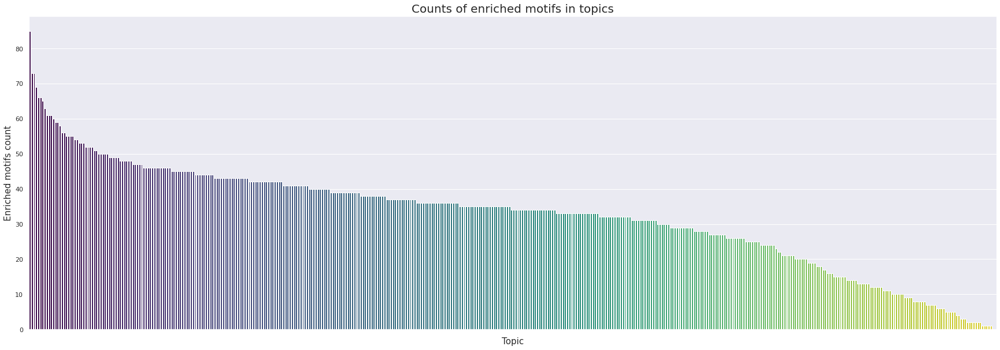

In [53]:
counts = {k: v for k, v in sorted(counts.items(), key=lambda item: item[1], reverse=True)}

keys = list(counts.keys())
vals = [counts[k] for k in keys]

sns.set_theme(style="darkgrid")
plt.figure(figsize=(30,10))
ax = sns.barplot(x=keys, y=vals, palette="viridis")
ax.set(xticklabels=[])
plt.xlabel("Topic", fontsize = 15)
plt.ylabel("Enriched motifs count", fontsize = 15)
plt.title(f"Counts of enriched motifs in topics", fontsize = 20)
plt.show()

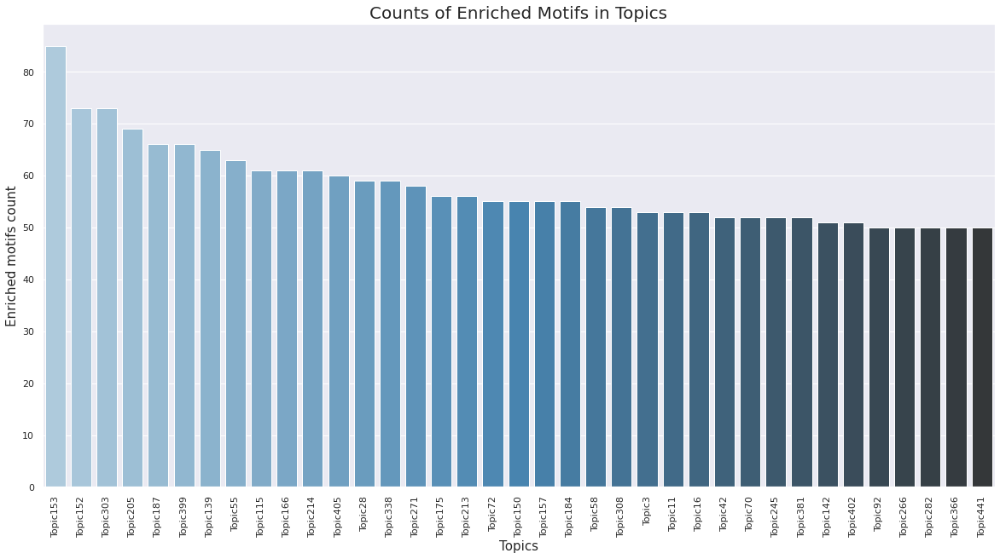

In [57]:
most_common_topics = {k: v for k, v in sorted(counts.items(), key=lambda item: item[1], reverse=True) if v >= 50}
keys = list(most_common_topics.keys())
vals = [most_common_topics[k] for k in keys]

plt.figure(figsize=(20,10))
sns.set_theme(style="darkgrid")
ax = sns.barplot(x=keys, y=vals, palette="Blues_d")
#ax.set(xticklabels=[])
plt.xticks(rotation=90)
plt.xlabel("Topics", fontsize = 15)
plt.ylabel("Enriched motifs count", fontsize = 15)
plt.title("Counts of Enriched Motifs in Topics", fontsize = 20)
plt.show()

In [60]:
len(most_common_topics)

37

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


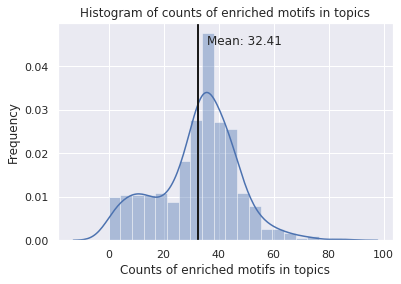

In [59]:

# Python program to get average of a list
def avg(lst):
    return sum(lst) / len(lst)
  
keys = list(counts.keys())
x = [counts[k] for k in keys]
sns.set_theme(style="darkgrid")

sns.distplot(a= x, hist=True, color="b")
plt.xlabel("Counts of enriched motifs in topics")
plt.ylabel("Frequency")
plt.title("Histogram of counts of enriched motifs in topics")
plt.axvline(avg(x), color='k', linestyle='solid', linewidth=2)

min_ylim, max_ylim = plt.ylim()
plt.text(avg(x)*1.1, max_ylim*0.9, 'Mean: {:.2f}'.format(avg(x)))
plt.show()

### Number of overlapping motifs in topics

Text(0.5, 1.0, 'Proportion of shared motifs in topics')

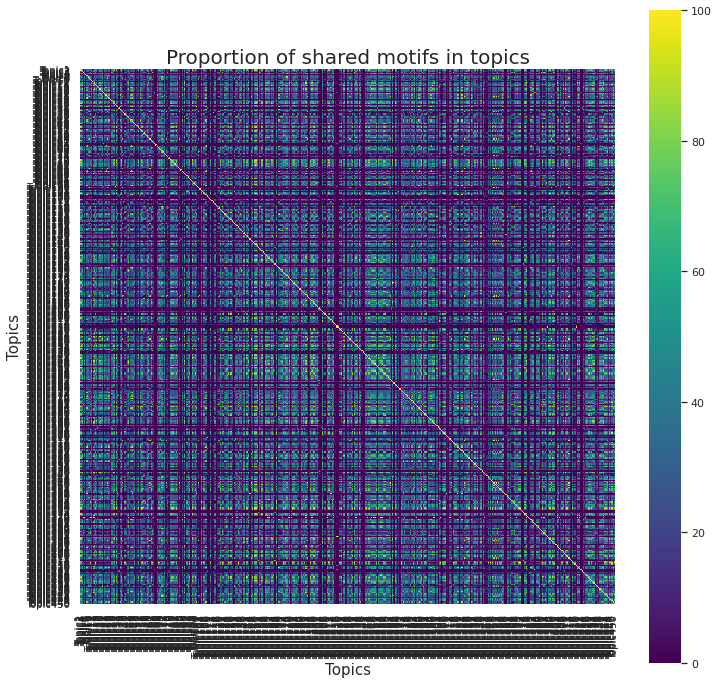

In [5]:
topic_list = [topic for topic in counts.keys()]
res = []
for topic1 in topic_list:
    topic_res = []
    for topic2 in topic_list:
        if topic1 is not topic2 and len(motifs.get(topic1)) != 0:
            topic_res.append(round((len(motifs.get(topic1).intersection(motifs.get(topic2)))/ len(motifs.get(topic1))) * 100))
        elif topic1 == topic2: # the same topic
            topic_res.append(100)
        else: # no enriched motfis
            topic_res.append(0)
    res.append(topic_res)
    
from matplotlib.pyplot import figure
sns.set_theme(style = "darkgrid")
#mask = np.zeros_like(res)
#mask[np.triu_indices_from(mask)] = True
plt.figure(figsize=(12,12))
sns.heatmap(res, cbar=True, cmap='viridis', square=True)
plt.xticks(range(0, len(topic_list)), topic_list, rotation = 90, fontsize = 10)
plt.yticks(range(0, len(topic_list)), topic_list, rotation = 0, fontsize = 10)
plt.ylabel("Topics", fontsize = 15)
plt.xlabel("Topics", fontsize = 15)
plt.title("Proportion of shared motifs in topics", fontsize = 20)

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


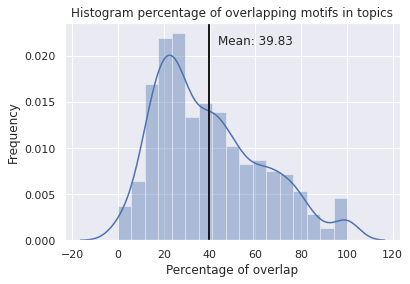

In [89]:
x = [num for sublist in res for num in sublist]
sns.set_theme(style="darkgrid")

sns.distplot(a= res, hist=True, color="b")
plt.xlabel("Percentage of overlap")
plt.ylabel("Frequency")
plt.title("Histogram percentage of overlapping motifs in topics")
plt.axvline(avg(x), color='k', linestyle='solid', linewidth=2)

min_ylim, max_ylim = plt.ylim()
plt.text(avg(x)*1.1, max_ylim*0.9, 'Mean: {:.2f}'.format(avg(x)))
plt.show()

# Motif-centered

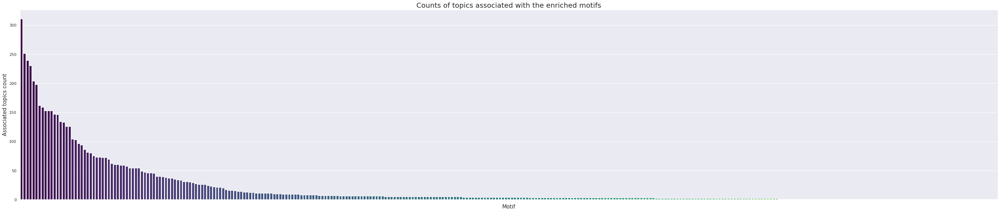

In [98]:
motif_counts = {k: v for k, v in sorted(motif_counts.items(), key=lambda item: item[1], reverse=True)}

keys = list(motif_counts.keys())
vals = [motif_counts[k] for k in keys]

sns.set_theme(style="darkgrid")
plt.figure(figsize=(50,10))
ax = sns.barplot(x=keys, y=vals, palette = "viridis")
ax.set(xticklabels=[])
plt.xlabel("Motif", fontsize = 15)
plt.ylabel("Associated topics count", fontsize = 15)
plt.title(f"Counts of topics associated with the enriched motifs", fontsize = 20)
plt.show()

/staging/leuven/stg_00002/lcb/sfloc/software/miniconda3/envs/python_dinghy/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


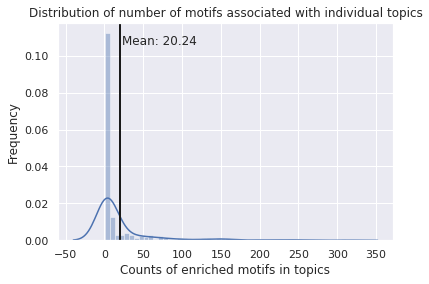

In [99]:
import math
# Python program to get average of a list
def avg(lst):
    return sum(lst) / len(lst)
  
keys = list(motif_counts.keys())
x = [motif_counts[k] for k in keys]

sns.set_theme(style="darkgrid")

sns.distplot(a= x, hist=True, color="b")
plt.xlabel("Counts of enriched motifs in topics")
plt.ylabel("Frequency")
plt.title("Distribution of number of motifs associated with individual topics")
plt.axvline(avg(x), color='k', linestyle='solid', linewidth=2)

min_ylim, max_ylim = plt.ylim()
plt.text(avg(x)*1.1, max_ylim*0.9, 'Mean: {:.2f}'.format(avg(x)))
plt.show()

In [100]:
most_common_motifs = {k: v for k, v in sorted(motif_counts.items(), key=lambda item: item[1], reverse=True) if v >= 100}


In [101]:
most_common_motifs

{'Trl': 311,
 'Adf1': 251,
 'lola': 239,
 'danr': 230,
 'Mad': 204,
 'pnr': 198,
 'crp': 162,
 'FoxP': 159,
 'Dref': 153,
 'BtbVII': 153,
 'z': 153,
 'BEAF-32': 147,
 'kni': 146,
 'sage': 134,
 'jim': 133,
 'ZIPIC': 126,
 'pita': 126,
 'Deaf1': 104,
 'srp': 103}

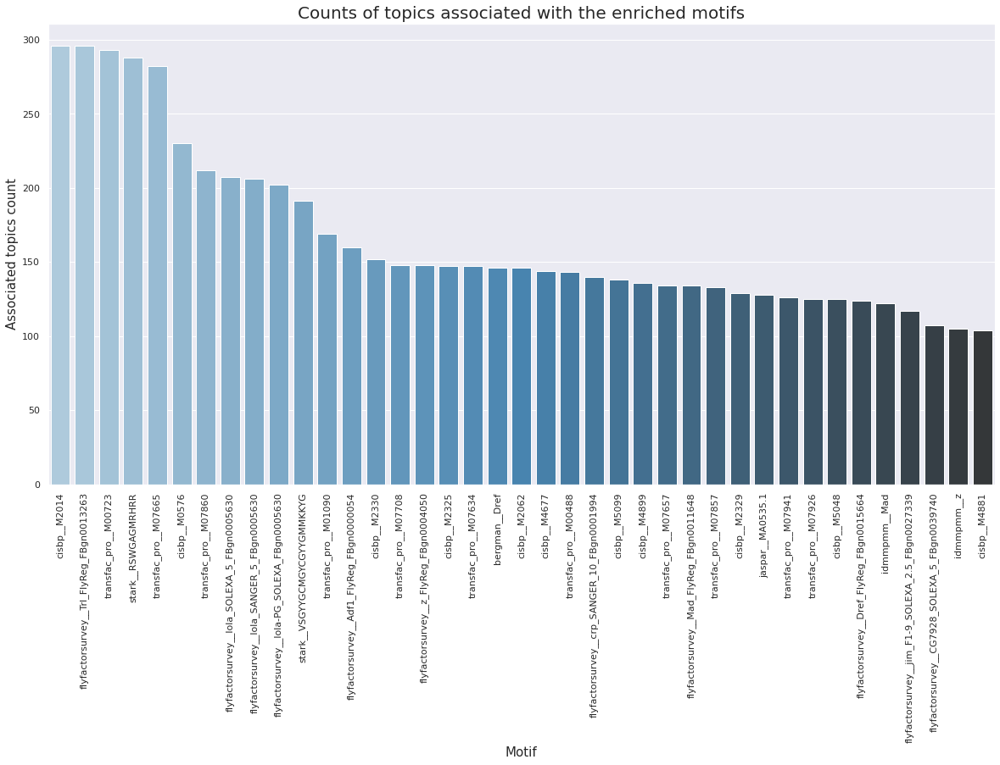

In [32]:
from matplotlib.figure import Figure

keys = list(most_common_motifs.keys())
vals = [most_common_motifs[k] for k in keys]

plt.figure(figsize=(20,10))
sns.set_theme(style="darkgrid")
ax = sns.barplot(x=keys, y=vals, palette="Blues_d")
#ax.set(xticklabels=[])
plt.xticks(rotation=90)
plt.xlabel("Motif", fontsize = 15)
plt.ylabel("Associated topics count", fontsize = 15)
plt.title("", fontsize = 20)
plt.show()

In [88]:
motifs_in_topics = [] # binary - is the motif in a topic
for motif in unique_motifs:
    count_list = []
    for topic in motifs.keys():
        if motif in motifs.get(topic):
            count_list.append(1)
        else:
            count_list.append(0)
    motifs_in_topics.append(count_list)

In [ ]:
from matplotlib.pyplot import figure
sns.set_theme(style = "darkgrid")
figure(figsize=(20, 10), dpi=80)
sns.heatmap(motifs_in_topics, cbar=False, cmap='viridis', yticklabels=False)
#plt.xticks([topic for topic in motifs.keys()], rotation = 90)
plt.ylabel("Unique Motifs")
plt.xlabel("Topics")
plt.title("Presence of motifs in topics")

In [63]:
round((len(motifs.get('Topic5').intersection(motifs.get('Topic4')))/ len(motifs.get('Topic5'))) * 100)

3

In [61]:
(10/100)*100

10.0

In [19]:
# Save
import pickle
with open('/staging/leuven/stg_00002/lcb/ijanic/projects/FCA_atac/tfEnrichment/cistarget_dict.pkl', 'wb') as f:
    pickle.dump(cistarget_dict, f)

# Topics and atlas

In [41]:
res.columns

Index(['pnr', 'BEAF-32', 'Trl', 'Dref', 'kni', 'Adf1', 'z', 'Mad', 'lola',
       'Deaf1', 'ovo', 'CG12236', 'GATAd', 'srp', 'TFAM', 'GATAe', 'grn',
       'lov', 'dati', 'FoxP', 'sqz', 'hb', 'crol', 'rn', 'jim', 'l(3)neo38',
       'CG12219', 'klu', 'danr', 'pita', 'crp', 'ZIPIC', 'Sox15', 'D', 'sage',
       'Cf2', 'BtbVII', 'Tbp', 'byn', 'grh', 'CG4360', 'Aef1', 'onecut', 'NfI',
       'Mef2', 'Jra', 'kay', 'Jra, kay', 'toy', 'ey', 'sim', 'tgo', 'gl',
       'CG4956', 'ttk', 'run', 'Bgb', 'lz', 'bs', 'slp1', 'CHES-1-like', 'sv',
       'Atf3', 'Atf6', 'CrebA', 'zld', 'seq', 'ara', 'br', 'vis', 'hth',
       'achi', 'tj'],
      dtype='object')

In [45]:
res["grn"].sort_values(ascending=False)

Topics
Topic60     13.673071
Topic74     13.549605
Topic313    13.424023
Topic37     13.347191
Topic85     12.846155
              ...    
Topic168     0.000000
Topic169     0.000000
Topic174     0.000000
Topic175     0.000000
Topic450     0.000000
Name: grn, Length: 277, dtype: float64

In [5]:
def vis_topic_probablity(atlas_obj, topic):
    atlas_obj.cell_data[topic] = atlas_obj.selected_model.cell_topic_harmony.loc[topic]
    sns.set_theme(style="darkgrid")
    plot_metadata(atlas_obj,
                  reduction_name='harmony_tSNE',
                  variables=[topic], 
                  target='cell',
                  text_size=15,
                  dot_size=0.5,
                  figsize=(18,15),
                  show_label=False,
                  save=None)

In [4]:
def highlight_cells_with_val(atlas_obj, variable, val, size_of_selected_cells = 1):
    atlas_obj.cell_data[variable] = atlas_obj.cell_data[variable].replace(np.nan, "no annotation")
    if type(atlas_obj.cell_data[variable]) == pd.DataFrame :
        col  = atlas_obj.cell_data[variable].iloc[:,-1]
    else:
        col = atlas_obj.cell_data[variable]
        
    colors_map = {row : "indigo" if row == val else "lightgray" for row in tqdm(col)}
    
    embeddings = atlas_obj.projections.get('cell').get('harmony_tSNE')
    embeddings[variable] = col
    sns.set_theme(style="darkgrid")
    group = embeddings.loc[:, variable]
    fig, ax = plt.subplots(figsize=(10, 10))
    for g in np.unique(group):
        ix = group[group == g].index
        if colors_map.get(g) != "lightgray":
            ax.scatter(embeddings['tSNE_1'][ix], embeddings['tSNE_2'][ix], c = colors_map[g], label = g, s = size_of_selected_cells, alpha=0.5)
        else:
            ax.scatter(embeddings['tSNE_1'][ix], embeddings['tSNE_2'][ix], c = colors_map[g], label = g, s = 1, alpha=0.5)

    plt.title(val, fontsize=20)
    plt.show()
   

# Load Atlas with annotation 

In [3]:
with open("/staging/leuven/stg_00002/lcb/ijanic/projects/subclustering/atlas_with_brain_annots.pkl", "rb") as f:
    atlas_obj = pickle.load(f)  

/tmp/ipykernel_27810/3269867985.py:2: DeprecationWarning: Please use `csr_matrix` from the `scipy.sparse` namespace, the `scipy.sparse.csr` namespace is deprecated.
  atlas_obj = pickle.load(f)


In [7]:
bridge_file = pd.read_csv("/staging/leuven/stg_00002/lcb/sfloc/projects/FCA_atac_v4/bridge/obj.query.bridged.tsv", sep = "\t")
atlas_obj.cell_data = atlas_obj.cell_data.merge(bridge_file, left_index = True, right_index = True, how = "left")

In [8]:
atlas_obj.cell_data["predicted.l2"].unique()

array(['63_unannotated', 'adult tracheal cell', 'epithelial cell',
       'enterocyte of posterior adult midgut epithelium',
       'adult oenocyte', 'muscle cell', 'cell body glial cell',
       'adult fat body', '35_unannotated',
       'adult heart ventral longitudinal muscle', '40_unannotated',
       '30_unannotated', 'enterocyte-like', 'follicle cell',
       '19_unannotated', 'peripheral glial cell', 'adult salivary gland',
       '44_unannotated', 'hemocyte',
       'btl-GAL4 positive female cell, likely to be ovary cell, sim+',
       'seminal vesicle', '37_unannotated', '6_unannotated',
       'indirect flight muscle', 'crop', 'female reproductive system',
       '46_unannotated', '73_unannotated', 'male accessory gland',
       'adult midgut*', 'adult reticular neuropil associated glial cell',
       '82_unannotated', 'labral sense organ mechanosensory neuron',
       'adult midgut enterocyte', '21_unannotated', 'posterior midgut*',
       'gustatory receptor neuron of the l

In [12]:
matched_annot = pd.read_csv("/data/leuven/338/vsc33893/jupyterhub_notebooks/thesis/atlas_integration_seurat/brain_runs/matched_annot_JJ.csv")
brain_annots_set = {annot for annot in matched_annot["FCA annot"]}
brain_annots_set

{' T neuron T2',
 'Johnston organ neuron',
 'T neuron T2a',
 'T neuron T3',
 'T neuron T4/T5a-b',
 'T neuron T4/T5c-d',
 'adult brain cell body glial cell',
 'adult brain perineurial glial cell',
 'adult lamina epithelial/marginal glial cell',
 'adult optic chiasma glial cell',
 'adult reticular neuropil associated glial cell',
 "alpha'/beta' Kenyon cell",
 'alpha/beta Kenyon cell',
 'auditory sensory neuron',
 'centrifugal neuron C2',
 'columnar neuron T1',
 'cone cell',
 'distal medullary amacrine neuron Dm11',
 'distal medullary amacrine neuron Dm3',
 'distal medullary amacrine neuron Dm8',
 'dopaminergic PAM neuron',
 'ensheathing glial cell',
 'epithelial cell',
 'gamma Kenyon cell',
 'hemocyte',
 'lamina monopolar neuron L1',
 'lamina monopolar neuron L2',
 'lamina monopolar neuron L3',
 'lamina monopolar neuron L4',
 'lamina wide-field 2 neuron',
 'medullary intrinsic neuron Mi1',
 'medullary intrinsic neuron Mi9',
 'olfactory receptor neuron',
 'optic-lobe-associated cortex gli

In [29]:
new = []
brain_types = set()
for i in tqdm(range(0,len(atlas_obj.cell_data["predicted.l2"]))):
    if atlas_obj.cell_data["predicted.l2"][i] in brain_annots_set:
        new.append("is_brain")
        brain_types.add(atlas_obj.cell_data["predicted.l2"][i])
    else:
        new.append("not_brain")

atlas_obj.cell_data["is_brain"] = new
atlas_obj.cell_data["is_brain"]

100%|████████████████████████████████████████████████████████| 594940/594940 [00:02<00:00, 239109.30it/s]


ACGTATCCAATTGCGAATATTACCTAGATC___FDM__ec5baa__20210511__20210601_hydrop-atac_flybody_11    not_brain
GCAATGATTGTTCGCTTGGTTGCGACAATG___FDM__ec5baa__20210511__20210601_hydrop-atac_flybody_11    not_brain
GTGCCAATAAATCCGAAGTCACTGGTAATA___FDM__ec5baa__20210511__20210601_hydrop-atac_flybody_11    not_brain
CGTTATCGTGCTATGTGCTGGACTTCTCTC___FDM__ec5baa__20210511__20210601_hydrop-atac_flybody_11    not_brain
CTTGGATGCATGAGGTAGTCGTAATCGGTG___FDM__ec5baa__20210511__20210601_hydrop-atac_flybody_11    not_brain
                                                                                             ...    
GGCTTAAGTAGGATTT-1___FDM__185acd__20220207_MO_cDNA_ovaries_sample8                         not_brain
GTACTGGTCCAATTAG-1___FDM__185acd__20220207_MO_cDNA_ovaries_sample8                         not_brain
GCTCTGGCATTAGCGC-1___FDM__185acd__20220207_MO_cDNA_ovaries_sample8                         not_brain
TAGCCTGAGGTGAAAT-1___FDM__185acd__20220207_MO_cDNA_ovaries_sample8                         

In [20]:
brain_annots_set.remove('hemocyte')
brain_annots_set.remove('pericerebral adult fat mass')
brain_annots_set.remove('skeletal muscle of head')
brain_annots_set.remove('pigment cell')

In [31]:
brain_types

{'Johnston organ neuron',
 'T neuron T3',
 'T neuron T4/T5a-b',
 'adult brain cell body glial cell',
 'adult brain perineurial glial cell',
 'adult lamina epithelial/marginal glial cell',
 'adult optic chiasma glial cell',
 'adult reticular neuropil associated glial cell',
 'alpha/beta Kenyon cell',
 'auditory sensory neuron',
 'columnar neuron T1',
 'cone cell',
 'ensheathing glial cell',
 'gamma Kenyon cell',
 'lamina monopolar neuron L1',
 'lamina monopolar neuron L2',
 'lamina monopolar neuron L3',
 'lamina monopolar neuron L4',
 'medullary intrinsic neuron Mi1',
 'olfactory receptor neuron',
 'optic-lobe-associated cortex glial cell',
 'outer photoreceptor cell',
 'photoreceptor cell R8',
 'subperineurial glial cell',
 'transmedullary neuron Tm1'}

# GRN 

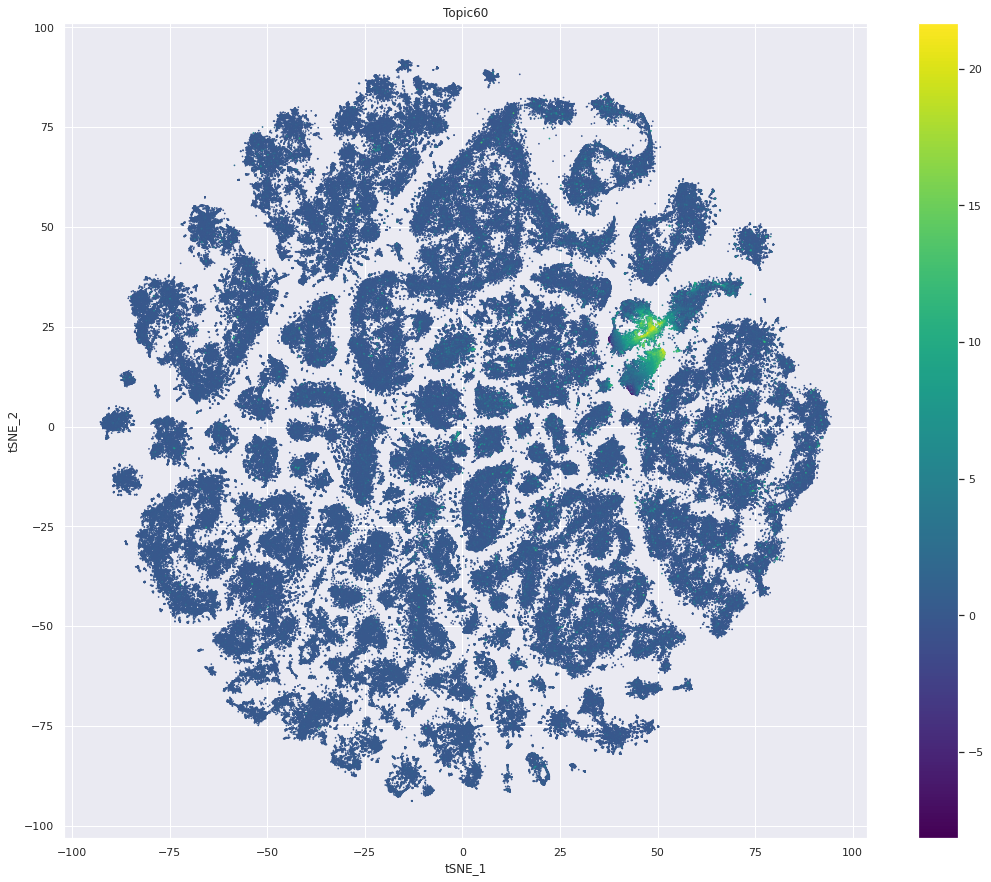

In [75]:
vis_topic_probablity(atlas_obj, "Topic60")

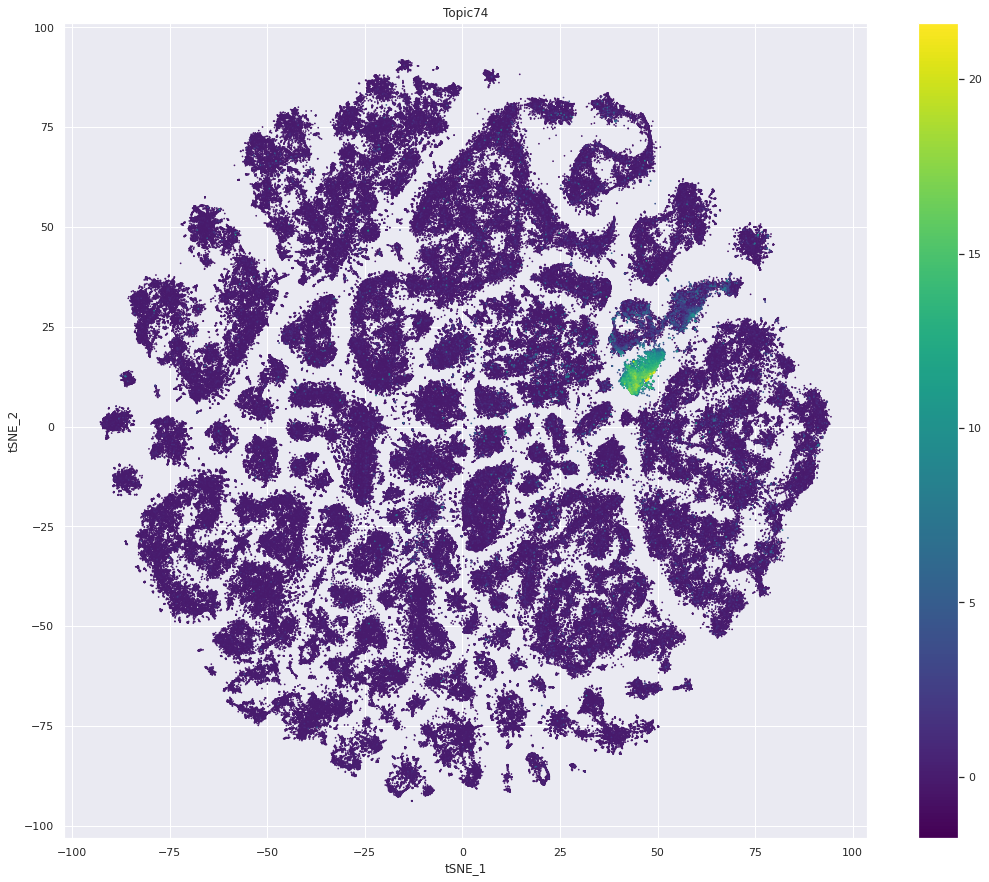

In [79]:
vis_topic_probablity(atlas_obj, "Topic74")

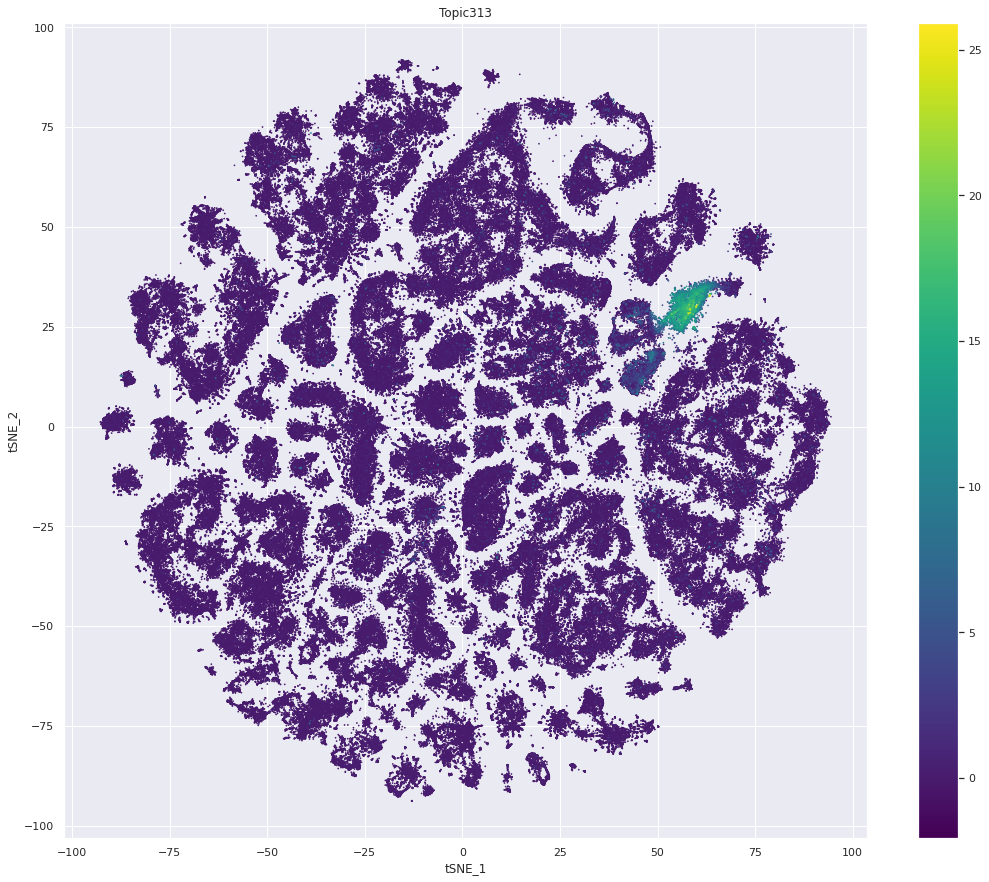

In [80]:
vis_topic_probablity(atlas_obj, "Topic313")

100%|██████████| 594940/594940 [00:00<00:00, 3194750.89it/s]


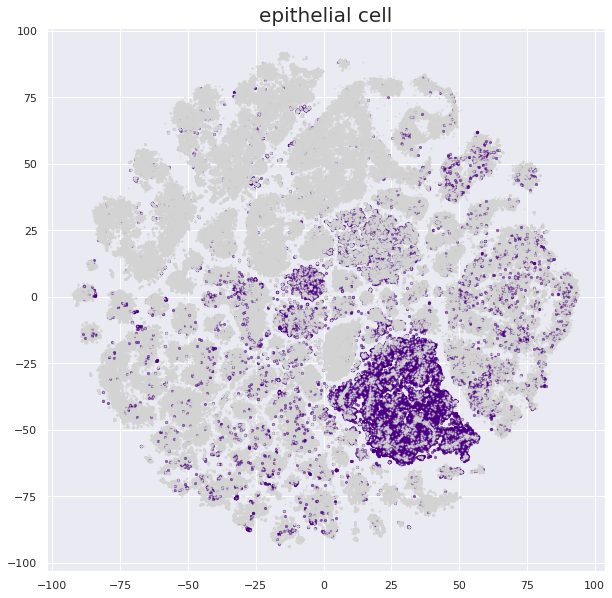

In [97]:
highlight_cells_with_val(atlas_obj, "predicted.l2", "epithelial cell", 5)

100%|██████████| 594940/594940 [00:00<00:00, 3103750.11it/s]


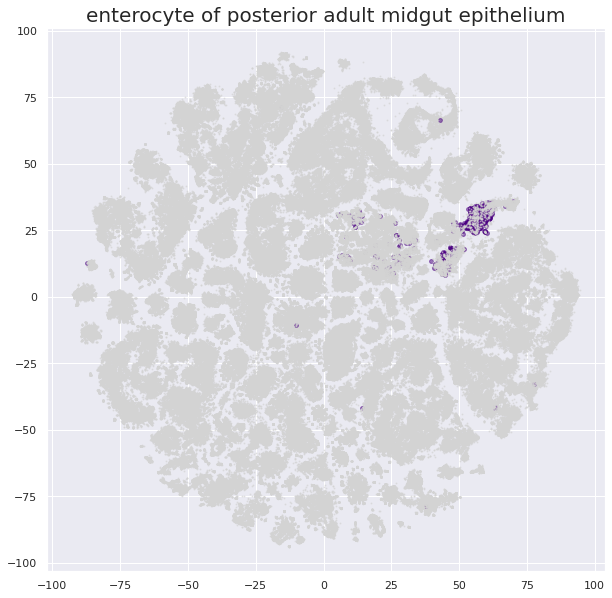

In [100]:
highlight_cells_with_val(atlas_obj, "predicted.l2", "enterocyte of posterior adult midgut epithelium", 15)

100%|███████████████████████████████████████████████████████| 594940/594940 [00:00<00:00, 3199231.81it/s]


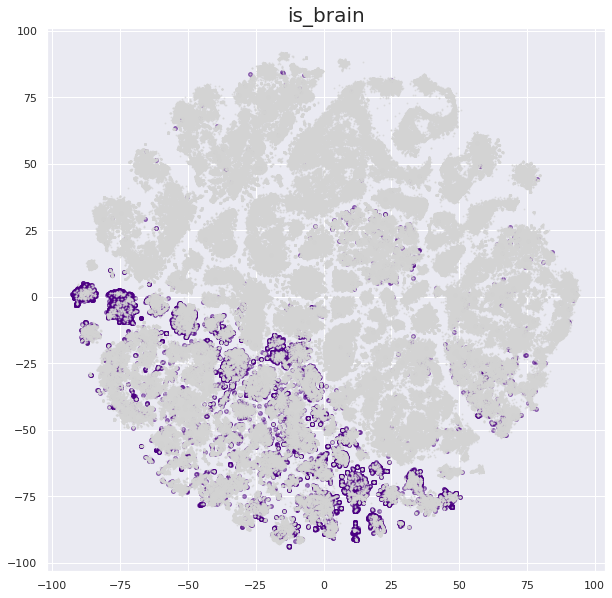

In [32]:
highlight_cells_with_val(atlas_obj, "is_brain", "is_brain", 15)

100%|██████████| 594940/594940 [00:00<00:00, 1472110.17it/s]


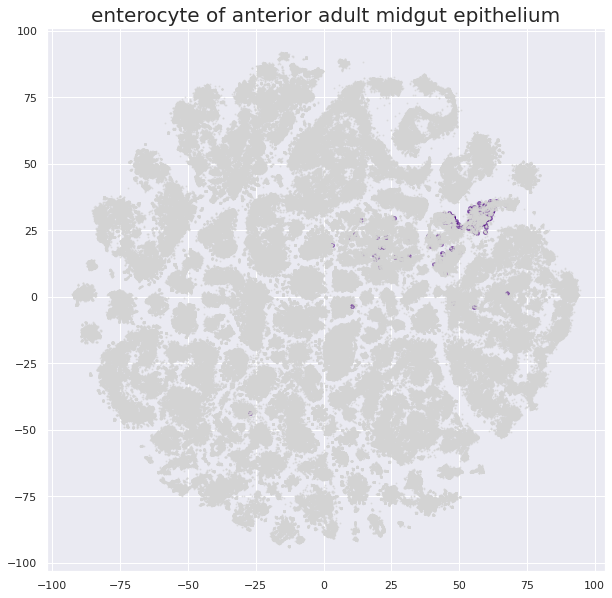

In [101]:
highlight_cells_with_val(atlas_obj, "predicted.l2", "enterocyte of anterior adult midgut epithelium", 15)

# onecut

In [102]:
res["onecut"].sort_values(ascending=False)

Topics
Topic57     6.794291
Topic123    6.604248
Topic280    6.548886
Topic99     6.510933
Topic2      0.000000
              ...   
Topic160    0.000000
Topic162    0.000000
Topic163    0.000000
Topic164    0.000000
Topic450    0.000000
Name: onecut, Length: 277, dtype: float64

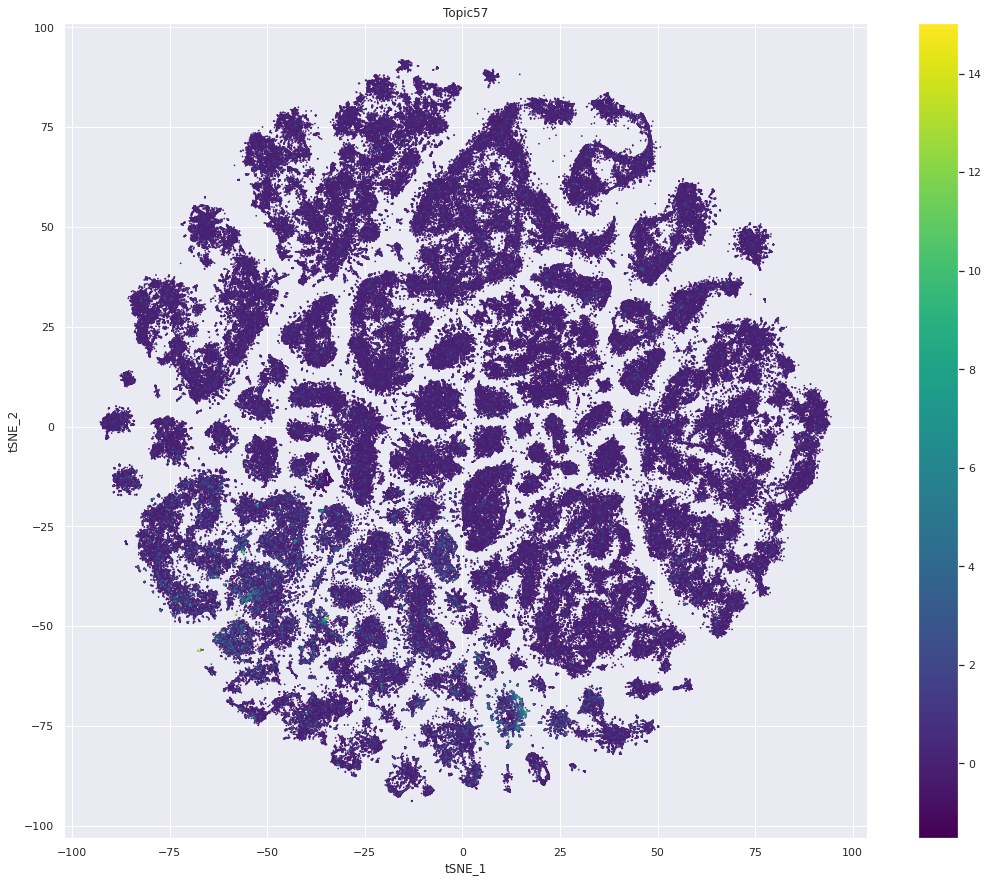

In [57]:
vis_topic_probablity(atlas_obj, "Topic57")

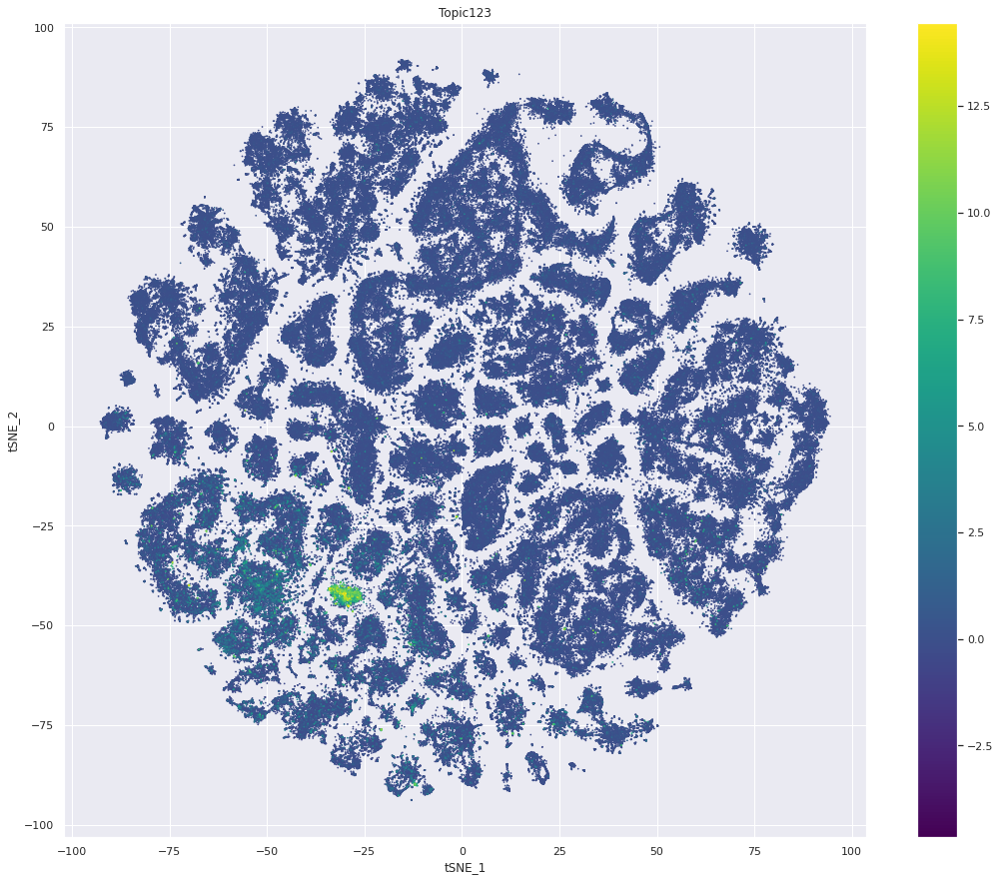

In [104]:
vis_topic_probablity(atlas_obj, "Topic123")

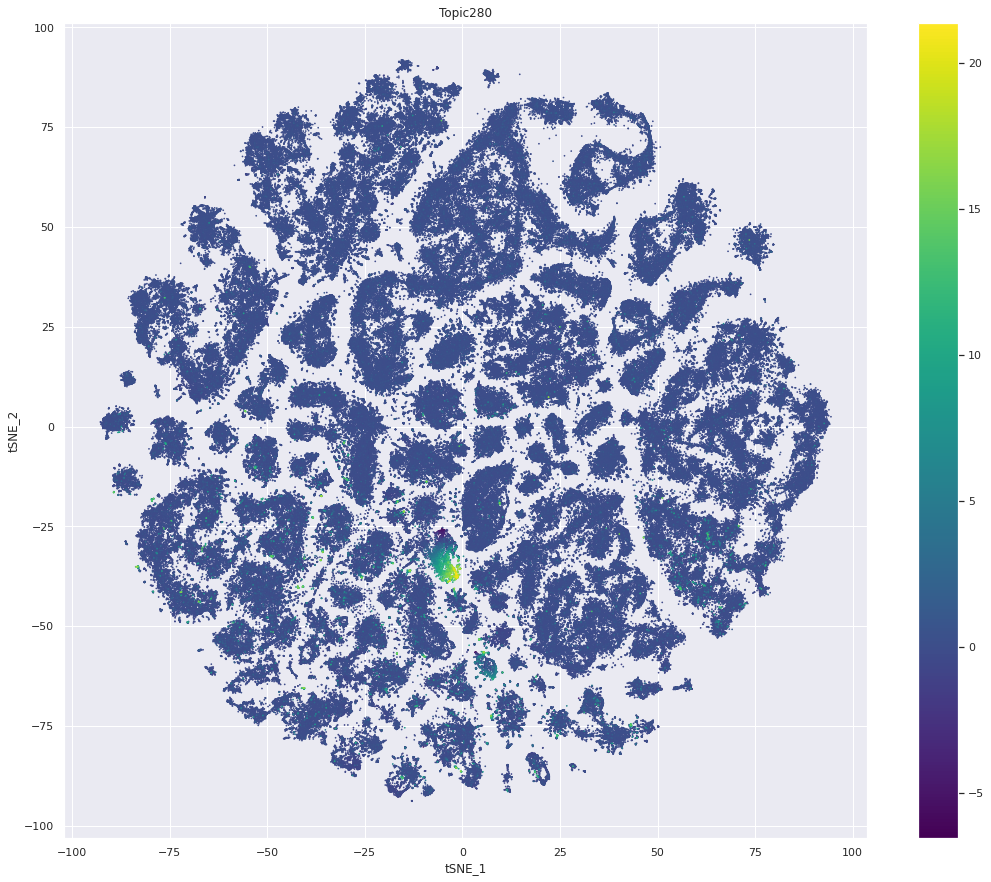

In [105]:
vis_topic_probablity(atlas_obj, "Topic280")

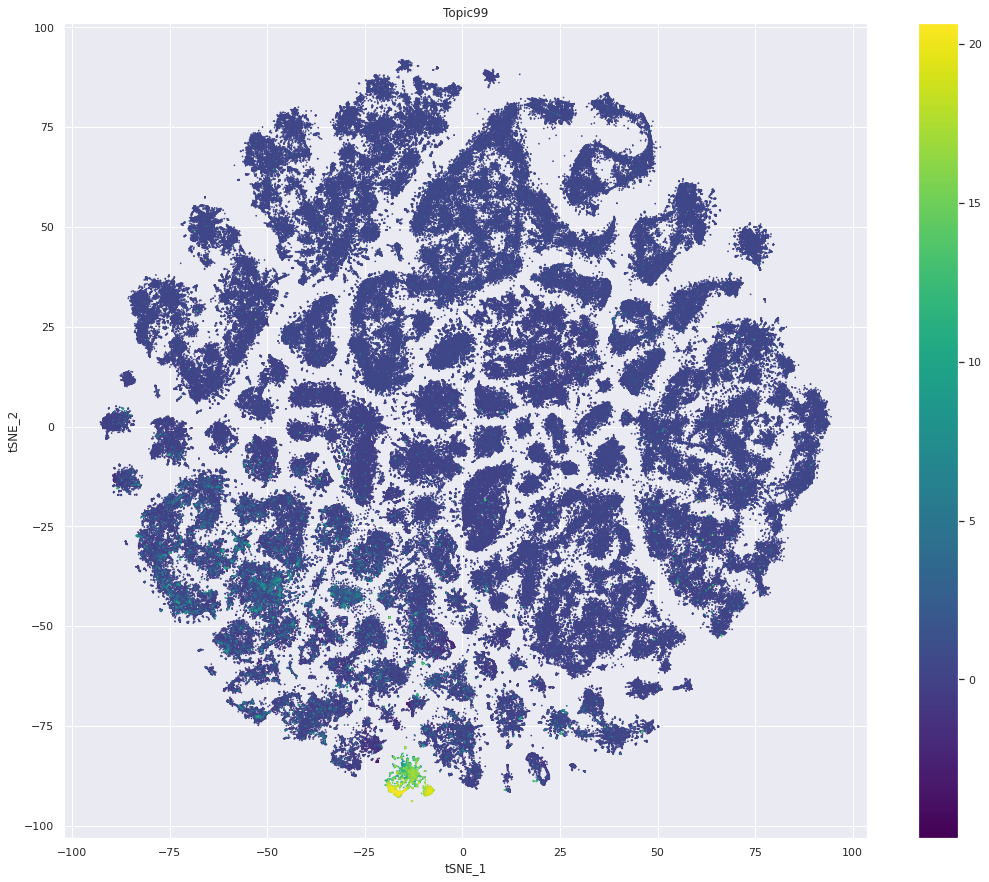

In [106]:
vis_topic_probablity(atlas_obj, "Topic99")

# srp, pnr

In [107]:
res["srp"].sort_values(ascending=False)

Topics
Topic60     11.946388
Topic74     11.762493
Topic313    11.607842
Topic37     11.470382
Topic85     11.317760
              ...    
Topic168     0.000000
Topic169     0.000000
Topic174     0.000000
Topic179     0.000000
Topic450     0.000000
Name: srp, Length: 277, dtype: float64

In [113]:
res["pnr"].sort_values(ascending=False)

Topics
Topic166    18.485367
Topic292    17.216103
Topic122    16.991343
Topic306    15.842768
Topic398    15.532549
              ...    
Topic254     0.000000
Topic255     0.000000
Topic46      0.000000
Topic45      0.000000
Topic229     0.000000
Name: pnr, Length: 277, dtype: float64

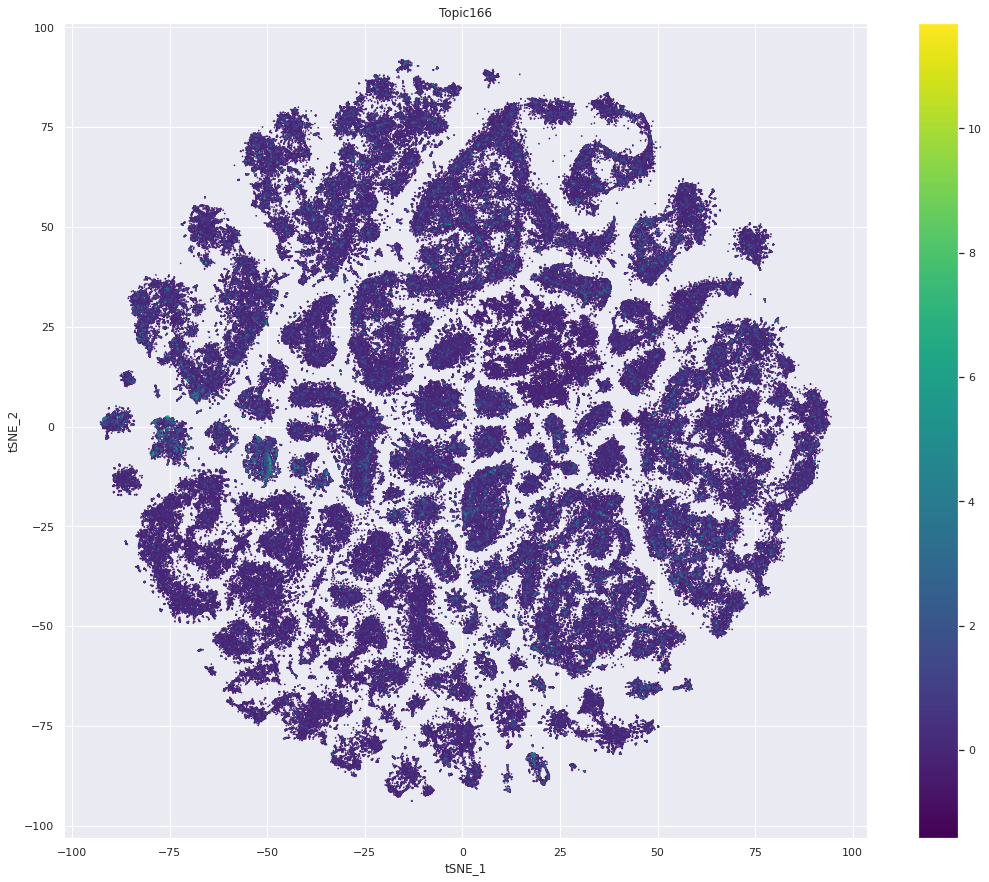

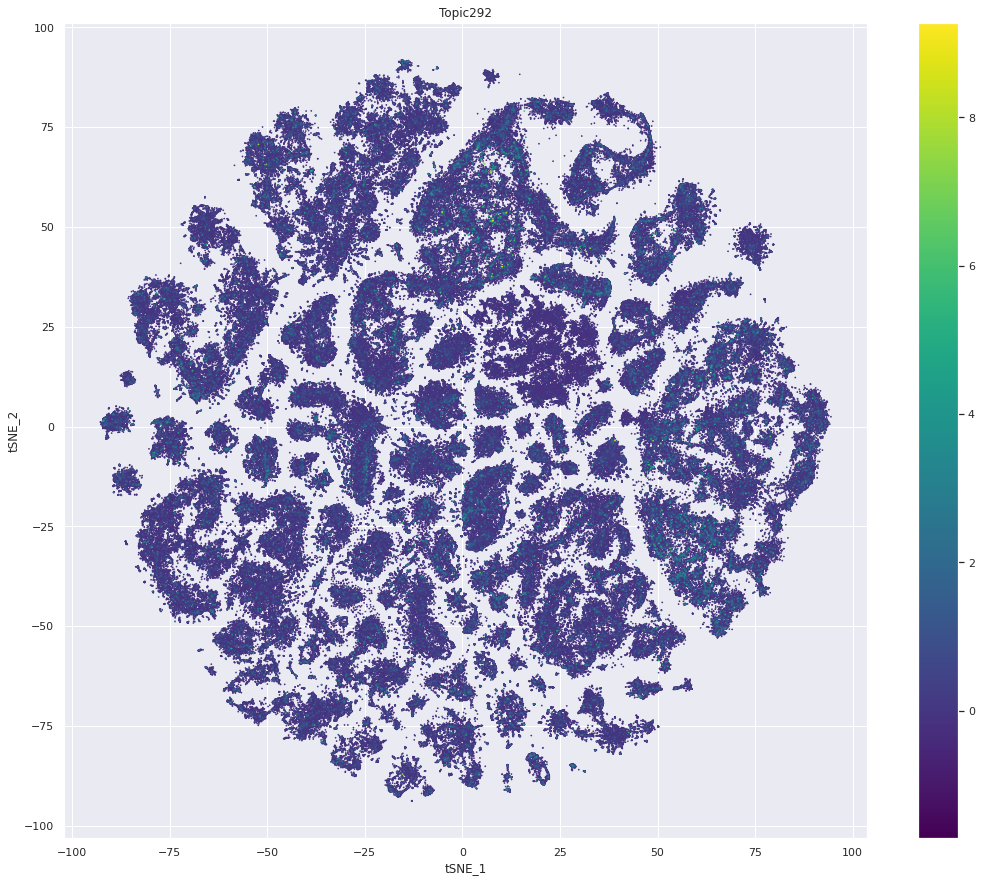

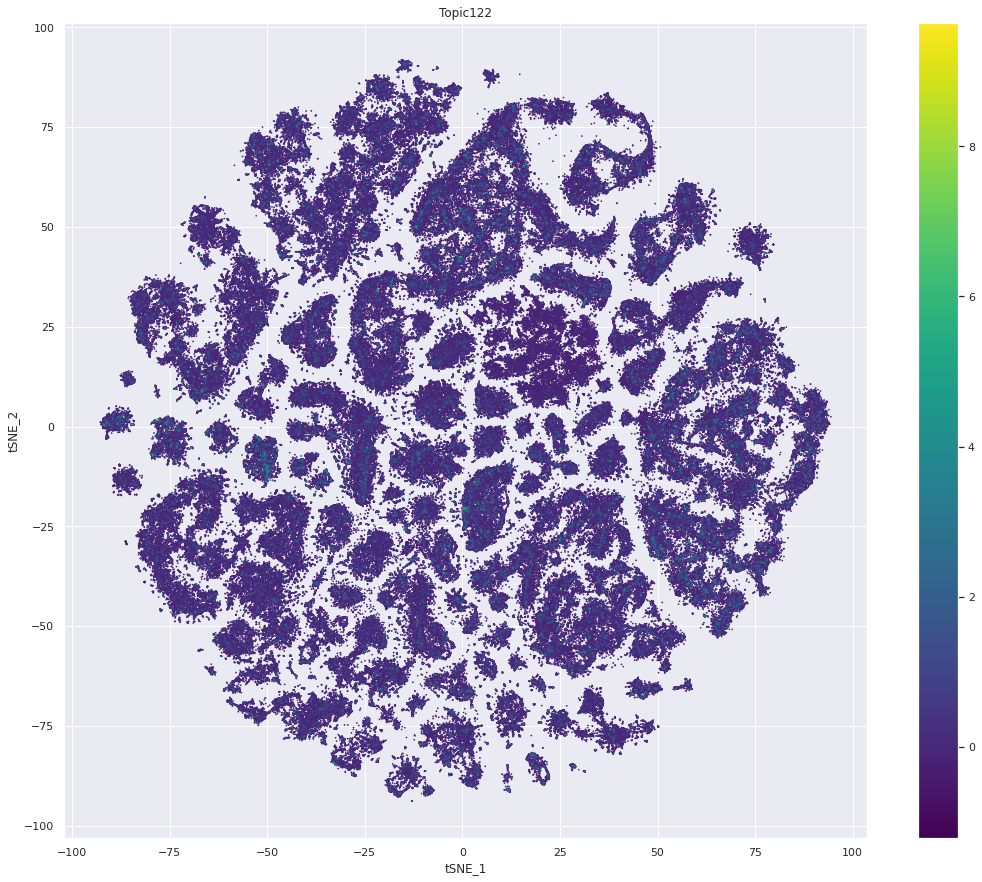

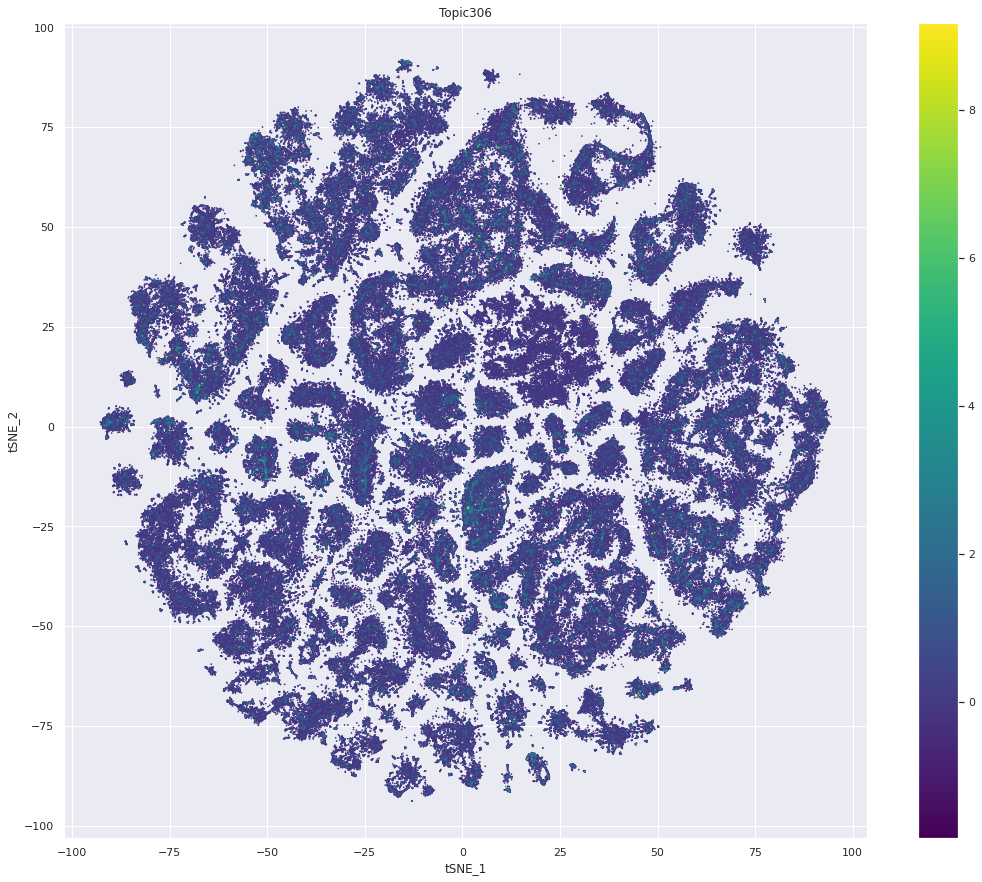

In [114]:
vis_topic_probablity(atlas_obj, "Topic166")
vis_topic_probablity(atlas_obj, "Topic292")
vis_topic_probablity(atlas_obj, "Topic122")
vis_topic_probablity(atlas_obj, "Topic306")

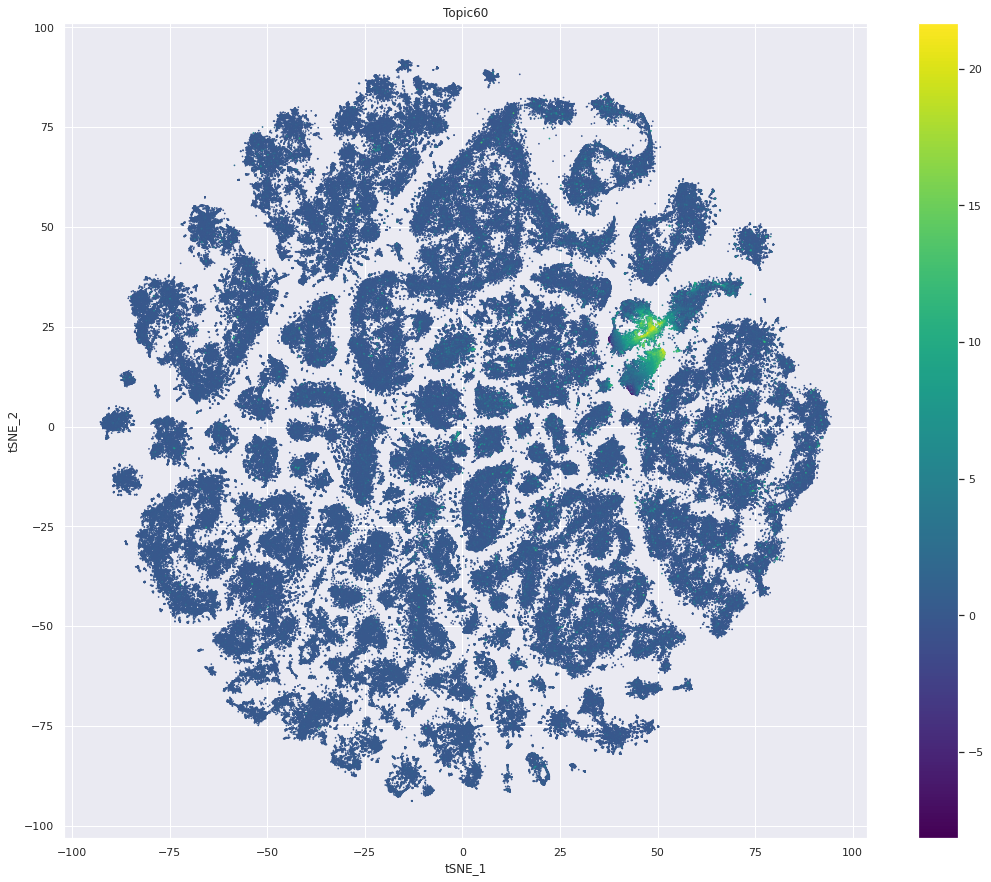

In [108]:
vis_topic_probablity(atlas_obj, "Topic60")

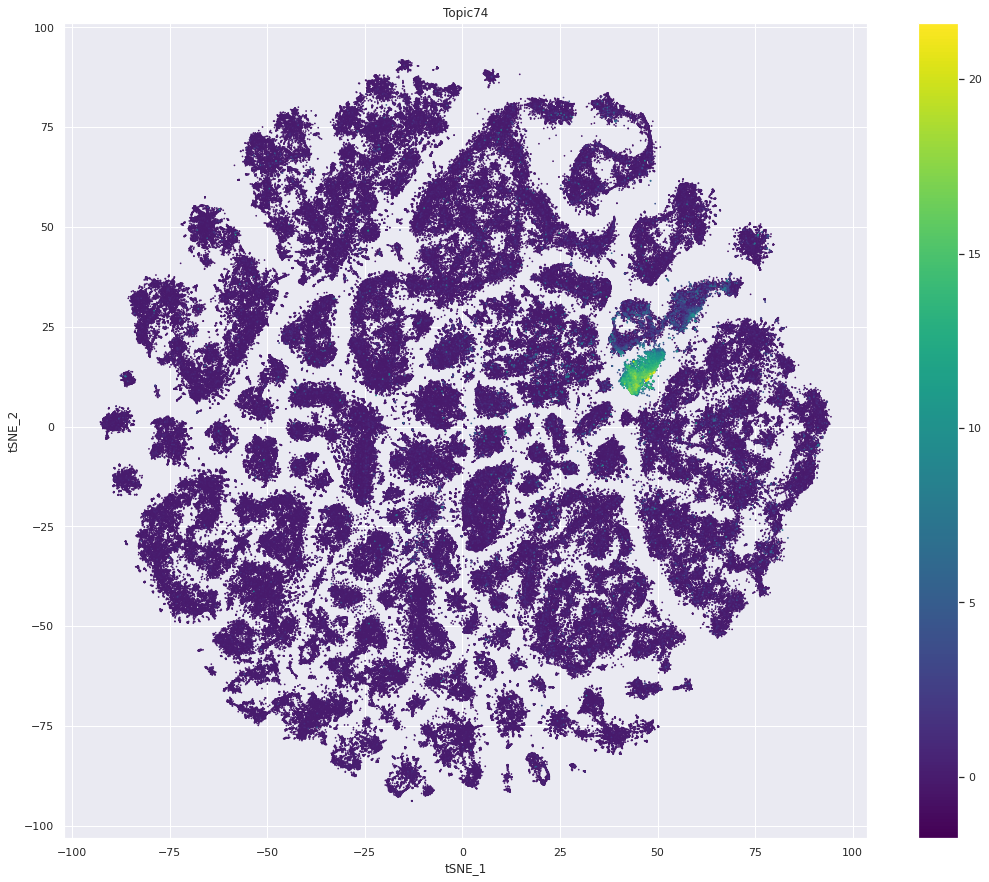

In [109]:
vis_topic_probablity(atlas_obj, "Topic74")

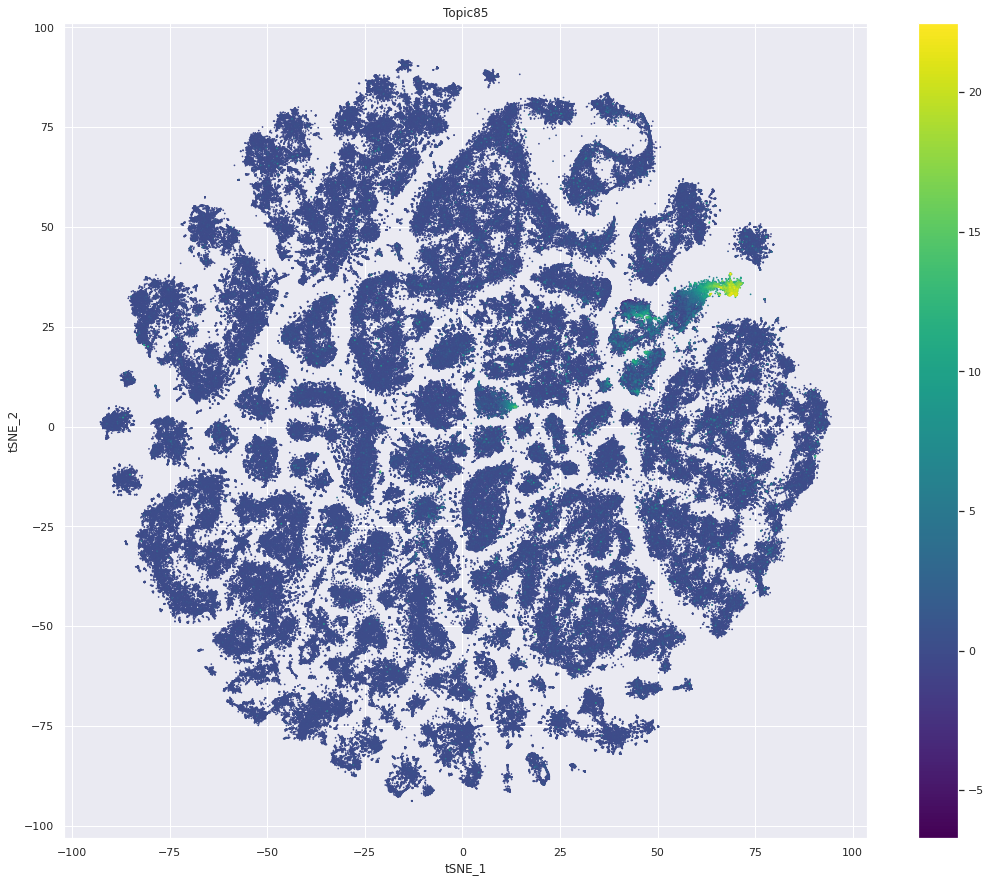

In [110]:
vis_topic_probablity(atlas_obj, "Topic85")

100%|██████████| 594940/594940 [00:00<00:00, 2991122.88it/s]


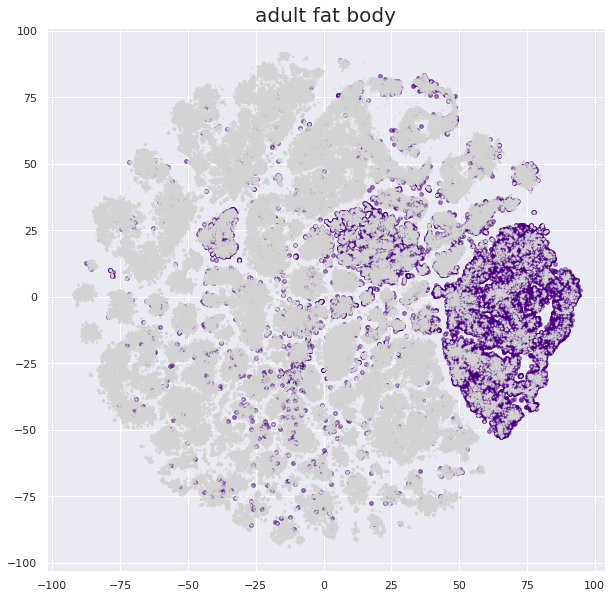

100%|██████████| 594940/594940 [00:00<00:00, 2955011.22it/s]


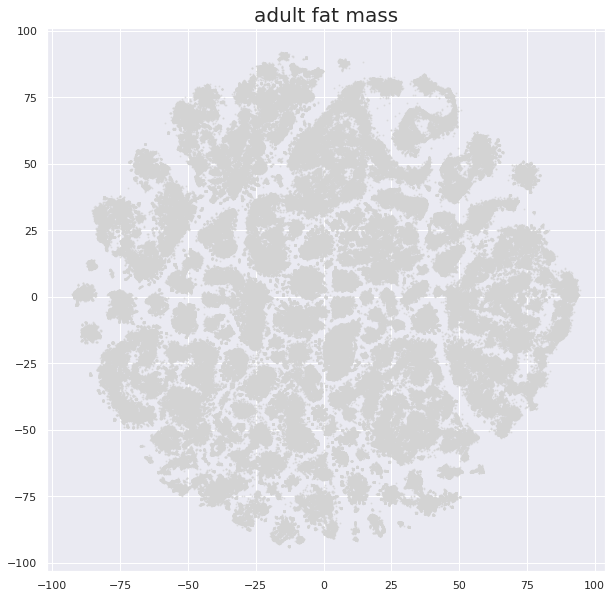

In [112]:
highlight_cells_with_val(atlas_obj, "predicted.l2", "adult fat body", 15)
highlight_cells_with_val(atlas_obj, "predicted.l2", "adult fat mass", 15)

# Mef2

In [117]:
res["Mef2"].sort_values(ascending=False)

Topics
Topic295    7.571159
Topic393    6.615630
Topic259    6.552776
Topic97     6.221180
Topic199    6.018636
              ...   
Topic158    0.000000
Topic159    0.000000
Topic160    0.000000
Topic162    0.000000
Topic450    0.000000
Name: Mef2, Length: 277, dtype: float64

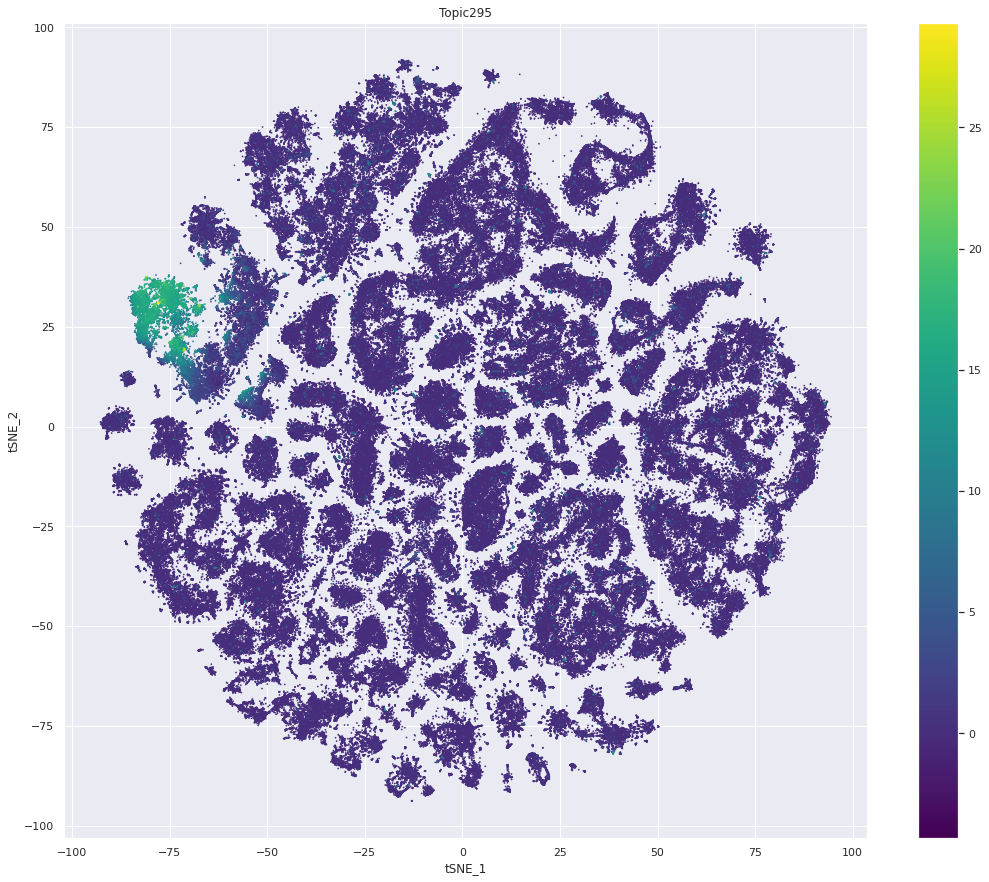

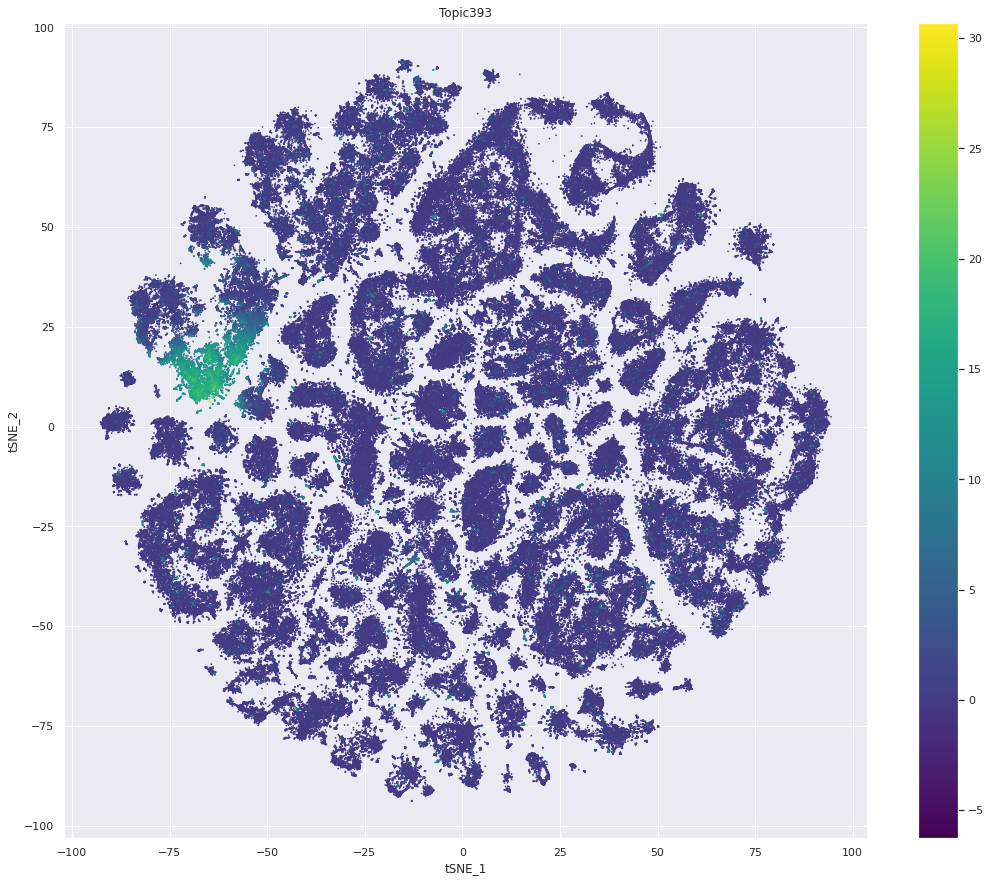

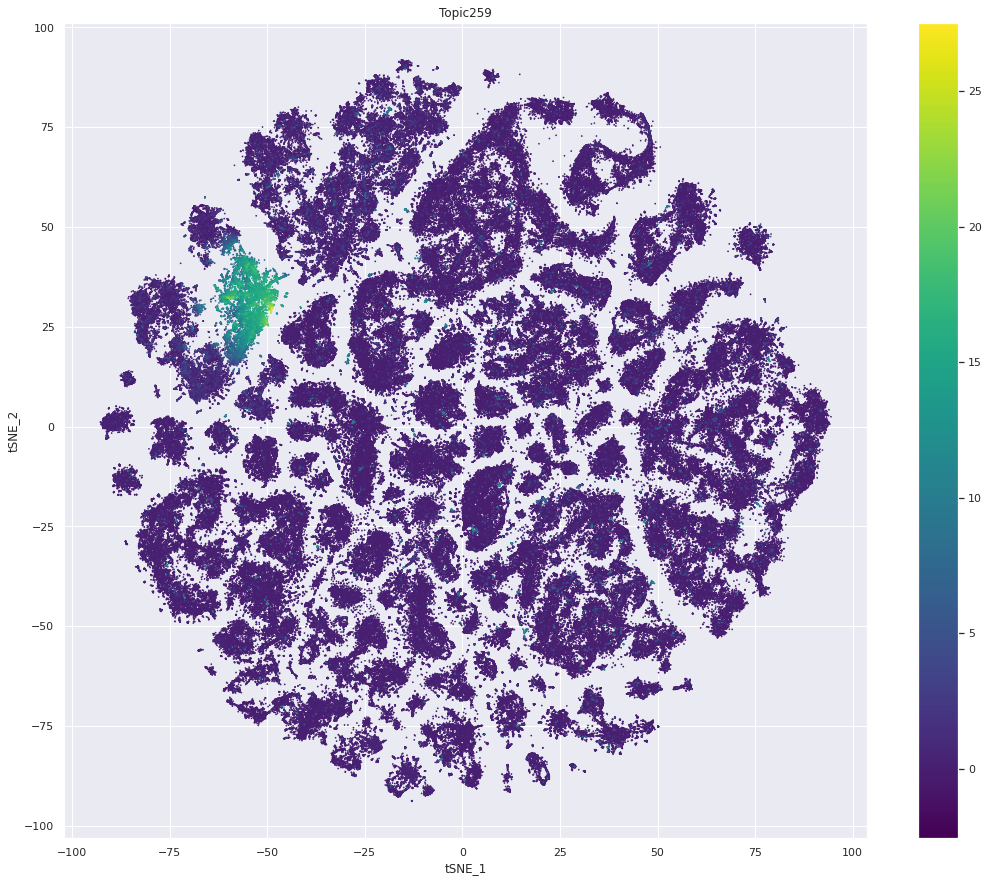

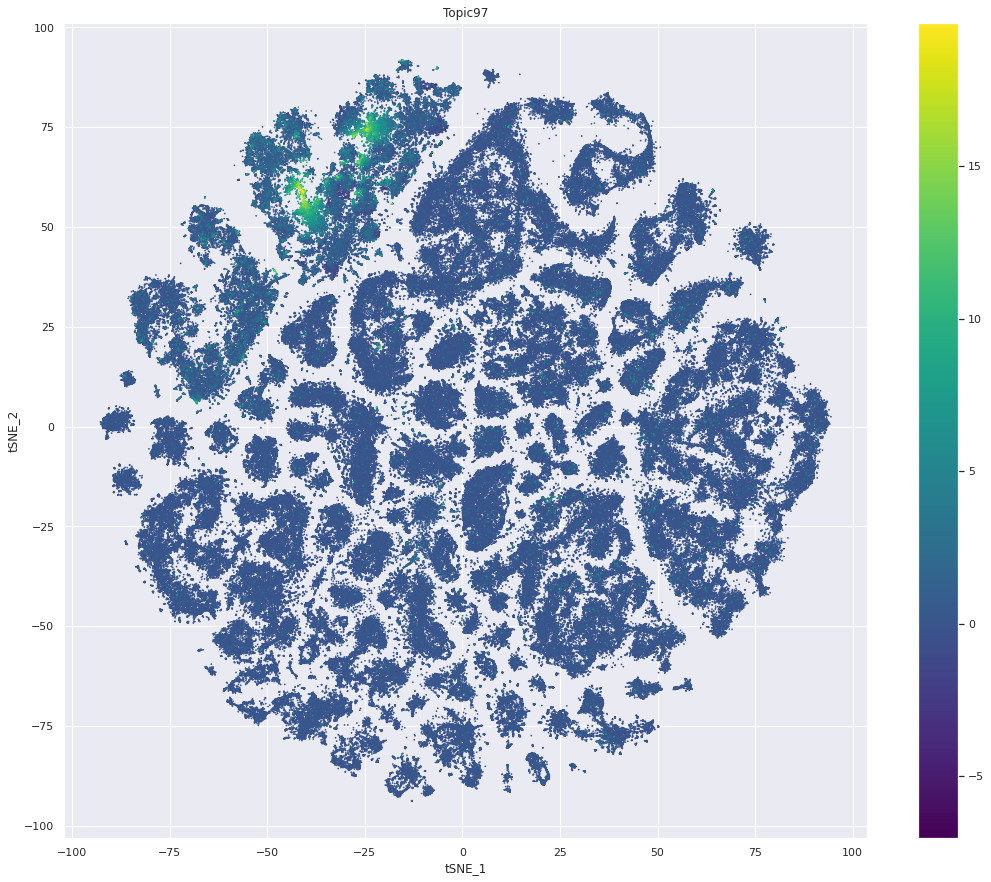

In [118]:
vis_topic_probablity(atlas_obj, "Topic393")
vis_topic_probablity(atlas_obj, "Topic259")
vis_topic_probablity(atlas_obj, "Topic97")

In [ ]:
'muscle cell', 'adult heart ventral longitudinal muscle', 'indirect flight muscle',
'ovarian sheath muscle', 'cardiomyocyte, working adult heart muscle (non-ostia)'

100%|███████████████████████████████████████████████████████| 594940/594940 [00:00<00:00, 3207662.35it/s]


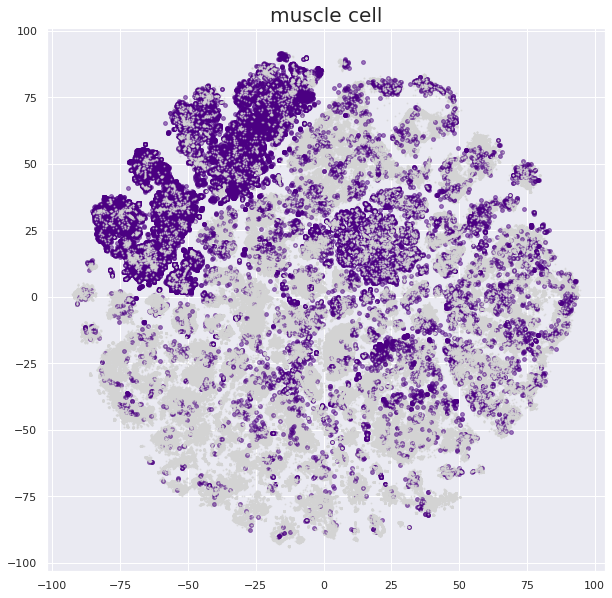

100%|███████████████████████████████████████████████████████| 594940/594940 [00:00<00:00, 3295682.84it/s]


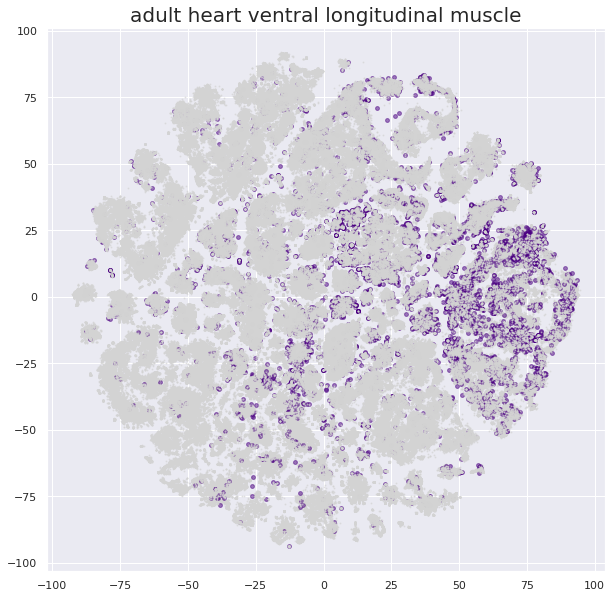

100%|███████████████████████████████████████████████████████| 594940/594940 [00:00<00:00, 3223720.09it/s]


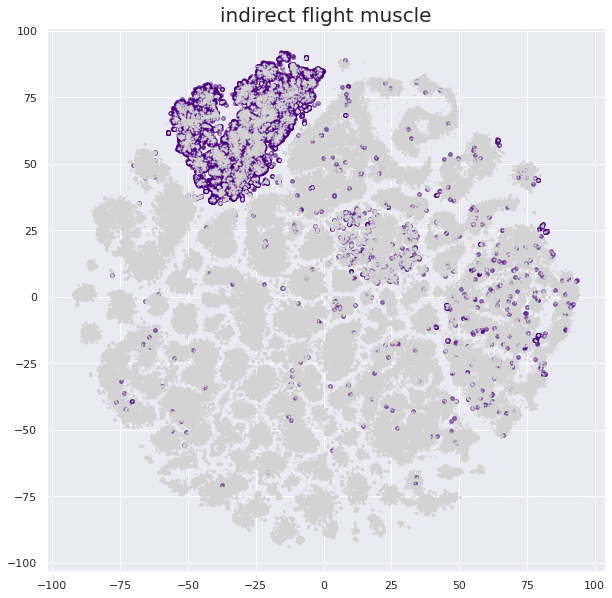

100%|███████████████████████████████████████████████████████| 594940/594940 [00:00<00:00, 3243523.27it/s]


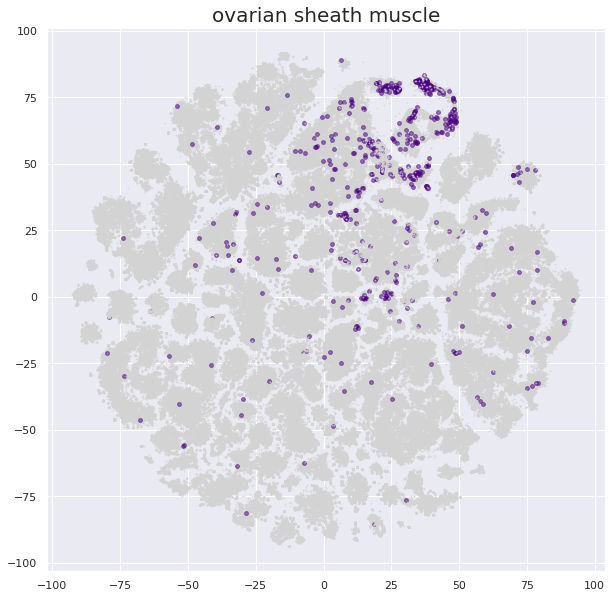

100%|███████████████████████████████████████████████████████| 594940/594940 [00:00<00:00, 3227447.62it/s]


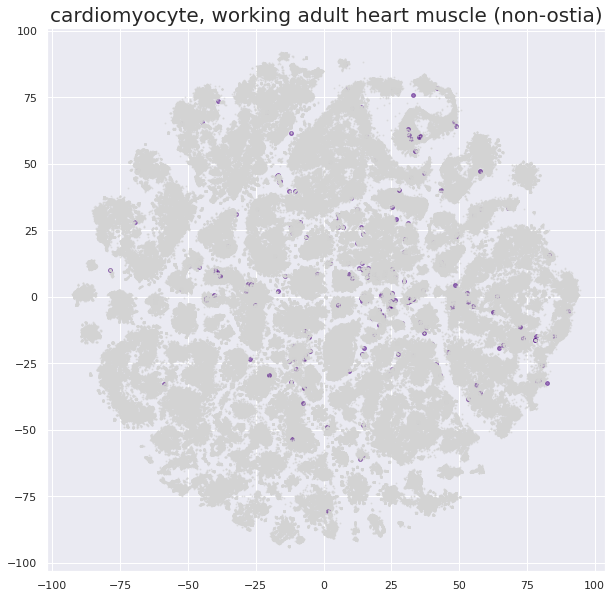

In [138]:
highlight_cells_with_val(atlas_obj, "predicted.l2", "muscle cell", 15)
highlight_cells_with_val(atlas_obj, "predicted.l2", 'adult heart ventral longitudinal muscle', 15)
highlight_cells_with_val(atlas_obj, "predicted.l2",'indirect flight muscle', 15)
highlight_cells_with_val(atlas_obj, "predicted.l2", 'ovarian sheath muscle', 15)
highlight_cells_with_val(atlas_obj, "predicted.l2",'cardiomyocyte, working adult heart muscle (non-ostia)', 15)

# Selcting top regions

In [9]:
import statistics

def get_regions(cell_type, atlas_obj, DARs_dict):
    cell_type_subset = atlas_obj.cell_data.loc[atlas_obj.cell_data["predicted.l2"] == cell_type, :]
    cells = cell_type_subset.index
    clusters = cell_type_subset["pycisTopic_leiden_10_2"].value_counts()
    sel_clusters = clusters.iloc[0:5].index
    cells = [cell for cell in cells if atlas_obj.cell_data.loc[cell, "pycisTopic_leiden_10_2"] in sel_clusters]
    rest_cells = atlas_obj.cell_data.drop(cells, inplace=False, axis=0).index  # all rest of the cells
    
    
    # color the cells used
    atlas_obj.cell_data.loc[cells, cell_type] = "included"
    highlight_cells_with_val(atlas_obj, cell_type, "included", 15)

    largest_diff = 0
    topic = 0
    
    print("Finding the most specific topic to a cell type")
    # getting topic regions
    for i in tqdm(range(0, len(atlas_obj.selected_model.cell_topic_harmony))):
        probs = atlas_obj.selected_model.cell_topic_harmony.iloc[i,:]
        probs_cells = probs.filter(items=cells, axis=0)
        probs_rest = probs.filter(items=rest_cells, axis=0)
        avg_prob_cells = statistics.median(probs_cells)
        avg_prob_res = statistics.median(probs_rest)
        if (avg_prob_cells - avg_prob_res) > largest_diff:
            largest_diff = (avg_prob_cells - avg_prob_res)
            topic = i+1
            
    topics = atlas_obj.selected_model.region_topic.loc[:, "Topic"+str(topic)]
        
    print(topic)
    
    print("Creating final list of regions")
    # getting DAR regions
    res = pd.DataFrame()
    for cluster in tqdm(sel_clusters):
        dars_index = DARs_dict.get(cluster).index
        dars_set = set(dars_index)
        topic_set = set(topics.index)
        # get intersection
        intersecting_regions = dars_set.intersection(topic_set)
        df = DARs_dict.get(cluster)
        regions = df.loc[intersecting_regions,"Log2FC"].sort_values(ascending=False).index[0:11]
        res = pd.concat([df.loc[regions, :], res])

    res = df.loc[:,"Log2FC"].sort_values(ascending=False).index[0:11]
    return res

In [10]:
infile = open('/staging/leuven/stg_00002/lcb/sfloc/projects/FCA_atac_v4/dars_css/marker_regions_leiden10_2.pkl', 'rb')
DARs_dict = pickle.load(infile)
infile.close()

100%|██████████████████████████████████████████████████████████████████████████████████████████| 594940/594940 [00:00<00:00, 2627335.54it/s]


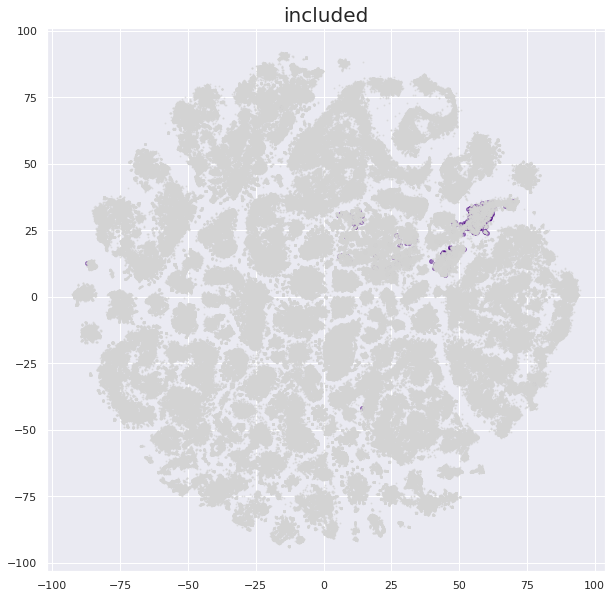

Finding the most specific topic to a cell type


  2%|█▌                                                                                                     | 7/450 [00:11<11:56,  1.62s/it]


KeyboardInterrupt: 

In [18]:
#regions_muscle = get_regions("indirect flight muscle", atlas_obj, DARs_dict)
regions_epithelium = get_regions("enterocyte of posterior adult midgut epithelium", atlas_obj, DARs_dict)

100%|██████████████████████████████████████████████████████████████████████████████████████████| 594940/594940 [00:00<00:00, 2656316.04it/s]


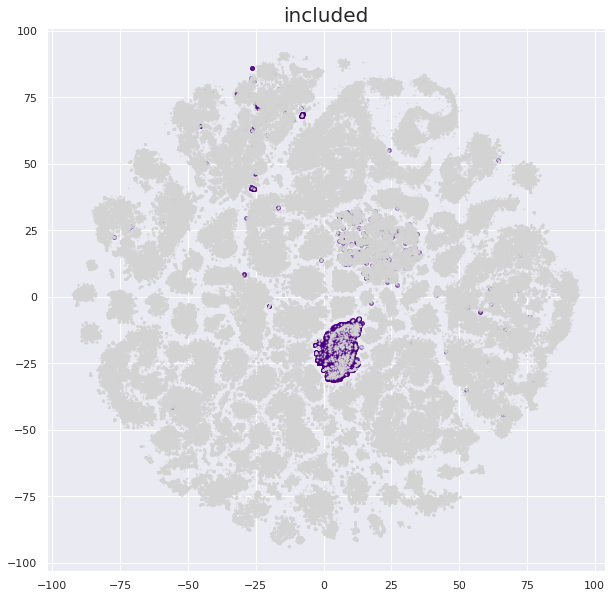

Finding the most specific topic to a cell type


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████| 450/450 [08:04<00:00,  1.08s/it]


20
Creating final list of regions


  0%|                                                                                                                 | 0/5 [00:00<?, ?it/s]/tmp/ipykernel_27810/2137677266.py:45: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  regions = df.loc[intersecting_regions,"Log2FC"].sort_values(ascending=False).index[0:11]
 20%|█████████████████████                                                                                    | 1/5 [00:00<00:01,  2.66it/s]/tmp/ipykernel_27810/2137677266.py:45: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  regions = df.loc[intersecting_regions,"Log2FC"].sort_values(ascending=False).index[0:11]
/tmp/ipykernel_27810/2137677266.py:45: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  regions = df.loc[intersecting_regions,"Log2FC"].sort_values(ascending=False).ind

In [12]:
regions_epithelium = get_regions("hemocyte", atlas_obj, DARs_dict)

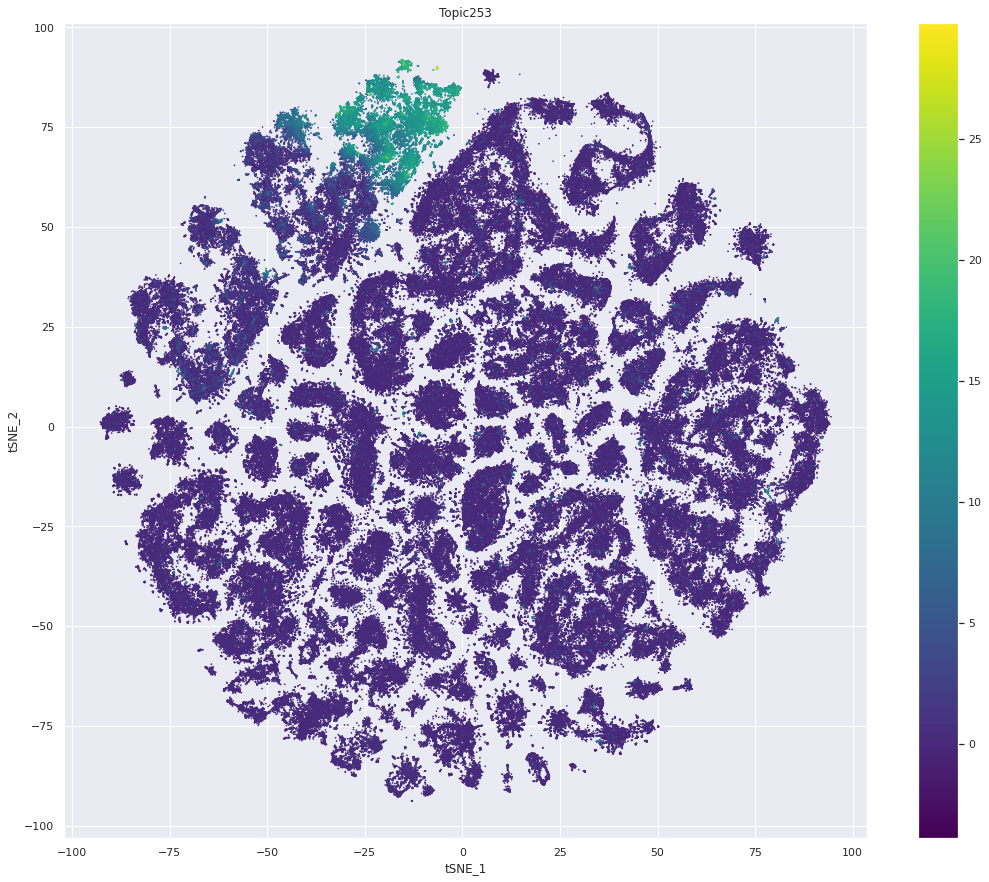

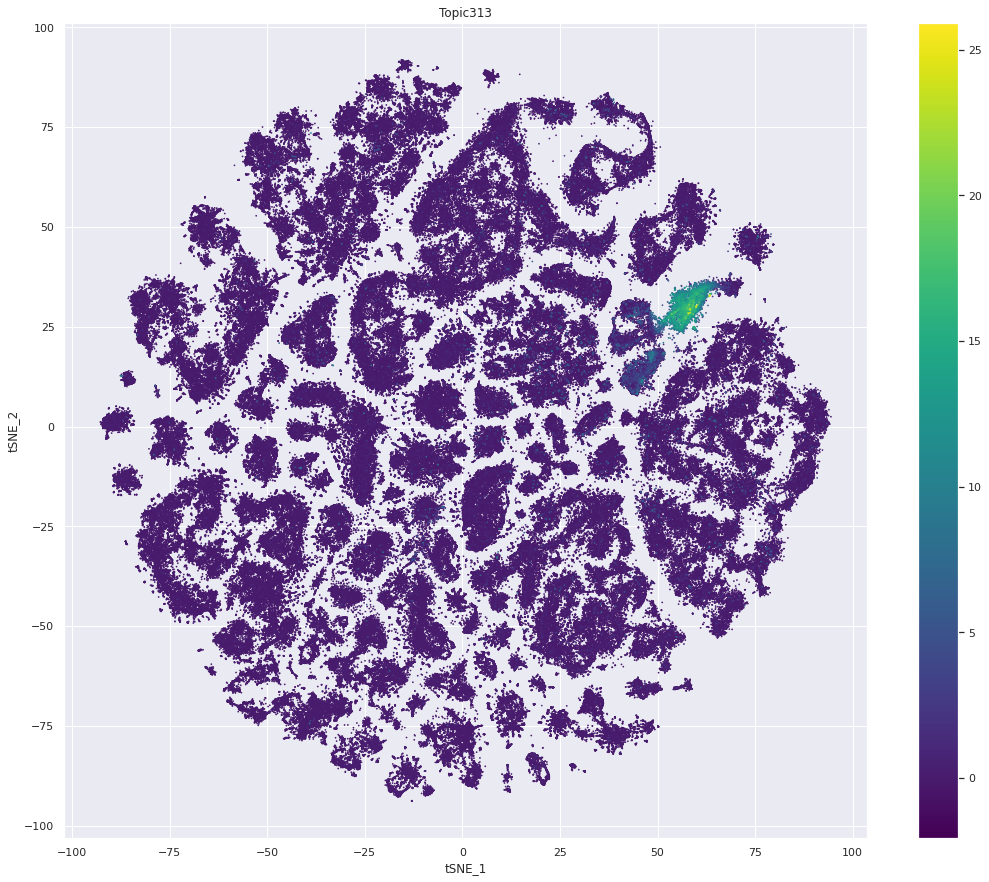

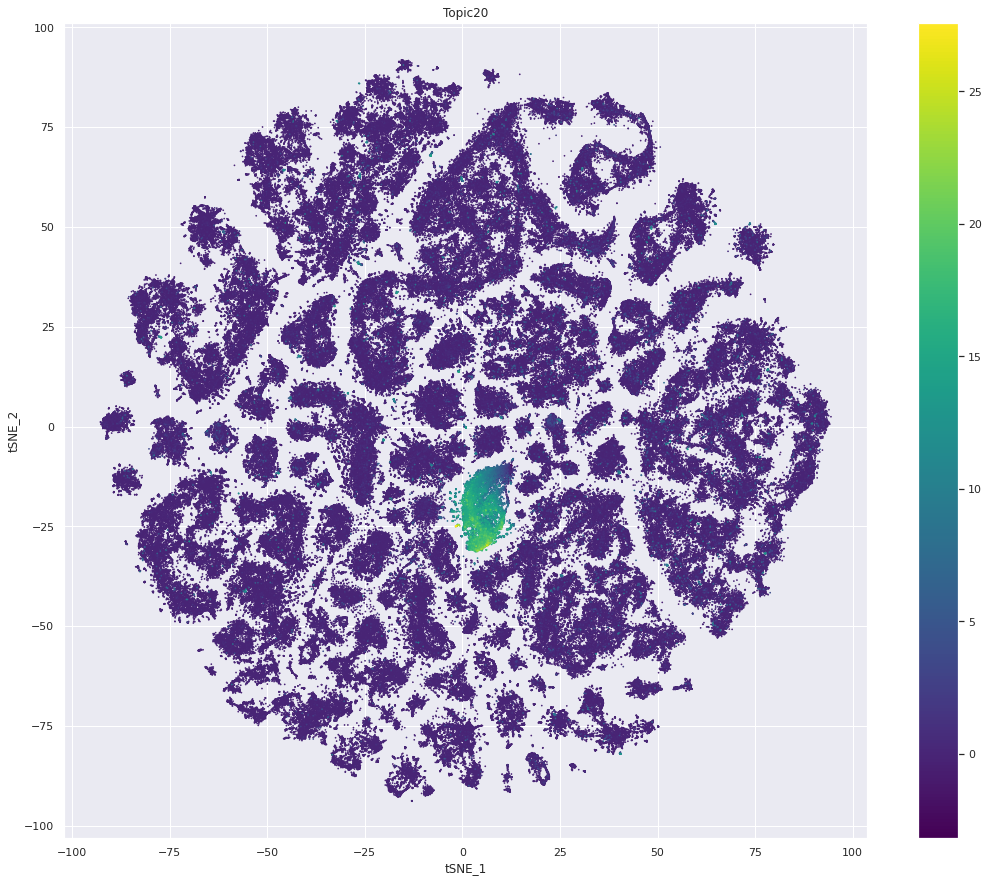

In [14]:
vis_topic_probablity(atlas_obj, "Topic253")
vis_topic_probablity(atlas_obj, "Topic313")
vis_topic_probablity(atlas_obj, "Topic20")

In [ ]:
regions_glia = get_regions("ensheathing glial cell", atlas_obj, DARs_dict)

In [16]:
def save_bed(regions, filename):
    regions_split = []
    for region in regions:
        r = re.split(r':|-', region)
        regions_split.append(r)
    path = '/data/leuven/338/vsc33893/jupyterhub_notebooks/thesis/dl/'
    with open(path+filename, 'w') as fp:
        for region in regions_split:
            fp.write("\t".join(region) + "\n")
    print("saved")


In [17]:
#save_bed(regions_muscle, 'muscle_regions.bed')
save_bed(regions_epithelium, 'hemocyte_regions.bed')

saved
